### This notebook contains the main models used (after each one's hyperparameters were tuned) to achive the presented results.
The comments to the code go beyond the simple explanation of what is done in each cell with the intent to provide a better understanding of the logic that was applyied during the decisions we took after analysing both previously obtained results and literature

# **Set up the environment**

In [ ]:
import os
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
import numpy as np
import random
from tables import * # needed to read .h5 files
import math
from tensorflow import keras

from keras.models import Sequential,Model,load_model
from keras.layers import Dense, Dropout, Activation, Flatten, concatenate,Conv3D, MaxPooling3D,Input, BatchNormalization,UpSampling3D,Reshape

from keras import backend as K
from keras import optimizers

from keras.callbacks import ModelCheckpoint,ReduceLROnPlateau, EarlyStopping
from datetime import datetime
from keras.callbacks import TensorBoard
from keras.utils.vis_utils import plot_model
import tensorflow as tf
import datetime
import pandas as pd
import time

from scipy import ndimage

In [ ]:
!pip install -q -U albumentations
!echo "$(pip freeze | grep albumentations) is successfully installed"

     |████████████████████████████████| 102 kB 5.6 MB/s 
     |████████████████████████████████| 47.6 MB 12.3 MB/s 
albumentations==1.1.0 is successfully installed


In [ ]:
import cv2
import albumentations as A #this library is used to perform more advanced kinds of augmentation (still only considering transformations that give in 
#output images that may be realisticaly obtained by LDCT scans)

In [ ]:
#set seed for reproducibilty
seed = 61

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)

Mounted at /content/gdrive


# **Folders set up** 

In [ ]:
#@title Set Up Files and Directories

root = '/content/gdrive/MyDrive/studentsTask1/changesNG/ensamble' #@param {type:"string"}
exps_dir = "/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels" #@param {type:"string"}
h5file_path = "/content/gdrive/MyDrive/studentsTask1/FPreductionDataset_v3.h5" #@param {type:"string"}

# **Load & Split Dataset**

In [ ]:
# Import of the false positive reduction dataset (.h5 file)
h5file = open_file(h5file_path, mode="r")
h5file

File(filename=/content/gdrive/MyDrive/studentsTask1/FPreductionDataset_v3.h5, title='', mode='r', root_uep='/', filters=Filters(complevel=0, shuffle=False, bitshuffle=False, fletcher32=False, least_significant_digit=None))
/ (RootGroup) ''
/ExamDate (CArray(7161,), zlib(4)) ''
  atom := Int32Atom(shape=(), dflt=0)
  maindim := 0
  flavor := 'numpy'
  byteorder := 'little'
  chunkshape := (1791,)
/anonID (CArray(7161,), zlib(4)) ''
  atom := Int32Atom(shape=(), dflt=0)
  maindim := 0
  flavor := 'numpy'
  byteorder := 'little'
  chunkshape := (1791,)
/dimGTref (CArray(7161, 2), zlib(4)) ''
  atom := Float64Atom(shape=(), dflt=0.0)
  maindim := 0
  flavor := 'numpy'
  byteorder := 'little'
  chunkshape := (896, 1)
/images (EArray(7161, 26, 40, 40), zlib(4)) ''
  atom := Float64Atom(shape=(), dflt=0.0)
  maindim := 0
  flavor := 'numpy'
  byteorder := 'little'
  chunkshape := (1, 7, 10, 20)
/roiID (CArray(7161,), zlib(4)) ''
  atom := Int32Atom(shape=(), dflt=0)
  maindim := 0
  flavor :=

## Extract labels

In [ ]:
#Binary labels where 1: true positives and 0: false positives
y = np.array(h5file.root.target)
print(y, len(y), sep='\n')

[0 0 0 ... 1 1 1]
7161


## Normalization Function

In [ ]:
#the higher the Hounsfield unit (HU) is the denser is the scanned tissue, for lung nodules detection tasks voxel values are usually clipped for HU<−1000 and HU>500 or 400
#so, for instance, bones (1000HU), which are irrelevant for this task, are excluded. Then rescaling between 0 and 1 is performed.
#doi: 10.3389/fpubh.2021.671070 

#after having replicated this article's preprocessing (Corresponding also with that done by Dou) [DOU et al.: MULTILEVEL CONTEXTUAL 3-D CNNS FOR FALSE POSITIVE REDUCTION IN PULMONARY NODULE DETECTION]
#this broader range of voxel values was adopted, oarticularly useful in the case of LDCT scans and the network performances slightly improved so, heuristically, these
#normalization parameters were considered as optimal
def normalize(x_img):
    MIN_BOUND = -1200.0
    MAX_BOUND = 600.0
    PIXEL_MEAN = 0.12
    PIXEL_CORR = int((MAX_BOUND - MIN_BOUND) * PIXEL_MEAN) 
    x_img -= PIXEL_CORR # centering
    x_img[x_img>MAX_BOUND] = MAX_BOUND #clipping 
    x_img[x_img<MIN_BOUND] = MIN_BOUND #clipping
    x_img = ((x_img - (MIN_BOUND)) / (MAX_BOUND - (MIN_BOUND))) #rescale between 0 and 1
    
    return x_img

## Split the dataset

In [ ]:
ptIDall =  h5file.root.anonID[0:]
print(len(ptIDall))
ptUnique =  list(set(ptIDall))

print("The total number of patients in the dataset is equal to = {}".format(len(ptUnique)))
print("Unique Patients in the Vector", ptUnique)
random.seed(4) #seed introduced for compatibility aftern notebook fusion although one was already set above
random.shuffle(ptUnique)

ptIDall = h5file.root.anonID[0:]

#scans from one same patient should not fall both in train and validation set but only in one of the 2 since they expected to be quite similar so 
#if we were validating or testing on scans coming from the same patient (even if at different times) the network was trained upon the results may 
#be a too optimistic estimate of those that would be really achivable by the network on new data
ptUnique = list(set(ptIDall))

random.seed(4)
random.shuffle(ptUnique)

#the validation set on which each single model is traned must be different from the one used to validate their ensamble
#since the models' hyperparameters are alredy tuned to perform better on the validation set
Ntr = int(len(ptUnique)*0.80) #train set
Nval = len(ptUnique)-Ntr #validation set for each archi
Nvalens= int(Nval*0.60) #validation for archi combination using ensemble models
ptTrain = ptUnique[0:Ntr] 
ptVal = ptUnique[Ntr:(Ntr+Nvalens)]
ptValens= ptUnique[(Ntr+Nvalens):]
print("\nThe total number of patients in the training set is equal to = {}".format(Ntr))
print("The total number of patients in the validation set is equal to = {}".format(Nval))
print("The total number of patients in the validation ensemble set is equal to = {}".format(Nvalens))

idx_train = np.where(np.isin(ptIDall,ptTrain))[0]
idx_val = np.where(np.isin(ptIDall,ptVal))[0]
idx_valens= np.where(np.isin(ptIDall,ptValens))[0]

#no test set is kept aside to evaluate the best model's performance on new data (generalization) because the given dataset is quite small and as will be
#explined later on this hindered considerably the models training. Since testing the best model's generalizability 
#was not a requirement this project was performed in a challenge kinf of format so testing is left to the organizer of the project 
#and the result provided here is meerly the best candidate model to be tested

7161
The total number of patients in the dataset is equal to = 81
Unique Patients in the Vector [5125, 4103, 8, 9, 11, 24, 31, 32, 35, 4651, 558, 55, 571, 1596, 3137, 578, 67, 70, 74, 77, 5197, 80, 4176, 83, 84, 3158, 599, 88, 600, 91, 1121, 4196, 614, 1129, 620, 646, 4742, 4745, 141, 1165, 3740, 180, 3257, 698, 703, 4800, 711, 726, 738, 3820, 1778, 4339, 253, 255, 2819, 3844, 261, 4361, 272, 4368, 3872, 290, 824, 4933, 854, 1379, 3946, 365, 373, 890, 384, 4487, 923, 1960, 4528, 456, 4558, 1491, 1516, 2542, 4084]

The total number of patients in the training set is equal to = 64
The total number of patients in the validation set is equal to = 17
The total number of patients in the validation ensemble set is equal to = 10


## Generation of y vector (Softmax)

In [ ]:
#y = np.array(h5file.root.target)

train_zero = len(np.where(y[idx_train]==0)[0])
train_one = len(np.where(y[idx_train]==1)[0])
print('N = {} samples labelled as 0 in training set'.format(len(np.where(y[idx_train]==0)[0])))
print('N = {} samples labelled as 1 in training set'.format(len(np.where(y[idx_train]==1)[0])))

validation_zero = len(np.where(y[idx_val]==0)[0])
validation_one = len(np.where(y[idx_val]==1)[0])
print('N = {} samples labelled as 0 in validation set'.format(len(np.where(y[idx_val]==0)[0])))
print('N = {} samples labelled as 1 in validation set'.format(len(np.where(y[idx_val]==1)[0])))
print('The training set has {} samples!'.format(len(idx_train)))
print('The validation set has {} samples!'.format(len(idx_val)))


percentage_training = len(idx_train)*100/len(y)
percentage_validation = len(idx_val)*100/len(y)
percentage_valens = len(idx_valens)*100/len(y)

print('The training set is the {}% of the dataset samples'.format(percentage_training))
print('The validation set is the {}% of the dataset samples'.format(percentage_validation))
print('The val ensemble set is the {}% of the dataset samples'.format(percentage_valens))

#since softmax is used as output of the networks (as Dou) (2 output neurons instead of 1 with sigmoid activation)
#pass to 1 hot encoding of labels
y = np.transpose(np.array([y,(1-y)]))
print(('The new shape of the target vector is {}').format(np.shape(y)))

print(y)

N = 4327 samples labelled as 0 in training set
N = 823 samples labelled as 1 in training set
N = 1315 samples labelled as 0 in validation set
N = 173 samples labelled as 1 in validation set
The training set has 5150 samples!
The validation set has 1488 samples!
The training set is the 71.91732998184611% of the dataset samples
The validation set is the 20.77922077922078% of the dataset samples
The val ensemble set is the 7.30344923893311% of the dataset samples
The new shape of the target vector is (7161, 2)
[[0 1]
 [0 1]
 [0 1]
 ...
 [1 0]
 [1 0]
 [1 0]]


# **Custom objects for network training**

## Crossentropy

In [ ]:
bce = tf.keras.losses.BinaryCrossentropy(reduction=tf.keras.losses.Reduction.SUM)
#this format is compatible with keras models compilation
def custom_crossentropy(bce):
    def loss(y_true, y_pred):

      y_pred = y_pred [:,0]
      y_true = y_true [:,0]

      unweighted_loss = bce(y_true, y_pred)
      return unweighted_loss 

    return loss

## Metrics

In [ ]:
#this format is compatible with keras models compilation
def recall(y_true, y_pred):
    y_true = y_true [:,0:2]
    y_true = y_true [:,0]
    y_pred = y_pred [:,0]
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall_v = true_positives / (possible_positives + K.epsilon())
    return recall_v

def precision(y_true, y_pred):
    y_true = y_true [:,0:2]
    y_true = y_true [:,0]
    y_pred = y_pred [:,0]
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision_v = true_positives / (predicted_positives + K.epsilon())
    return precision_v

def f1score(y_true, y_pred):
    precision_v = precision(y_true, y_pred)
    recall_v = recall(y_true, y_pred)
    return 2*((precision_v*recall_v)/(precision_v+recall_v+K.epsilon()))

## Functions

In [ ]:
#having noticed great oscillations of loss during training both Adam learning rate scheduling and Reduce Learning Rate on Plateau 
#callback were used to stabilize weight update in backpropagation at each minibatch
adam=keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
sgd=keras.optimizers.SGD(learning_rate=0.0001, momentum=0.9)

## **Selection of the loader and augmantation**

In [ ]:
#@markdown ## Select the loader/augmentation type:

augment_what = "all" #@param ["just_TP", "all"] {type:"string"}

#@markdown ---

#@markdown ## Order of augmentation:
Naugment_TP =  18#@param {type:"number"}
#@markdown #### if augment_what==all:
Naugment_FP =  2#@param {type:"number"}

In [ ]:
#simple augmentation using only rotations was used to augment the minority class in order to balance
#the dataset (Naugmnt_TP=4)(just_TP); the same was done using more advanced transformations for augmentation;
#"all" refers to the application of advanced transformations to augment both classes but in a balanced manner (so 9-1 or 18-2)

#Naugment is not the multiplication factor but the number of times the transformed versions of the classes' samples are concatenated;
#so 9-1 corresponds to multiplying the TP class by 10 and the FP class by 2 as regards the number of samples

#the outputs of the cells in this script refer to the 18-2 augmentation when augment_what is all up to the multimodal networks where 9-1 was used

## **Selection of the model**

In [ ]:
#@markdown ## Select the model:

selected_model = "Archi3" #@param ["Archi1", "Archi2", "Archi3", "Archi1_ResNet", "Archi2_ResNet", "Archi3_ResNet", "Ensemble"] {type:"string"}
my_model_name = 'Archi3_all18' #@param {type:"string"}
#@markdown ---

#@markdown ## Hyperparameters:
epochs =  150#@param {type:"number"}
batch_size = 100 #@param {type:"number"}
dropout_archi1 = 0.2 #@param {type:"number"}
dropout_archi2 = 0.4 #@param {type:"number"}
dropout_archi3 = 0.5 #@param {type:"number"}


## **Models**
In general the best performing models, for all 3 fileds of view centered within the original image, are similar to the ones proposed by Dou with the only differences being: gmp instead of flattening, different learning rate schedulation and smaller number of filters: all these have as common explanation the fact that we have a smaller amount of data so the network must be simplified (reduce number of parameters) and training must be stabilized and performed for less epochs (early stopping to avoid overfitting).
As regards dropout, the article does not mention if and how much was used but given the mentioned issue of overfitting encountered here the proportion was optimized for each architecture.

The rationale behind feeding networks differently sized croppings of the original image is that to force the networks to learn different features for lung nodule recognition regarding the nodule itself, the difference with respect to its immediate surroundings and the nroader context around it, also considering that the lesions can have different sizes.
For this reason it makes particularly sense to combine the networks' outputs in order to obtain a more robust prediction.

### `Otp2 Archi1` (smaller field of view)

In [ ]:
def build_archi1_gmp (input_shape): #version used for some ensambles
    input_layer = keras.layers.Input(shape = input_shape)

    conv1 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(input_layer)
    pool1 = keras.layers.MaxPooling3D(
        pool_size = (1,1,1)
        )(conv1)
    pool1 = keras.layers.Dropout(dropout_archi1, seed=seed)(pool1)

    conv2 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(pool1)

    conv3 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(conv2)
    #try max pooling here and then flattening or else instead of max pooling and flattening try GMP
    
    flattening_layer=keras.layers.GlobalMaxPool3D()(conv3)
    flattening_layer = keras.layers.Dropout(dropout_archi1, seed=seed)(flattening_layer)
    
    classifier_layer = keras.layers.Dense(units=150, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(flattening_layer)
    classifier_layer = keras.layers.Dropout(dropout_archi1, seed=seed)(classifier_layer)
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier_layer)

    # Connect input and output through the Model class
    model = keras.Model(inputs=input_layer, outputs=output_layer,name="archi1")

    # Compile the model
    #model.compile(loss=keras.losses.CategoricalCrossentropy(), optimizer=keras.optimizers.Adam(), metrics=['acc',recall,precision,f1score]) #learning rate scheduling is not done as in the article because it requires too many epochs which would take too long to run, but the momentum=0.9 is kept and a sceduling is nevertheles performed
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score]) #learning rate scheduling is not done as in the article because it requires too many epochs which would take too long to run, but the momentum=0.9 is kept and a sceduling is nevertheles performed

    # Return the model
    return model

In [ ]:
def build_archi1(input_shape): #best performing version
    dropout=0.2
    filters=16
 
    input_layer = keras.layers.Input(shape = input_shape)
 
 
    layers = keras.layers.Conv3D(
        filters=filters, 
        kernel_size=(3,5,5), 
        padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(input_layer)
 
    layers = keras.layers.MaxPooling3D(
        pool_size = (1,1,1)
        )(layers)
 
    layers = keras.layers.Dropout(dropout, seed=seed)(layers)
 
    layers = keras.layers.Conv3D(
        filters=filters, kernel_size=(3,5,5), padding='same',
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(layers)
 
    layers = keras.layers.Dropout(dropout, seed=seed)(layers)
 
    layers = keras.layers.Conv3D(
        filters=filters, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(layers)

 
    layers=keras.layers.GlobalMaxPool3D()(layers) #global max pooling instead of flattening
    
    #top: classifier
    layers = keras.layers.Dropout(dropout, seed=seed)(layers)
 
    layers = keras.layers.Dense(units=250, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(layers) #units 150 for the best archi1
 
    layers = keras.layers.Dropout(dropout, seed=seed)(layers)
 
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(layers)
 
    # Connect input and output through the Model class
    model = keras.Model(inputs=input_layer, outputs=output_layer,name="archi1_article")
 
    # Compile the model
 
    #model.compile(loss=keras.losses.CategoricalCrossentropy(), optimizer=adam, metrics=['acc',recall,precision,f1score]) #learning rate scheduling is not done as in the article because it requires too many epochs which would take too long to run, but the momentum=0.9 is kept and a sceduling is nevertheles performed
    model.compile(
    loss= custom_crossentropy(bce),
    #optimizer=keras.optimizers.Adam(),
    optimizer=adam,
    metrics=['acc',f1score,precision, recall]
  	)
 
    # Return the model
    return model

### `Otp2 Archi2` (medium size field of view)
given the average lesion sizes this network is expected to perform better than the other 2

In [ ]:
# Build the model : archi 2 as in article
def build_archi2_gmp (input_shape): #try adding batch regularization
    input_layer = keras.layers.Input(shape = input_shape)

    conv1 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same', #previously used filters=16
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(input_layer)
    pool1 = keras.layers.MaxPooling3D(
        pool_size = (1,2,2)
        )(conv1)
    pool1 = keras.layers.Dropout(dropout_archi2, seed=seed)(pool1)

    conv2 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(pool1)

    conv3 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(conv2)
    
    
    flattening_layer=keras.layers.GlobalMaxPool3D()(conv3)
    flattening_layer = keras.layers.Dropout(dropout_archi2, seed=seed)(flattening_layer)
    
    classifier_layer = keras.layers.Dense(units=250, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(flattening_layer)
    classifier_layer = keras.layers.Dropout(dropout_archi2, seed=seed)(classifier_layer)
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier_layer)

    # Connect input and output through the Model class
    model = keras.Model(inputs=input_layer, outputs=output_layer,name="archi2")

    # Compile the model
    
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score]) 
    #learning rate scheduling is not done as in the article because it requires too many epochs which would take too long to run, but the momentum=0.9 is kept and a sceduling is nevertheles performed

    # Return the model
    return model

### `Otp2 Archi3` (broader field of view)

In [ ]:
def build_archi3_gmp (input_shape): 
    input_layer = keras.layers.Input(shape = input_shape)

    conv1 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(input_layer)
    pool1 = keras.layers.MaxPooling3D(
        pool_size = (2,2,2)
        )(conv1)
    pool1 = keras.layers.Dropout(dropout_archi3, seed=seed)(pool1)

    conv2 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(pool1)

    conv3 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed),
        )(conv2)
        
    flattening_layer=keras.layers.GlobalMaxPool3D()(conv3)
    flattening_layer = keras.layers.Dropout(dropout_archi3, seed=seed)(flattening_layer)
    
    classifier_layer = keras.layers.Dense(units=250, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(flattening_layer)
    classifier_layer = keras.layers.Dropout(dropout_archi3, seed=seed)(classifier_layer)
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier_layer)

    model = keras.Model(inputs=input_layer, outputs=output_layer,name="archi3")

    # Compile the model
   
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score])
    # Return the model
    return model

### `Fast 3D Resnet`

ResNet, (Residual Networks) is a powerful neural network used as a backbone for many computer vision tasks.
Unfortunately the model alreasy present in keras is used for 2D image classification and is pre-trained on the popular imageNet Dataset.

* For our purpose we had to re-write the foundamental blocks of the network but adapting them to 3D images, changing the type of convolution, pooling and the axis of the batch-norm layer.
* The Classical ResNet 50 it's also a very deep network, too deep and too complex to our purpose. For this reason we implemnet a very light model (only 15000 trainable parameters for archi1 images) that we called Fast 3D ResNet

Definition of its blocks

In [ ]:
def identity_block(X, f, d, filters, stage, block, dropout=0):
    """
    Implementation of the identity block as defined in Figure 3
    
    Arguments:
    X -- input tensor of shape (m, n_H_prev, n_W_prev, n_C_prev)
    f -- integer, specifying the shape of the middle CONV's window for the main path
    d -- integere, specifying the depth of the middle CONV's windows for the main path
    filters -- python list of integers, defining the number of filters in the CONV layers of the main path
    stage -- integer, used to name the layers, depending on their position in the network
    block -- string/character, used to name the layers, depending on their position in the network
    
    Returns:
    X -- output of the identity block, tensor of shape (n_H, n_W, n_C)
    """
    
    # defining name basis
    conv_name_base = 'res' + str(stage) + block + '_branch_'
    bn_name_base = 'bn' + str(stage) + block + '_branch_'
    dropout_name_base = 'drop' + str(stage) + block + '_branch_'
    
    # Retrieve Filters
    F1, F2, F3 = filters
    
    # Save the input value. 
    X_shortcut = X
    
    # First component of main path
    X = Conv3D(filters = F1, kernel_size = (1, 1, 1), strides = (1,1,1), padding = 'valid', name = conv_name_base + '2a', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2a')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2a')(X)
    X = Activation('relu')(X)

    
    # Second component of main path (≈3 lines)
    X = Conv3D(filters = F2, kernel_size = (d, f, f), strides = (1,1,1), padding = 'same', name = conv_name_base + '2b', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2b')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2b')(X)
    X = Activation('relu')(X)

    # Third component of main path (≈2 lines)
    X = Conv3D(filters = F3, kernel_size = (1, 1, 1), strides = (1,1,1), padding = 'valid', name = conv_name_base + '2c', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2c')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2c')(X)

    # Final step: Add shortcut value to main path, and pass it through a RELU activation (≈2 lines)
    X =  keras.layers.Add()([X, X_shortcut])
    X = Activation('relu')(X)
    
    
    return X

In [ ]:
def convolutional_block(X, f, d, filters, stage, block, s = 2, dropout=0):
    """
    Implementation of the convolutional block as defined in Figure 4
    
    Arguments:
    X -- input tensor of shape (m, n_H_prev, n_W_prev, n_C_prev)
    f -- integer, specifying the shape of the middle CONV's window for the main path
    d -- integere, specifying the depth of the middle CONV's windows for the main path
    filters -- python list of integers, defining the number of filters in the CONV layers of the main path
    stage -- integer, used to name the layers, depending on their position in the network
    block -- string/character, used to name the layers, depending on their position in the network
    s -- Integer, specifying the stride to be used
    
    Returns:
    X -- output of the convolutional block, tensor of shape (n_H, n_W, n_C)
    """
    
    # defining name basis
    conv_name_base = 'res' + str(stage) + block + '_branch_'
    bn_name_base = 'bn' + str(stage) + block + '_branch_'
    dropout_name_base = 'drop' + str(stage) + block + '_branch_'
    
    # Retrieve Filters
    F1, F2, F3 = filters
    
    # Save the input value
    X_shortcut = X


    ##### MAIN PATH #####
    # First component of main path 
    X = Conv3D(F1, (1, 1, 1), strides = (s,s,s), name = conv_name_base + '2a', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)   
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2a')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2a')(X)
    X = Activation('relu')(X)

    # Second component of main path (≈3 lines)
    X = Conv3D(filters = F2, kernel_size = (d, f, f), strides = (1,1,1), padding = 'same', name = conv_name_base + '2b', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)  
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2b')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2b')(X)
    X = Activation('relu')(X)


    # Third component of main path (≈2 lines)
    X = Conv3D(filters = F3, kernel_size = (1, 1, 1), strides = (1,1,1), padding = 'valid', name = conv_name_base + '2c', kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)  
    if dropout > 0:
      X = X = keras.layers.Dropout(dropout, seed=0,  name = dropout_name_base + '2c')(X)
    X = BatchNormalization(axis = 4, name = bn_name_base + '2c')(X)


    ##### SHORTCUT PATH #### (≈2 lines)
    X_shortcut = Conv3D(filters = F3, kernel_size = (1, 1, 1), strides = (s,s,s), padding = 'valid', name = conv_name_base + '1',
                        kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X_shortcut)
    X_shortcut = BatchNormalization(axis = 4, name = bn_name_base + '1')(X_shortcut)

    # Final step: Add shortcut value to main path, and pass it through a RELU activation (≈2 lines)
    X = keras.layers.Add()([X, X_shortcut])
    X = keras.layers.Activation('relu')(X)
    
    
    return X

In [ ]:
def ResNet_3D_Fast(input_shape, classes=2):

    # Define the input as a tensor with shape input_shape
    X_input = Input(input_shape)

    # Zero-Padding
    X = keras.layers.ZeroPadding3D((3, 3, 3))(X_input)

    # Stage 1
    X = Conv3D(64, (3, 5, 5), strides=(1, 1, 1), name='conv1', kernel_initializer=keras.initializers.glorot_uniform(seed=0))(X) #(7.7.7)
    X = BatchNormalization(axis=4, name='bn_conv1')(X)
    X = keras.layers.Activation('relu')(X)
    X = keras.layers.MaxPooling3D((1, 1, 1))(X)

    # Stage 2
    X = convolutional_block(X, f=3, d=3, filters=[4, 4, 8], stage=2, block='a', s=1, dropout = 0)
    X = identity_block(X, 3, 3, [4, 4, 8], stage=2, block='b', dropout = 0)
    X = identity_block(X, 3, 3, [4, 4, 8], stage=2, block='c', dropout = 0)

    # Stage 3 (≈3 lines)
    X = convolutional_block(X, f=3, d=3, filters = [8, 8, 16], stage = 3, block='a', s = 2, dropout = 0)
    X = identity_block(X, 3, 3, [8, 8, 16], stage=5, block='b', dropout = 0)
    X = identity_block(X, 3, 3, [8, 8, 16], stage=5, block='c', dropout = 0)
    
    # AVGPOOL (≈1 line). Use "X = AveragePooling2D(...)(X)"
    X = keras.layers.AveragePooling3D((2,2,2), name="avg_pool")(X)

    ### END CODE HERE ###

    # output layer
    X = keras.layers.Flatten()(X)
    #X = keras.layers.GlobalMaxPool3D()(X)
    #X = keras.layers.Dropout(0.6, seed=0, name="dropout_flatten")(X)
    
    #X = keras.layers.Dense(units=150, kernel_initializer=keras.initializers.GlorotUniform(0), activation='relu', name="hidden_fc")(X)
    #X = keras.layers.Dropout(0.6, seed=0, name="dropout_hidden1")(X)
    X = keras.layers.Dense(classes, activation='softmax', name='fc' + str(classes), kernel_initializer = keras.initializers.glorot_uniform(seed=0))(X)
    
    
    # Create model
    model = Model(inputs = X_input, outputs = X, name='ResNet_3D')
    
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score]) #learning rate scheduling is not done as in the article because it requires too many epochs which would take too long to run, but the momentum=0.9 is kept and a sceduling is nevertheles performed


    return model

# **Data generator definition (ImageLoader)**




## Advanced Augmentation Example
**Demonstration of Albumentations applied in "all" case**

Albumentations is a Python library for image augmentation. 
* The library contains more than 70 different augmentations to generate new 
training samples from the existing data.
* It works with popular deep learning frameworks such as PyTorch and TensorFlow. By the way, Albumentations is a part of the PyTorch ecosystem.

* https://albumentations.ai/ 


The library is developed only for 2D images and does not have any native implementation for 3D images.

**Implementation**

For the implementation each Voxel has been decomposed into the respective slices, then the same composition of transformation was applied. Starting with new slices, the voxel was then retrieved and feed into the network.

Original Voxel Dimensions:  (1, 10, 30, 30)


Original VOXEL


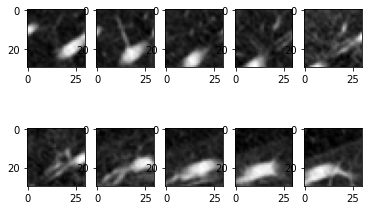

In [ ]:
# First of all we have to define a composition of transformations
aug = A.Compose([
                 # OneOf Select only one of transforms to apply from the defined list.
                 # Transforms probabilities will be normalized to one 1, so in this case transforms probabilities works as weights.
        A.OneOf([
                 # p is the transformation probability (in this case the weight)
                 A.VerticalFlip(p=0.1),
                 A.HorizontalFlip(p=0.1),               
                 A.Rotate(limit=(-180,180),p=0.8),
        ], p=1.0), # This probability is 1 so one of Vertical Flip, Horizontal Flip and Rotation will be always applied to the image
        A.Transpose(p=0.1),
        A.OneOf([
                 A.Blur(blur_limit=3, p=0.6),
                 A.OpticalDistortion(distort_limit=2, shift_limit=0.5, p=0.2),
                 A.ElasticTransform(p = 0.2, alpha=300, sigma=300 * 0.05, alpha_affine=200 * 0.03),
                 #A.GridDistortion(p = 1.0, num_steps = 20, distort_limit=(-0.3, 0.3))
        ], p=0.3),
    ], 
    # At each execution of the composition the combination of transformations will change.
    # To apply the same composition for the slices derived from a single voxel we need to define all the images that we want to augment with the same composition 
    # (in this case 10 as the number of slices in the ARCHI 2 model)
    additional_targets = {'image0': 'image', 'image1': 'image', 'image2': 'image', 'image3': 'image', 'image4': 'image', 'image5': 'image', 'image6': 'image', 'image7': 'image', 'image8': 'image', 'image9': 'image'})

# We exctract an exemple of voxel with the correct dimensions for archi 2
IDX_class_one = np.where(y==1)[0]
TPidx = random.randrange(len(IDX_class_one))
image =  np.expand_dims(h5file.root.images[IDX_class_one[TPidx],8:18,5:35,5:35],axis=0)  # extraction of the central sliceof the volumetric patch 26x48x48. 
image = normalize(image)
print("Original Voxel Dimensions: ", image.shape)

# Print of the original slices of the voxel
print("\n\nOriginal VOXEL")
for i in range(image.shape[1]):
  im_slice = image[:,i,:,:]
  im_slice = np.squeeze(im_slice)
  plt.subplot(2,5,i+1)
  plt.imshow(im_slice,cmap='gray')

Augmented VOXEL


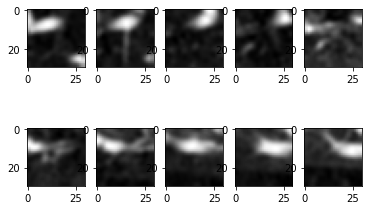

In [ ]:
print("Augmented VOXEL")
# All the slices extracted as a 2D image will be put in the vector slices
slices = []
for i in range(image.shape[1]):
  im_slice = image[:,i,:,:]
  slices.append(np.squeeze(im_slice))

# All the slices are augmented with the same random composition of transformation
augmented = aug(image=slices[0], image1=slices[1], image2=slices[2] ,image3=slices[3], image4=slices[4], image5=slices[5], image6=slices[6], image7=slices[7], image8=slices[8], image9=slices[9])
# slices_aug will be the vector with all the augmented slices
slices_aug = []
slices_aug.append(augmented['image'])
slices_aug.append(augmented['image1'])
slices_aug.append(augmented['image2'])
slices_aug.append(augmented['image3'])
slices_aug.append(augmented['image4'])
slices_aug.append(augmented['image5'])
slices_aug.append(augmented['image6'])
slices_aug.append(augmented['image7'])
slices_aug.append(augmented['image8'])
slices_aug.append(augmented['image9'])

# The augmented slices are printed
for i in range(image.shape[1]):
  plt.subplot(2,5,i+1)
  plt.imshow(slices_aug[i],cmap='gray') 

In [ ]:
# Rebuilding of the voxel by stacking the slices
aug_image = np.stack((slices_aug[0], slices_aug[1],slices_aug[2],slices_aug[3],slices_aug[4],slices_aug[5],slices_aug[6], slices_aug[7],slices_aug[8],slices_aug[9]), axis=0)
aug_image = np.expand_dims(aug_image, 0)
print("Augmented Voxel Dimensions: ", aug_image.shape)

Augmented Voxel Dimensions:  (1, 10, 30, 30)


## Archi models shapes

In [ ]:
#shape with which the original image is cropped for the 3 architectures (the first dimension is the number of slices (depth))
archi1_input_shape=(6,20,20,1)
archi2_input_shape=(10,30,30,1)
archi3_input_shape=(26,40,40,1)

print("Archi 1 Input Shape: ", archi1_input_shape)
print("Archi 2 Input Shape: ", archi2_input_shape)
print("Archi 3 Input Shape: ", archi3_input_shape)

Archi 1 Input Shape:  (6, 20, 20, 1)
Archi 2 Input Shape:  (10, 30, 30, 1)
Archi 3 Input Shape:  (26, 40, 40, 1)


## Loader Archi1

In [ ]:
if augment_what=="just_TP":
    def imageLoader_archi1(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,6,20,20)) #<------------------------------------------------------------------ARCHI 1 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border'''

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],10:16,10:30,10:30],axis=0) #<----------------------ARCHI 1 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]
                    if angle == 1:
                        img = np.flip(img_0,axis=3) # horizontal FLIP 
                    elif angle ==2:
                        img = np.flip(img_0,axis=2) # vertical FLIP 
                    elif angle >2 :
                        img = ndimage.rotate(img_0,angle,reshape=False,mode='constant',axes = (2,3))
                    elif angle == 0: # original image is considered
                        img = img_0
                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size

elif augment_what=="all":
    def imageLoader_archi1(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,6,20,20)) #<------------------------------------------------------------------ARCHI 1 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],10:16,10:30,10:30],axis=0) #<----------------------ARCHI 1 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]

                    
                    if angle >= 1:
                        # AUGMENTATION-------------------------------------------------------------------------------------------------------------------           
                        # The same procedure exaplained before is now applied
                        slices = []
                        for j in range(img_0.shape[1]):
                            im_slice = img_0[:,j,:,:]
                            slices.append(np.squeeze(im_slice))
                        
                        # Resetting the seed to be different each time
                        t = 1000 * time.time() # current time in milliseconds
                        np.random.seed(int(t) % 2**32)

                        aug = A.Compose([
                                        A.OneOf([
                                                A.VerticalFlip(p=0.1),
                                                A.HorizontalFlip(p=0.1),
                                                #A.RandomBrightnessContrast(p=0.2),                 
                                                A.Rotate(limit=(-180,180),p=0.8),
                                        ], p=1.0),
                                        A.Transpose(p=0.1),
                                        A.OneOf([
                                                A.Blur(blur_limit=3, p=0.3),
                                                #A.OpticalDistortion(distort_limit=2, shift_limit=0.5, p=0.25),
                                                #A.ElasticTransform(p = 1.0, alpha=300, sigma=300 * 0.05, alpha_affine=200 * 0.03),
                                                #A.GridDistortion(p = 1.0, num_steps = 15, distort_limit=(-0.3, 0.3))
                                        ], p=0.3),
                                    ], 
                                    additional_targets = {'image0': 'image', 'image1': 'image', 'image2': 'image', 'image3': 'image', 'image4': 'image', 'image5': 'image'})
                        
                        # The same composition is applied for all the slices
                        augmented = aug(image=slices[0], image1=slices[1], image2=slices[2] ,image3=slices[3], image4=slices[4], image5=slices[5])

                        slices_aug = []
                        slices_aug.append(augmented['image'])
                        slices_aug.append(augmented['image1'])
                        slices_aug.append(augmented['image2'])
                        slices_aug.append(augmented['image3'])
                        slices_aug.append(augmented['image4'])
                        slices_aug.append(augmented['image5'])


                        # Ricostruisco l'immagine
                        aug_image = np.stack((slices_aug[0], slices_aug[1], slices_aug[2], slices_aug[3], slices_aug[4], slices_aug[5]), axis=0)
                        img = np.expand_dims(aug_image, axis = 0)

                    else: # original image is considered
                        img = img_0

                    

                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size 

## Loader Archi 2

In [ ]:
if augment_what=="just_TP":
    def imageLoader_archi2(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,10,30,30)) #<------------------------------------------------------------------ARCHI 2 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border'''

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0) #<---------------------------ARCHI 2 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]
                    if angle == 1:
                        img = np.flip(img_0,axis=3) # horizontal FLIP 
                    elif angle ==2:
                        img = np.flip(img_0,axis=2) # vertical FLIP 
                    elif angle >2 :
                        img = ndimage.rotate(img_0,angle,reshape=False,mode='constant',axes = (2,3))
                    elif angle == 0: # original image is considered
                        img = img_0
                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size

elif augment_what=="all":
    def imageLoader_archi2(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,10,30,30)) #<------------------------------------------------------------------ARCHI 2 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border'''

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0) #<---------------------------ARCHI 2 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]


                    if angle >= 1:
                        # AUGMENTATION-------------------------------------------------------------------------------------------------------------------           
                        # The same procedure exaplained before is now applied
                        slices = []
                        for j in range(img_0.shape[1]):
                            im_slice = img_0[:,j,:,:]
                            slices.append(np.squeeze(im_slice))
                        
                        # Resetting the seed
                        t = 1000 * time.time() # current time in milliseconds
                        np.random.seed(int(t) % 2**32)

                        aug = A.Compose([
                                        A.OneOf([
                                                A.VerticalFlip(p=0.1),
                                                A.HorizontalFlip(p=0.1),
                                                #A.RandomBrightnessContrast(p=0.2),                 
                                                A.Rotate(limit=(-180,180),p=0.8),
                                        ], p=1.0),
                                        A.Transpose(p=0.1),
                                        A.OneOf([
                                                A.Blur(blur_limit=3, p=0.6),
                                                A.OpticalDistortion(distort_limit=2, shift_limit=0.5, p=0.2),
                                                A.ElasticTransform(p = 0.2, alpha=300, sigma=300 * 0.05, alpha_affine=200 * 0.03),
                                                #A.GridDistortion(p = 1.0, num_steps = 20, distort_limit=(-0.3, 0.3))
                                        ], p=0.3),
                                    ], 
                                    additional_targets = {'image0': 'image', 'image1': 'image', 'image2': 'image', 'image3': 'image', 'image4': 'image', 'image5': 'image', 'image6': 'image', 'image7': 'image', 'image8': 'image', 'image9': 'image'})
                        
                        # The same composition is applied for all the slices
                        augmented = aug(image=slices[0], image1=slices[1], image2=slices[2] ,image3=slices[3], image4=slices[4], image5=slices[5], image6=slices[6], image7=slices[7], image8=slices[8], image9=slices[9])

                        slices_aug = []
                        slices_aug.append(augmented['image'])
                        slices_aug.append(augmented['image1'])
                        slices_aug.append(augmented['image2'])
                        slices_aug.append(augmented['image3'])
                        slices_aug.append(augmented['image4'])
                        slices_aug.append(augmented['image5'])
                        slices_aug.append(augmented['image6'])
                        slices_aug.append(augmented['image7'])
                        slices_aug.append(augmented['image8'])
                        slices_aug.append(augmented['image9'])


                        # Ricostruisco l'immagine
                        aug_image = np.stack((slices_aug[0], slices_aug[1], slices_aug[2], slices_aug[3], slices_aug[4], slices_aug[5], slices_aug[6], slices_aug[7], slices_aug[8], slices_aug[9]), axis=0)
                        img = np.expand_dims(aug_image, axis = 0)

                    else: # original image is considered
                        img = img_0

                
                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size

## Loader Archi 3

In [ ]:
if augment_what=="just_TP":
    def imageLoader_archi3(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,26,40,40)) #<------------------------------------------------------------------ARCHI 3 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border'''

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],:,:,:],axis=0) #<----------------------------------ARCHI 3 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]
                    if angle == 1:
                        img = np.flip(img_0,axis=3) # horizontal FLIP 
                    elif angle ==2:
                        img = np.flip(img_0,axis=2) # vertical FLIP 
                    elif angle >2 :
                        img = ndimage.rotate(img_0,angle,reshape=False,mode='constant',axes = (2,3))
                    elif angle == 0: # original image is considered
                        img = img_0
                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size

elif augment_what=="all":
    def imageLoader_archi3(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                # we have to allocate in advance the space for the input batch
                tmpB = np.empty((limit-batch_start,26,40,40)) #<------------------------------------------------------------------ARCHI 3 SHAPE
                tmpB_Y = np.empty((limit-batch_start,2))
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    # Limitation: only the center is considered, what if nodule at border'''

                    img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],:,:,:],axis=0) #<----------------------------------ARCHI 3 CENTER
                    
                    # image processing
                    img_0 = normalize(img_0)
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1]



                    if angle >= 1:
                        # AUGMENTATION-------------------------------------------------------------------------------------------------------------------           
                        # The same procedure exaplained before is now applied
                        n_slices = img_0.shape[1]

                        # generation of the dictionary to pass at the augmentation function
                        targets_dict = {}
                        for k in range(n_slices):
                            targets_dict[str('image'+str(k))] = 'image'
                        
                        # Extraction of the slices to augment
                        slices = []
                        for j in range(n_slices):
                            im_slice = img_0[:,j,:,:]
                            slices.append(np.squeeze(im_slice))
                        
                        # Resetting the seed
                        t = 1000 * time.time() # current time in milliseconds
                        np.random.seed(int(t) % 2**32)

                        # Change Transformation each time
                        aug = A.Compose([
                                        A.OneOf([
                                                A.VerticalFlip(p=0.1),
                                                A.HorizontalFlip(p=0.1),
                                                #A.RandomBrightnessContrast(p=0.2),                 
                                                A.Rotate(limit=(-180,180),p=0.8),
                                        ], p=1.0),
                                        A.Transpose(p=0.4),
                                        A.Blur(blur_limit=4, p=0.2),
                                        A.OneOf([
                                                A.OpticalDistortion(p = 0.2, distort_limit=0.8, shift_limit=0.3),
                                                A.ElasticTransform(p = 0.25, alpha=50, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                                                A.GridDistortion(p = 0.25, num_steps = 5, distort_limit=(-0.3, 0.3)),
                                                A.Perspective (p = 0.2, scale=(0.05, 0.12)),
                                        ], p=0.5),
                                        ], 
                                        additional_targets = targets_dict)
                        
                        # The same composition is applied for all the slices
                        # The slices are passed as argument at the composition defined above "aug"
                        augmented = aug(image=slices[0], image1=slices[1], image2=slices[2] ,image3=slices[3], image4=slices[4], image5=slices[5], image6=slices[6], image7=slices[7], image8=slices[8], image9=slices[9],
                                        image10=slices[10], image11=slices[11], image12=slices[12] ,image13=slices[13], image14=slices[14], image15=slices[15], image16=slices[16], image17=slices[17], image18=slices[18], 
                                        image19=slices[19], image20=slices[20], image21=slices[21], image22=slices[22] ,image23=slices[23], image24=slices[24], image25=slices[25])
                         
                        slices_aug = []
                        slices_aug.append(augmented['image'])
                        slices_aug.append(augmented['image1'])
                        slices_aug.append(augmented['image2'])
                        slices_aug.append(augmented['image3'])
                        slices_aug.append(augmented['image4'])
                        slices_aug.append(augmented['image5'])
                        slices_aug.append(augmented['image6'])
                        slices_aug.append(augmented['image7'])
                        slices_aug.append(augmented['image8'])
                        slices_aug.append(augmented['image9'])
                        slices_aug.append(augmented['image10'])
                        slices_aug.append(augmented['image11'])
                        slices_aug.append(augmented['image12'])
                        slices_aug.append(augmented['image13'])
                        slices_aug.append(augmented['image14'])
                        slices_aug.append(augmented['image15'])
                        slices_aug.append(augmented['image16'])
                        slices_aug.append(augmented['image17'])
                        slices_aug.append(augmented['image18'])
                        slices_aug.append(augmented['image19'])
                        slices_aug.append(augmented['image20'])
                        slices_aug.append(augmented['image21'])
                        slices_aug.append(augmented['image22'])
                        slices_aug.append(augmented['image23'])
                        slices_aug.append(augmented['image24'])
                        slices_aug.append(augmented['image25'])

                        # Ricostruisco l'immagine
                        stack_tuple = ()
                        for z in range(n_slices):
                            stack_tuple = stack_tuple + (slices_aug[z],)

                        aug_image = np.stack(stack_tuple, axis=0)
                        img = np.expand_dims(aug_image, axis = 0)

                    else: # original image is considered
                        img = img_0

                
                    # fill the allocated vector with the tranformed image
                    tmpB[idx,:,:,:] =img

                    tmpB[idx,:,:,:] =img
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:]

                X = np.expand_dims(tmpB,axis=-1)

                #Y = target[idx_samples[batch_start:limit,0],:]
                Y = tmpB_Y           
                #print(np.shape(Y))
                #SINGLE INPUT- SINGLE OUTPUT
                yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
                
                batch_start += batch_size   
                batch_end += batch_size

## Loader Multimodal Network

In [ ]:
#the multimodal networks are fed all 3 input dimensions in parallel
if augment_what=="just_TP":
    def imageLoader_ensemble(files, idx_samples,target, batch_size):
        L = len(idx_samples)
        #random.shuffle(idx_samples)
        
        print(idx_samples.shape)
        idx_samples = K.print_tensor(idx_samples)
        np.random.shuffle(idx_samples)
        
        while True:
            batch_start = 0
            batch_end = batch_size

            while batch_end <= L:
                limit = min(batch_end, L)

                tmpB_AR1 = np.empty((limit-batch_start,6,20,20))
                tmpB_AR2 = np.empty((limit-batch_start,10,30,30))
                tmpB_AR3 = np.empty((limit-batch_start,26,40,40))
                tmpB_Y = np.empty((limit-batch_start,2)) #new
                
                idx =-1
                for i in range(batch_start,limit):
                    idx=idx+1
                    # Ranges has to be updated according to the input size we are dealing with
                    
                    img_A1 =  np.expand_dims(files.root.images[idx_samples[i,0],10:16,10:30,10:30],axis=0) #i,0 #9:15,14:34,14:34
                    img_A2 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0) #7:17,9:39,9:39
                    img_A3 =  np.expand_dims(files.root.images[idx_samples[i,0],:,:,:],axis=0) #:,4:44,4:44

                    # image processing
                    img_A1 = normalize(img_A1)
                    img_A2 = normalize(img_A2)
                    img_A3 = normalize(img_A3)
                    
                    # from the value in the second column verify which transformation apply 
                    angle = idx_samples[i,1] #i
                    if angle == 1:
                        img_A1 = np.flip(img_A1,axis=3) # horizontal FLIP 
                        img_A2 = np.flip(img_A2,axis=3) # horizontal FLIP
                        img_A3 = np.flip(img_A3,axis=3) # horizontal FLIP
                    elif angle ==2:
                        img_A1 = np.flip(img_A1,axis=2) # vertical FLIP 
                        img_A2 = np.flip(img_A2,axis=2) # vertical FLIP 
                        img_A3 = np.flip(img_A3,axis=2) # vertical FLIP 
                    elif angle >2 :
                        img_A1 = ndimage.rotate(img_A1,angle,reshape=False,mode='constant',axes = (2,3))
                        img_A2 = ndimage.rotate(img_A2,angle,reshape=False,mode='constant',axes = (2,3))
                        img_A3 = ndimage.rotate(img_A3,angle,reshape=False,mode='constant',axes = (2,3))
                    elif angle == 0: # original image is considered
                        img_A1 = img_A1
                        img_A2 = img_A2
                        img_A3 = img_A3


                    # fill the allocated vector with the tranformed image
                    tmpB_AR1[idx,:,:,:] =img_A1
                    tmpB_AR2[idx,:,:,:] =img_A2
                    tmpB_AR3[idx,:,:,:] =img_A3
                    tmpB_Y[idx,:] = target[idx_samples[i,0],:] #new


                X_AR1 = np.expand_dims(tmpB_AR1,axis=-1)
                X_AR2 = np.expand_dims(tmpB_AR2,axis=-1)
                X_AR3 = np.expand_dims(tmpB_AR3,axis=-1)
                #Y = target[idx_samples[batch_start:limit],0] # ,0 in ]
                Y = tmpB_Y 

                yield ([X_AR1,X_AR2,X_AR3] ,Y)    

                batch_start += batch_size   
                batch_end += batch_size            

elif augment_what=="all":
    print("augment both TP and FP")
    def imageLoader_ensemble(files, idx_samples,target, batch_size):
      L = len(idx_samples)
      #random.shuffle(idx_samples)
      
      print(idx_samples.shape)
      idx_samples = K.print_tensor(idx_samples)
      np.random.shuffle(idx_samples)
      
      while True:
          batch_start = 0
          batch_end = batch_size

          while batch_end <= L:
              limit = min(batch_end, L)

              # we have to allocate in advance the space for the input batch
              tmpB_AR1 = np.empty((limit-batch_start,6,20,20))  #<------------------------------------------------------------------ARCHI 1 SHAPE
              tmpB_AR2 = np.empty((limit-batch_start,10,30,30)) #<------------------------------------------------------------------ARCHI 2 SHAPE
              tmpB_AR3 = np.empty((limit-batch_start,26,40,40)) #<------------------------------------------------------------------ARCHI 3 SHAPE
              tmpB_Y = np.empty((limit-batch_start,2))
              
              idx =-1
              for i in range(batch_start,limit):
                  idx=idx+1
                  # Ranges has to be updated according to the input size we are dealing with
                  # Limitation: only the center is considered, what if nodule at border'''

                  img_A1 =  np.expand_dims(files.root.images[idx_samples[i,0],10:16,10:30,10:30],axis=0)  #<----------------------------------ARCHI 3 CENTER
                  img_A2 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0)  #<----------------------------------ARCHI 3 CENTER
                  img_A3 =  np.expand_dims(files.root.images[idx_samples[i,0],:,:,:],axis=0) #<----------------------------------ARCHI 3 CENTER
                  
                  # image processing
                  img_A1 = normalize(img_A1)
                  img_A2 = normalize(img_A2)
                  img_A3 = normalize(img_A3)
                  # from the value in the second column verify which transformation apply 
                  angle = idx_samples[i,1]



                  if angle >= 1:
                      # AUGMENTATION!!-------------------------------------------------------------------------------------------------------------------           
                      
                      # Extract the number of slices
                      n_slices1 = img_A1.shape[1]
                      n_slices2 = img_A2.shape[1]
                      n_slices3 = img_A3.shape[1]

                      # generation of the dictionary to pass at the augmentation function
                      targets_dict = {}
                      
                      for k in range(n_slices1+n_slices2+n_slices3):  
                        targets_dict[str('image'+str(k))] = 'image'
                  
                      # Extraction of the slices to augment
                      slices1 = [] #<----------------------------------------Archi 1
                      for j1 in range(n_slices1):
                        im_slice1 = img_A1[:,j1,:,:]
                        slices1.append(np.squeeze(im_slice1))
                      
                      # Extraction of the slices to augment
                      slices2 = [] #<----------------------------------------Archi 2
                      for j2 in range(n_slices2):
                        im_slice2 = img_A2[:,j2,:,:]
                        slices2.append(np.squeeze(im_slice2))
                      
                      # Extraction of the slices to augment
                      slices3 = [] #<----------------------------------------Archi 3
                      for j3 in range(n_slices3):
                        im_slice3 = img_A3[:,j3,:,:]
                        slices3.append(np.squeeze(im_slice3))
                      
                      # Resetting the seed
                      t = 1000 * time.time() # current time in milliseconds
                      np.random.seed(int(t) % 2**32)

                      # Change Transformation each time
                      aug = A.Compose([
                                      A.OneOf([
                                              A.VerticalFlip(p=0.1),
                                              A.HorizontalFlip(p=0.1),
                                              #A.RandomBrightnessContrast(p=0.2),                 
                                              A.Rotate(limit=(-180,180),p=0.8),
                                      ], p=1.0),
                                      A.Transpose(p=0.4),
                                      A.Blur(blur_limit=4, p=0.2),
                                      A.OneOf([
                                              A.OpticalDistortion(p = 0.2, distort_limit=0.8, shift_limit=0.3),
                                              A.ElasticTransform(p = 0.25, alpha=50, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                                              A.GridDistortion(p = 0.25, num_steps = 5, distort_limit=(-0.3, 0.3)),
                                              A.Perspective (p = 0.2, scale=(0.05, 0.12)),
                                      ], p=0.5),
                                      ], 
                                      additional_targets = targets_dict)
                      
                      # Same transformation must be applied to all slices---------------------------------------------------------------------------------------------------
                      augmented = aug(image=slices1[0], image1=slices1[1], image2=slices1[2] ,image3=slices1[3], image4=slices1[4], image5=slices1[5], 
                                      image6=slices2[0], image7=slices2[1], image8=slices2[2] ,image9=slices2[3], image10=slices2[4], image11=slices2[5], image12=slices2[6], image13=slices2[7], image14=slices2[8], image15=slices2[9],
                                      image16=slices3[0], image17=slices3[1], image18=slices3[2] ,image19=slices3[3], image20=slices3[4], image21=slices3[5], image22=slices3[6], image23=slices3[7], image24=slices3[8], image25=slices3[9],
                                      image26=slices3[10], image27=slices3[11], image28=slices3[12] ,image29=slices3[13], image30=slices3[14], image31=slices3[15], image32=slices3[16], image33=slices3[17], image34=slices3[18], 
                                      image35=slices3[19], image36=slices3[20], image37=slices3[21], image38=slices3[22] ,image39=slices3[23], image40=slices3[24], image41=slices3[25])
                      
                      slices_aug1 = []
                      slices_aug2 = []
                      slices_aug3 = []
                      slices_aug1.append(augmented['image'])
                      slices_aug1.append(augmented['image1'])
                      slices_aug1.append(augmented['image2'])
                      slices_aug1.append(augmented['image3'])
                      slices_aug1.append(augmented['image4'])
                      slices_aug1.append(augmented['image5'])
                      slices_aug2.append(augmented['image6'])
                      slices_aug2.append(augmented['image7'])
                      slices_aug2.append(augmented['image8'])
                      slices_aug2.append(augmented['image9'])
                      slices_aug2.append(augmented['image10'])
                      slices_aug2.append(augmented['image11'])
                      slices_aug2.append(augmented['image12'])
                      slices_aug2.append(augmented['image13'])
                      slices_aug2.append(augmented['image14'])
                      slices_aug2.append(augmented['image15'])
                      slices_aug3.append(augmented['image16'])
                      slices_aug3.append(augmented['image17'])
                      slices_aug3.append(augmented['image18'])
                      slices_aug3.append(augmented['image19'])
                      slices_aug3.append(augmented['image20'])
                      slices_aug3.append(augmented['image21'])
                      slices_aug3.append(augmented['image22'])
                      slices_aug3.append(augmented['image23'])
                      slices_aug3.append(augmented['image24'])
                      slices_aug3.append(augmented['image25'])
                      slices_aug3.append(augmented['image26'])
                      slices_aug3.append(augmented['image27'])
                      slices_aug3.append(augmented['image28'])
                      slices_aug3.append(augmented['image29'])
                      slices_aug3.append(augmented['image30'])
                      slices_aug3.append(augmented['image31'])
                      slices_aug3.append(augmented['image32'])
                      slices_aug3.append(augmented['image33'])
                      slices_aug3.append(augmented['image34'])
                      slices_aug3.append(augmented['image35'])
                      slices_aug3.append(augmented['image36'])
                      slices_aug3.append(augmented['image37'])
                      slices_aug3.append(augmented['image38'])
                      slices_aug3.append(augmented['image39'])
                      slices_aug3.append(augmented['image40'])
                      slices_aug3.append(augmented['image41'])

                      # Rebuild the image from its unpacked slices
                      stack_tuple1 = () #<--------------------------------Archi1
                      for z1 in range(n_slices1):
                        stack_tuple1 = stack_tuple1 + (slices_aug1[z1],)

                      aug_image1 = np.stack(stack_tuple1, axis=0)
                      img_A1 = np.expand_dims(aug_image1, axis = 0)

                      stack_tuple2 = () #<--------------------------------Archi2
                      for z2 in range(n_slices2):
                        stack_tuple2 = stack_tuple2 + (slices_aug2[z2],)

                      aug_image2 = np.stack(stack_tuple2, axis=0)
                      img_A2 = np.expand_dims(aug_image2, axis = 0)

                      stack_tuple3 = () #<--------------------------------Archi3
                      for z3 in range(n_slices3):
                        stack_tuple3 = stack_tuple3 + (slices_aug3[z3],)

                      aug_image3 = np.stack(stack_tuple3, axis=0)
                      img_A3 = np.expand_dims(aug_image3, axis = 0)

                  else: # original image is considered
                      img_A1 = img_A1
                      img_A2 = img_A2
                      img_A3 = img_A3

              

                  # fill the allocated vector with the tranformed image
                  tmpB_AR1[idx,:,:,:] =img_A1
                  tmpB_AR2[idx,:,:,:] =img_A2
                  tmpB_AR3[idx,:,:,:] =img_A3
                  tmpB_Y[idx,:] = target[idx_samples[i,0],:]


              X_AR1 = np.expand_dims(tmpB_AR1,axis=-1)
              X_AR2 = np.expand_dims(tmpB_AR2,axis=-1)
              X_AR3 = np.expand_dims(tmpB_AR3,axis=-1)
              
              Y = tmpB_Y 

              yield ([X_AR1,X_AR2,X_AR3] ,Y)   
              
              batch_start += batch_size   
              batch_end += batch_size


augment both TP and FP


# **Dataset generation**

## Train Dataset

In [ ]:
# Extraction of the indexes
idx_trainNEWRE = np.empty((np.shape(idx_train)[0],),dtype=int)
for i in range(len(idx_train)):
    idx_trainNEWRE[i] = int(idx_train[i])

# Indexes of FP samples
idx_train_FP = idx_trainNEWRE[np.where(y[idx_trainNEWRE,0]==0)[0]]
# Indexes of TP samples
idx_train_TP = idx_trainNEWRE[np.where(y[idx_trainNEWRE,0]==1)[0]]

## Data augmentation

In [ ]:
#for TP samples
# concatenate the indexes of the training samples for a number of times equal to Naugment_TP
idx_train_TP_augmented=idx_train_TP
count = Naugment_TP
while count > 0 :
  count = count - 1
  idx_train_TP_augmented =np.concatenate((idx_train_TP_augmented,idx_train_TP),axis=0)
print(idx_train_TP_augmented.shape)

(15637,)


In [ ]:
#for FP samples
# concatenate the indexes of the training samples for a number of times equal to Naugment_FP
idx_train_FP_augmented=idx_train_FP
count = Naugment_FP
while count > 0 :
  count = count - 1
  idx_train_FP_augmented =np.concatenate((idx_train_FP_augmented,idx_train_FP),axis=0)
print(idx_train_FP_augmented.shape)

In [ ]:
# I encoed the possible transformations as follows
# - 0 : original image
# - 1 : horizontal flip 
# - 2 : vertical flip
# - >2 : rotation of xx degree
angles_list = [0,1,2,30,90,150,180,210,270,330] 
#angles_list = [90,180,270] 
print(len(angles_list))

# Create the vectors describing the tranformation to apply to each sample
# To samples of the majority class we associate a vector of zeros since no resampling (and so no transformation) is applied in the case of standard augmentation

if augment_what=="just_TP":
    angles_FP = np.zeros((len(idx_train_FP)))
elif augment_what=="all": #in this case apply the same procedure to the FP class as for the TP class
    angles_FP = np.random.choice(angles_list,idx_train_FP_augmented.shape) 
print(angles_FP.shape)
# To samples of the minority class we associate a vector of random values taken from the "angles_list" in the case of standard augmentation
angles_TP =np.random.choice(angles_list,idx_train_TP_augmented.shape)
angles_TP.shape

#in the case of advanced augmentation, any indication of angle different from 0 is interpreted as indication to transform the input and this is done in a 
#random way to each input image according to the indicated probabilities that regulate how each transform within the "one of" block is extracted and how each block is combined with others

In [ ]:
# Merge indexes and tranformation vectors of the two classes
idx_trainNEWRE = np.concatenate((idx_train_FP_augmented,idx_train_TP_augmented),axis=0)
angles_array = np.concatenate((angles_FP,angles_TP),axis=0)
# concatenate vector of indexes and of transformation
idx_angles_training = np.asarray(np.concatenate((np.expand_dims(idx_trainNEWRE,axis=1),np.expand_dims(angles_array,axis=1)),axis=1),dtype=int)
print(idx_angles_training.shape)

Inspect training and validation sets: class distribution

In [ ]:
train_zero = len(np.where(y[idx_angles_training[:,0],0]==0)[0])
train_one = len(np.where(y[idx_angles_training[:,0],0]==1)[0])
print('N = {} samples labelled as 0 in training set'.format(train_zero))
print('N = {} samples labelled as 1 in training set'.format(train_one))

validation_zero = len(np.where(y[idx_val,0]==0)[0])
validation_one = len(np.where(y[idx_val,0]==1)[0])
print('N = {} samples labelled as 0 in validation set'.format(validation_zero))
print('N = {} samples labelled as 1 in validation set'.format(validation_one))

In [ ]:
'''do not perform for weighed loss without data augmentation'''
# steps per epoch depend on the batch size
steps = len(idx_trainNEWRE)//batch_size
print(steps)


### Validation set

Generation of validation images fo each architecture

In [ ]:
val_images_AR1 =  np.expand_dims(h5file.root.images[list(idx_val),10:16,10:30,10:30],axis=-1) 
val_images_AR1 = normalize(val_images_AR1)       
print(np.shape(val_images_AR1))
val_images_AR2 =  np.expand_dims(h5file.root.images[list(idx_val),8:18,5:35,5:35],axis=-1) 
val_images_AR2 = normalize(val_images_AR2)       
print(np.shape(val_images_AR2))
val_images_AR3 =  np.expand_dims(h5file.root.images[list(idx_val),:,:,:],axis=-1) 
val_images_AR3 = normalize(val_images_AR3)       
print(np.shape(val_images_AR3))

val_labels = y[list(idx_val)] 
print(np.shape(val_labels))

/usr/local/lib/python3.7/dist-packages/tables/leaf.py:548: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  key = numpy.array(key)


(1488, 6, 20, 20, 1)
(1488, 10, 30, 30, 1)
(1488, 26, 40, 40, 1)
(1488, 2)


Generation of validation images for the ensemble models

In [ ]:
valens_images_AR1 =  np.expand_dims(h5file.root.images[list(idx_valens),10:16,10:30,10:30],axis=-1) 
valens_images_AR1 = normalize(valens_images_AR1)       
print(np.shape(valens_images_AR1))
valens_images_AR2 =  np.expand_dims(h5file.root.images[list(idx_valens),8:18,5:35,5:35],axis=-1) 
valens_images_AR2 = normalize(valens_images_AR2)       
print(np.shape(valens_images_AR2))
valens_images_AR3 =  np.expand_dims(h5file.root.images[list(idx_valens),:,:,:],axis=-1) 
valens_images_AR3 = normalize(valens_images_AR3)       
print(np.shape(valens_images_AR3))

valens_labels = y[list(idx_valens)] 
print(np.shape(valens_labels))

/usr/local/lib/python3.7/dist-packages/tables/leaf.py:548: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  key = numpy.array(key)


(523, 6, 20, 20, 1)
(523, 10, 30, 30, 1)
(523, 26, 40, 40, 1)
(523, 2)


# **Model Compilation**

## Checkpoints

In [ ]:
from datetime import datetime

def create_folders_and_callbacks(model_name):

  if not os.path.exists(exps_dir):
      os.makedirs(exps_dir)

  now = datetime.now().strftime('%b%d_%H-%M-%S')

  exp_dir = os.path.join(exps_dir, model_name + '_' + str(now))
  if not os.path.exists(exp_dir):
      os.makedirs(exp_dir)
      
  callbacks = []

  # Model checkpoint
  # ----------------
  ckpt_dir = os.path.join(exp_dir, 'ckpts')
  if not os.path.exists(ckpt_dir):
      os.makedirs(ckpt_dir)

  ckpt_callback = tf.keras.callbacks.ModelCheckpoint(filepath=os.path.join(ckpt_dir, 'cp.ckpt'), 
                                                     save_weights_only=False, # True to save only weights
                                                     save_best_only=True) # True to save only the best epoch 
  callbacks.append(ckpt_callback)


  # Early Stopping
  # --------------
  es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_f1score', mode='max', patience=15, restore_best_weights=True) #to limit the networks freedom (freedom to overfit) by interrupting training if for patience epochs the validation f1 score does not increase
  callbacks.append(es_callback)

  # Reduce Learning Rate
  # --------------
  lr_callback = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_f1score', patience=5, factor=0.5, min_lr=1e-5) #helps stabilizing the loss
  callbacks.append(lr_callback)

  return (callbacks, exp_dir)

## Models Compilation

In [ ]:
model_archi1_article = build_archi1(archi1_input_shape)
model_archi2_article = build_archi2_gmp(archi2_input_shape)
model_archi3_article = build_archi3_gmp(archi3_input_shape)
model_archi1_res = ResNet50_3D_Fast(archi1_input_shape) 
#actually this experimental approach (3D ResNet) was only attempted on archi1 and then dropped having obtained worse results than for the simpler architectures due to overfitting
#model_archi2_res = ResNet50_3D_Fast(archi2_input_shape)
#model_archi3_res = ResNet50_3D_Fast(archi3_input_shape)

## Model summary and printing

In [ ]:
if selected_model == "Archi1":
  model_archi1_article.summary()
elif selected_model == "Archi2":
  model_archi2_article.summary()
elif selected_model == "Archi3":
  model_archi3_article.summary()
elif selected_model == "Archi1_ResNet":
  model_archi1_res.summary()  
elif selected_model == "Archi2_ResNet":
  model_archi2_res.summary()
elif selected_model == "Archi3_ResNet":
  model_archi3_res.summary()

Model: "archi3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 26, 40, 40, 1)]   0         
                                                                 
 conv3d_15 (Conv3D)          (None, 26, 40, 40, 32)    2432      
                                                                 
 max_pooling3d_5 (MaxPooling  (None, 13, 20, 20, 32)   0         
 3D)                                                             
                                                                 
 dropout_17 (Dropout)        (None, 13, 20, 20, 32)    0         
                                                                 
 conv3d_16 (Conv3D)          (None, 13, 20, 20, 32)    76832     
                                                                 
 conv3d_17 (Conv3D)          (None, 13, 20, 20, 32)    76832     
                                                            

In [ ]:
if selected_model == "Archi1":
  plot_model(model_archi1_article,show_shapes=True, show_layer_names=True)
elif selected_model == "Archi2":
  plot_model(model_archi2_article,show_shapes=True, show_layer_names=True)
elif selected_model == "Archi3":
  plot_model(model_archi3_article,show_shapes=True, show_layer_names=True)
elif selected_model == "Archi1_ResNet":  
  plot_model(model_archi3_res,show_shapes=True, show_layer_names=True)  
elif selected_model == "Archi2_ResNet":  
  plot_model(model_archi3_res,show_shapes=True, show_layer_names=True) 
elif selected_model == "Archi3_ResNet":  
  plot_model(model_archi3_res,show_shapes=True, show_layer_names=True) 

## Calling the Train Generator

In [ ]:
if (selected_model == "Archi1") or (selected_model == "Archi1_ResNet"):
  training_generator = imageLoader_archi1(h5file, idx_angles_training, y, batch_size)
elif selected_model == "Archi2" or (selected_model == "Archi2_ResNet"):
  training_generator = imageLoader_archi2(h5file, idx_angles_training, y, batch_size)
elif selected_model == "Archi3" or (selected_model == "Archi3_ResNet"):
  training_generator = imageLoader_archi3(h5file, idx_angles_training, y, batch_size)

# Plotting Functions

In [ ]:
def resume_plot(model_history, results_directory, model_name, start_epoch = 0):
    # Accuracy, loss, dice 
    tacc=model_history.history['acc']
    tloss=model_history.history['loss']
    tf1=model_history.history['f1score']

    #tiou=model_history.history['iou']

    vacc=model_history.history['val_acc']
    vloss=model_history.history['val_loss']
    vf1=model_history.history['val_f1score']

    #viou=model_history.history['val_iou']

    #lrate=model_history.history['lr']

    # Number of epochs
    Epoch_count=len(tacc) + start_epoch
    Epochs=[]
    for i in range (start_epoch ,Epoch_count):
        Epochs.append(i+1)   

    index_loss=np.argmin(vloss)#  this is the epoch with the lowest validation loss
    val_lowest=vloss[index_loss]

    index_acc=np.argmax(vacc)
    acc_highest=vacc[index_acc]

    index_f1=np.argmax(vf1)
    f1_highest=vf1[index_f1]

    #index_iou=np.argmax(viou)
    #iou_highest=viou[index_iou]

    plt.style.use('seaborn-darkgrid')
    sc_label='best epoch= '+ str(index_loss + 1 + start_epoch)
    vc_label='best epoch= '+ str(index_acc + 1 + start_epoch)
    f1_label='best epoch= '+ str(index_f1 + 1 + start_epoch)
    #iou_label='best epoch= '+ str(index_iou + 1 + start_epoch)

    fig,axes=plt.subplots(nrows=1, ncols=3, figsize=(28,8))
    # Set the graph titles
    st = fig.suptitle(model_name, fontsize="x-large", fontweight="bold")
    axes[0].plot(Epochs, tloss, linewidth=2, marker='o', markersize = 5, label='Training loss')
    axes[0].plot(Epochs, vloss, linewidth=2, marker='o', markersize = 5,  label='Validation loss' )
    axes[0].scatter(index_loss+1 +start_epoch,val_lowest, s=50, c= 'blue', label=sc_label, zorder = 10)
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epochs')
    axes[0].set_ylabel('Loss')
    axes[0].legend()

    axes[1].plot (Epochs, tacc, linewidth=2, marker='o', markersize = 5, label= 'Training Accuracy')
    axes[1].plot (Epochs, vacc, linewidth=2, marker='o', markersize = 5, label= 'Validation Accuracy')
    axes[1].scatter(index_acc+1 +start_epoch,acc_highest, s=50, c= 'blue', label=vc_label, zorder = 10)
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epochs')
    axes[1].set_ylabel('Accuracy')
    axes[1].legend()
    
    axes[2].plot (Epochs, tf1, linewidth=2, marker='o', markersize = 5, label= 'Training F1 Score')
    axes[2].plot (Epochs, vf1, linewidth=2, marker='o', markersize = 5, label= 'Validation F1 Score')
    axes[2].scatter(index_f1 +1 +start_epoch, f1_highest, s=50, c= 'blue', label=f1_label, zorder = 10)
    axes[2].set_title('Training and Validation F1 Score')
    axes[2].set_xlabel('Epochs')
    axes[2].set_ylabel('F1 Score')
    axes[2].legend()

    #axes[3].plot (Epochs, tiou, linewidth=2, marker='o', markersize = 5, label= 'Training IOU')
    #axes[3].plot (Epochs, viou, linewidth=2, marker='o', markersize = 5, label= 'Validation IOU')
    #axes[3].scatter(index_iou +1 +start_epoch, iou_highest, s=50, c= 'blue', label=iou_label, zorder = 10)
    #axes[3].set_title('Training and Validation IOU')
    #axes[3].set_xlabel('Epochs')
    #xes[3].set_ylabel('IOU')
    #axes[3].legend()

    #axes[4].plot (Epochs, lrate, linewidth=2, marker='o', markersize = 5, label= 'Learning Rate')
    #axes[4].set_title('Learning Rate Curve')
    #axes[4].set_xlabel('Epochs')
    #axes[4].set_ylabel('Learning Rate')
    #axes[4].legend()

    plt.tight_layout
    fig.savefig(''.join([results_directory, '/ResumePlots.png']))
    #plt.style.use('fivethirtyeight')
    plt.show()
    plt.close()

### Animated Plot

In [ ]:
import matplotlib.pyplot as plt
from matplotlib import animation

from matplotlib import rc
rc('animation', html='jshtml')

def animated_plot(model_history, start_epoch = 0, repeat_animation = True):
  tacc=model_history.history['acc']
  tloss=model_history.history['loss']
  tf1=model_history.history['f1score']

    #tiou=model_history.history['iou']

  vacc=model_history.history['val_acc']
  vloss=model_history.history['val_loss']
  vf1=model_history.history['val_f1score']

  # Number of epochs
  Epoch_count=len(tacc) + start_epoch
  epochs = range(Epoch_count)  
  epochs = [x+1 for x in epochs]

  index_loss=np.argmin(vloss)#  this is the epoch with the lowest validation loss
  loss_lowest=vloss[index_loss]

  index_acc=np.argmax(vacc)
  acc_highest=vacc[index_acc]

  index_f1=np.argmax(vf1)
  f1_highest=vf1[index_f1]

  #index_iou=np.argmax(viou)
  #iou_highest=viou[index_iou]

  plt.style.use('seaborn-darkgrid')
  sc_label='Best epoch: '+ str(index_loss + 1 + start_epoch) + " \n Val. Loss = " + str(round(loss_lowest,4))
  vc_label='Best epoch: '+ str(index_acc + 1 + start_epoch)+ " \nVal. Acc. = " + str(round(acc_highest,4))
  f1_label='Best epoch: '+ str(index_f1 + 1 + start_epoch)+ " \nVal. F1 = " + str(round(f1_highest,4))
  #iou_label='best epoch= '+ str(index_iou + 1 + start_epoch)




  
  fig,axes=plt.subplots(nrows=1, ncols=3, figsize=(20,6))
  plt.tight_layout(pad=2, w_pad=2, h_pad=2.0)
  #st = fig.suptitle("Test", fontsize="x-large", fontweight="bold")
  plt.close()
  def animate(i):
     
      
      # LOSS-------------------------------------------------------------------------------------------------------------------
      axes[0].cla() # clear the previous image
      axes[0].plot(epochs[:i], tloss[:i], linewidth=2, marker='o', markersize = 5, label= 'Training Loss') # plot the line
      axes[0].plot(epochs[:i], vloss[:i], linewidth=2, marker='o', markersize = 5, label= 'Validation Loss') # plot the line

      loss_lowest_vect = np.ones(Epoch_count)*loss_lowest
      if i > index_loss+start_epoch+1:
        axes[0].scatter(epochs[index_loss+start_epoch:index_loss+start_epoch+1], loss_lowest_vect[index_loss+start_epoch:index_loss+start_epoch+1],s=50, c= 'blue', label=sc_label, zorder = 10)

      
      axes[0].set_xlim([start_epoch, epochs[-1]+1]) # fix the x axis
      axes[0].set_ylim([0.99*min([min(tloss), min(vloss)]), 1.01*max([max(tloss), max(vloss)])]) # fix the y axis    axes[1].set_title('Training and Validation Accuracy')
      axes[0].set_title('Training and Validation Loss')
      axes[0].set_xlabel('Epochs')
      axes[0].set_ylabel('Loss')
      axes[0].legend()

      # ACCURACY---------------------------------------------------------------------------------------------------------------
      axes[1].cla() # clear the previous image
      axes[1].plot(epochs[:i], tacc[:i], linewidth=2, marker='o', markersize = 5, label= 'Training Accuracy') # plot the line
      axes[1].plot(epochs[:i], vacc[:i], linewidth=2, marker='o', markersize = 5, label= 'Validation Accuracy') # plot the line
      
      acc_highest_vect = np.ones(Epoch_count)*acc_highest    
      if i > index_acc+start_epoch+1:
        axes[1].scatter(epochs[index_acc+start_epoch:index_acc+start_epoch+1], acc_highest_vect[index_acc+start_epoch:index_acc+start_epoch+1],s=50, c= 'blue', label=vc_label, zorder = 10)
     
      axes[1].set_xlim([start_epoch, epochs[-1]+1]) # fix the x axis
      axes[1].set_ylim([0.99*min([min(tacc), min(vacc)]), 1.01*max([max(tacc), max(vacc)])]) # fix the y axis    axes[1].set_title('Training and Validation Accuracy')
      axes[1].set_title('Training and Validation Accuracy')
      axes[1].set_xlabel('Epochs')
      axes[1].set_ylabel('Accuracy')
      axes[1].legend()

      # F1------------------------------------------------------------------------------------------------------------------------
      axes[2].cla() # clear the previous image
      axes[2].plot(epochs[:i], tf1[:i], linewidth=2, marker='o', markersize = 5, label= 'Training Loss') # plot the line
      axes[2].plot(epochs[:i], vf1[:i], linewidth=2, marker='o', markersize = 5, label= 'Validation Loss') # plot the line

      f1_highest_vect = np.ones(Epoch_count)*f1_highest    
      if i > index_f1+start_epoch+1:
        axes[2].scatter(epochs[index_f1+start_epoch:index_f1+start_epoch+1], f1_highest_vect[index_f1+start_epoch:index_f1+start_epoch+1],s=50, c= 'blue', label=f1_label, zorder = 10)
     
  

      axes[2].set_xlim([start_epoch, epochs[-1]+1]) # fix the x axis
      axes[2].set_ylim([0.99*min([min(tf1), min(vf1)]), 1.01*max([max(tf1), max(vf1)])]) # fix the y axis    axes[1].set_title('Training and Validation Accuracy')
      axes[2].set_title('Training and Validation F1 Score')
      axes[2].set_xlabel('Epochs')
      axes[2].set_ylabel('F1 Score')
      axes[2].legend()

      
  anim = animation.FuncAnimation(fig, animate, frames = len(epochs) + 1, interval = 100, blit = False, repeat = repeat_animation)
  return(anim)


# **Model training**
(repeated just to have all outputs saved for the trials indicated to be present in this notebook)
Actually only one of these cells is required to train any selected model with any kind of augmentation

## BEST version of each ARCHI

Model Selected: ARCHI 1
Start Training...
____________________________________________________________________________________________________________________________________
(8442, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,    2],
       [7129,    1],
       [7148,    0]])
Epoch 1/300
84/84 [==============================] - 45s 417ms/step - loss: 0.5916 - acc: 0.6544 - f1score: 0.4862 - precision: 0.6127 - recall: 0.4790 - val_loss: 0.2240 - val_acc: 0.9388 - val_f1score: 0.6846 - val_precision: 0.7160 - val_recall: 0.7111 - lr: 0.0010
Epoch 2/300
84/84 [==============================] - 25s 294ms/step - loss: 0.4247 - acc: 0.8117 - f1score: 0.8016 - precision: 0.8188 - recall: 0.7997 - val_loss: 0.1652 - val_acc: 0.9543 - val_f1score: 0.7398 - val_precision: 0.8082 - val_recall: 0.7223 - lr: 0.0010
Epoch 3/300
84/84 [==============================] - 25s 295ms/step - loss: 0.3401 - acc: 0.8600 - f1score: 0.8520 - precision: 0.8730 - 

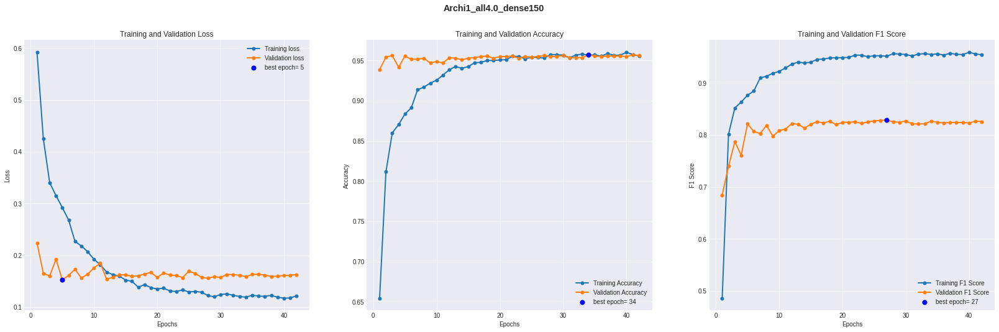

In [ ]:
#best ARCHI1: advanced augmentation (all) 4.0: improvemente with respect to the standard (simpler augmentation) given not by the quantity but by the quality 
#Greater variability was shown to the network during training allowing it to learn more and also making it more difficult to overfit
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet model
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

Model Selected: ARCHI 2
Start Training...
____________________________________________________________________________________________________________________________________
(8442, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,    2],
       [7129,    1],
       [7148,    0]])
Epoch 1/100
84/84 [==============================] - 57s 555ms/step - loss: 0.6517 - acc: 0.6056 - recall: 0.4998 - precision: 0.6290 - f1score: 0.5143 - val_loss: 0.4765 - val_acc: 0.7372 - val_recall: 0.9241 - val_precision: 0.3401 - val_f1score: 0.4645 - lr: 0.0010
Epoch 2/100
84/84 [==============================] - 39s 467ms/step - loss: 0.5332 - acc: 0.7327 - recall: 0.7842 - precision: 0.7145 - f1score: 0.7373 - val_loss: 0.2994 - val_acc: 0.8851 - val_recall: 0.8616 - val_precision: 0.6022 - val_f1score: 0.6618 - lr: 0.0010
Epoch 3/100
84/84 [==============================] - 39s 467ms/step - loss: 0.4279 - acc: 0.7995 - recall: 0.8115 - precision: 0.7969 - f

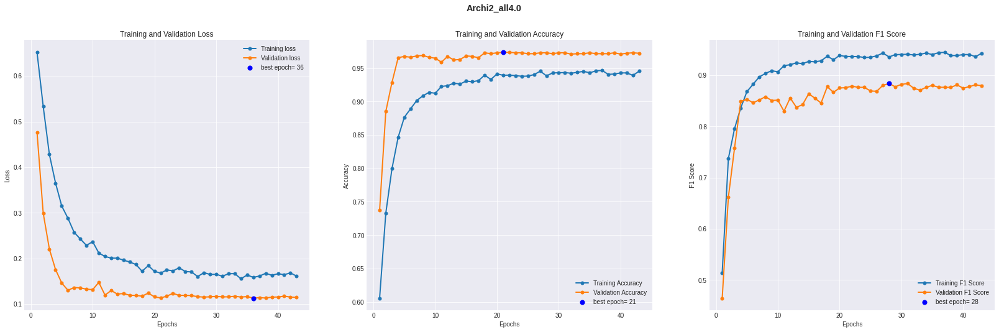

In [ ]:
#best ARCHI2: advanced augmentation (4-0): with respect to the standard augmentation a great improvement in training stability can be noticed together
#with a considerable reduction in overfitting
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = ([val_images_AR1],val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks
                                                    )
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, #tuple(tuple(training_generator)[0][0],tuple(training_generator)[1])
                                                    validation_data = (val_images_AR2,val_labels), # give directly all images and labels for the validation set. "model.fit" doesn't accept a generator as input to validation_data; Use model.fit_generator if you need a generator also for the validation set
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet model
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

Model Selected: ARCHI 3
Start Training...
____________________________________________________________________________________________________________________________________
(16884, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,  330],
       [7129,   30],
       [7148,  210]])
Epoch 1/300
168/168 [==============================] - 261s 1s/step - loss: 0.6348 - acc: 0.6406 - recall: 0.6216 - precision: 0.6412 - f1score: 0.6016 - val_loss: 0.4870 - val_acc: 0.7809 - val_recall: 0.5660 - val_precision: 0.3698 - val_f1score: 0.3903 - lr: 0.0010
Epoch 2/300
168/168 [==============================] - 239s 1s/step - loss: 0.5848 - acc: 0.7014 - recall: 0.7324 - precision: 0.6841 - f1score: 0.7009 - val_loss: 0.4886 - val_acc: 0.7749 - val_recall: 0.5749 - val_precision: 0.3468 - val_f1score: 0.3816 - lr: 0.0010
Epoch 3/300
168/168 [==============================] - 241s 1s/step - loss: 0.5434 - acc: 0.7260 - recall: 0.7490 - precision: 0.7078 - 

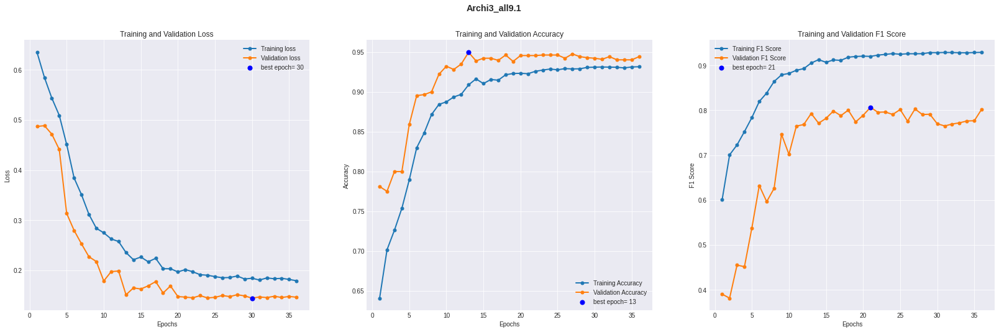

In [ ]:
#best ARCHI3: advanced augmentation 9-1: in this case the network beneffited of a greater amount of samples than those strictli necessary to balance the classes
#archi3 continues to be the worst performing network probably due to its too wide field of view which causes it to extract features which are not strictly the ones inherent to the lesion
#but with respect to the Archi3 trained with standard augmentation (4:0) the improvement is of the most noticeable: mainly stability and generalizability wise
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator,
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)


For comparison a few of the other experiments carried out with the selected model architectures but with variations of the dataset follow here

Model Selected: ARCHI 1
Start Training...
____________________________________________________________________________________________________________________________________
(7619, 2)
 array([[ 256,    0],
       [ 257,    0],
       [ 259,    0],
       ...,
       [7126,  270],
       [7129,    1],
       [7148,    0]])
Epoch 1/50
76/76 [==============================] - 36s 336ms/step - loss: 0.6229 - acc: 0.6383 - f1score: 0.3209 - precision: 0.3954 - recall: 0.3060 - val_loss: 0.3708 - val_acc: 0.8347 - val_f1score: 0.5167 - val_precision: 0.4516 - val_recall: 0.7376 - lr: 0.0010
Epoch 2/50
76/76 [==============================] - 15s 197ms/step - loss: 0.4314 - acc: 0.8154 - f1score: 0.7835 - precision: 0.7970 - recall: 0.7825 - val_loss: 0.2526 - val_acc: 0.9113 - val_f1score: 0.6455 - val_precision: 0.6223 - val_recall: 0.7605 - lr: 0.0010
Epoch 3/50
76/76 [==============================] - 16s 205ms/step - loss: 0.3545 - acc: 0.8513 - f1score: 0.8239 - precision: 0.8480 - rec

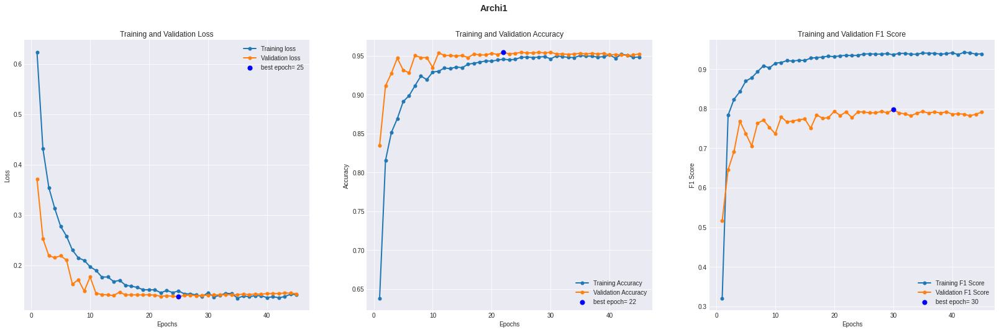

In [ ]:
#ARCHI1, standard augmentation (4-0)
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  # give directly all images and labels for the validation set. "model.fit" doesn't accept a generator as input to validation_data; Use model.fit_generator if you need a generator also for the validation set
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False) 


Model Selected: ARCHI 1
Start Training...
____________________________________________________________________________________________________________________________________
(28618, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,  210],
       [7129,  180],
       [7148,  150]])
Epoch 1/50
286/286 [==============================] - 92s 287ms/step - loss: 0.4944 - acc: 0.7491 - f1score: 0.7925 - precision: 0.7586 - recall: 0.8555 - val_loss: 0.2531 - val_acc: 0.9167 - val_f1score: 0.6929 - val_precision: 0.6412 - val_recall: 0.8302 - lr: 0.0010
Epoch 2/50
286/286 [==============================] - 67s 234ms/step - loss: 0.3129 - acc: 0.8687 - f1score: 0.8780 - precision: 0.8850 - recall: 0.8758 - val_loss: 0.2415 - val_acc: 0.9173 - val_f1score: 0.7220 - val_precision: 0.6653 - val_recall: 0.8922 - lr: 0.0010
Epoch 3/50
286/286 [==============================] - 67s 234ms/step - loss: 0.2517 - acc: 0.8995 - f1score: 0.9071 - precision: 0.908

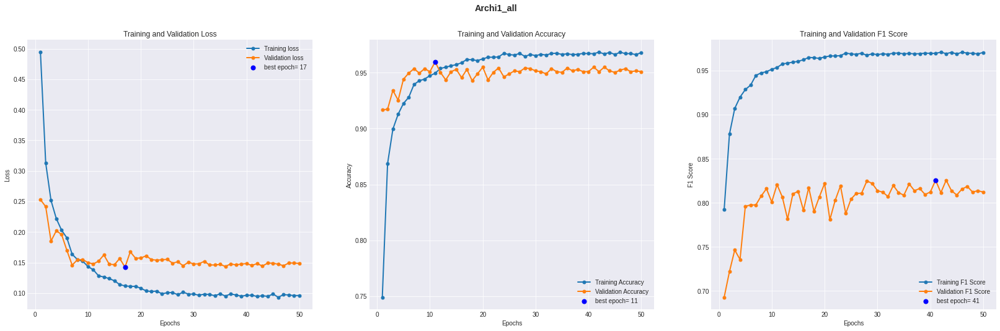

In [ ]:
#ARCHI1 with all augmentation 18-2
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = ([val_images_AR1],val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks
                                                    )
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

Model Selected: ARCHI 2
Start Training...
____________________________________________________________________________________________________________________________________
(7619, 2)
 array([[3230,    0],
       [5868,  180],
       [3397,  210],
       ...,
       [5864,    0],
       [5750,  270],
       [4897,    0]])
Epoch 1/50
76/76 [==============================] - 28s 348ms/step - loss: 0.6845 - acc: 0.5628 - recall: 0.0435 - precision: 0.2198 - f1score: 0.0621 - val_loss: 0.6161 - val_acc: 0.8837 - val_recall: 0.0000e+00 - val_precision: 0.0000e+00 - val_f1score: 0.0000e+00 - lr: 1.0000e-05
Epoch 2/50
76/76 [==============================] - 26s 339ms/step - loss: 0.6819 - acc: 0.5675 - recall: 6.1233e-04 - precision: 0.0263 - f1score: 0.0012 - val_loss: 0.6151 - val_acc: 0.8837 - val_recall: 0.0000e+00 - val_precision: 0.0000e+00 - val_f1score: 0.0000e+00 - lr: 1.0000e-05
Epoch 3/50
76/76 [==============================] - 26s 339ms/step - loss: 0.6792 - acc: 0.5675 - recal

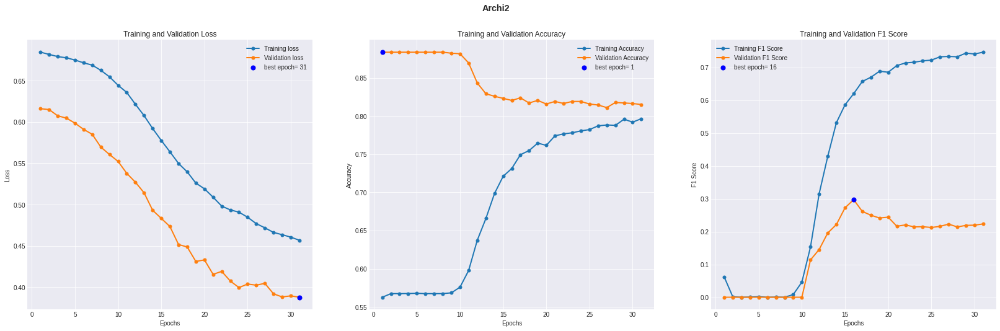

In [ ]:
#ARCHI2, standard augmentation (4-0)
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels),  
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)
#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

Model Selected: ARCHI 2
Start Training...
____________________________________________________________________________________________________________________________________
(28618, 2)
 array([[6156,  330],
       [4858,  150],
       [5691,  210],
       ...,
       [5415,    2],
       [6172,   30],
       [3329,   30]])
Epoch 1/50
286/286 [==============================] - 131s 453ms/step - loss: 0.6894 - acc: 0.5443 - recall: 0.8192 - precision: 0.5563 - f1score: 0.6531 - val_loss: 0.7162 - val_acc: 0.1250 - val_recall: 0.9787 - val_precision: 0.1232 - val_f1score: 0.2089 - lr: 1.0000e-05
Epoch 2/50
286/286 [==============================] - 126s 440ms/step - loss: 0.6799 - acc: 0.5840 - recall: 0.7795 - precision: 0.5910 - f1score: 0.6699 - val_loss: 0.6650 - val_acc: 0.6337 - val_recall: 0.9656 - val_precision: 0.2626 - val_f1score: 0.3918 - lr: 1.0000e-05
Epoch 3/50
286/286 [==============================] - 126s 443ms/step - loss: 0.6616 - acc: 0.6182 - recall: 0.7358 - precis

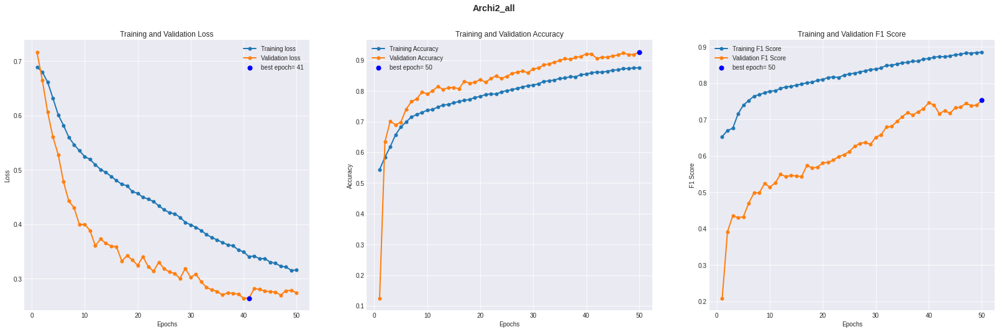

In [ ]:
##ARCHI2, advanced augmentation (18-2)
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

In [ ]:
model_archi2_article.load_weights("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/Archi2_all_Dec07_14-21-21/ckpts/cp.ckpt")

Model Selected: ARCHI 2
Start Training...
____________________________________________________________________________________________________________________________________
(28618, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,  210],
       [7129,  180],
       [7148,  150]])
Epoch 1/50
286/286 [==============================] - 142s 460ms/step - loss: 0.3398 - acc: 0.8614 - recall: 0.8772 - precision: 0.8706 - f1score: 0.8726 - val_loss: 0.2802 - val_acc: 0.9093 - val_recall: 0.9603 - val_precision: 0.6267 - val_f1score: 0.7205 - lr: 1.0000e-05
Epoch 2/50
286/286 [==============================] - 126s 441ms/step - loss: 0.3397 - acc: 0.8638 - recall: 0.8775 - precision: 0.8736 - f1score: 0.8742 - val_loss: 0.2716 - val_acc: 0.9153 - val_recall: 0.9489 - val_precision: 0.6641 - val_f1score: 0.7359 - lr: 1.0000e-05
Epoch 3/50
286/286 [==============================] - 125s 437ms/step - loss: 0.3364 - acc: 0.8656 - recall: 0.8783 - precis

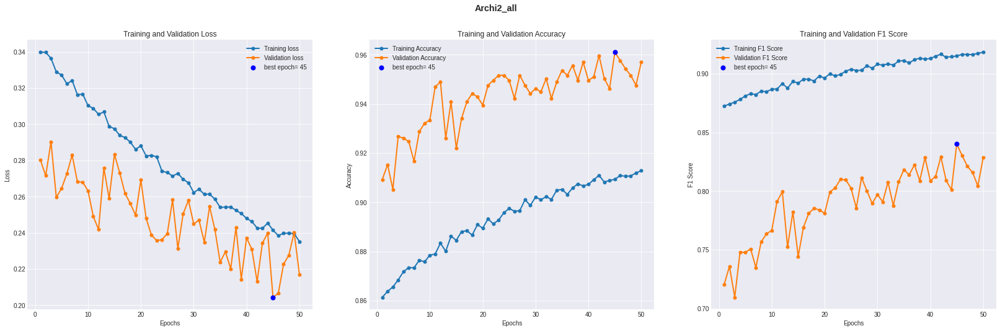

In [ ]:
#continue training of Archi2_all
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
if selected_model=="Archi2":
    print("Model Selected: ARCHI 2")
    print("Start Training...")
    print("_"*132)
    history_archi2_article = model_archi2_article.fit(x = training_generator, #tuple(tuple(training_generator)[0][0],tuple(training_generator)[1])
                                                    validation_data = (val_images_AR2,val_labels), # give directly all images and labels for the validation set. "model.fit" doesn't accept a generator as input to validation_data; Use model.fit_generator if you need a generator also for the validation set
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
    #Plot
    resume_plot(history_archi2_article, exp_dir, my_model_name)
    #Aimation
    animated_plot(history_archi2_article, repeat_animation=False)

In [ ]:
model_archi2_article.load_weights("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/Archi2_all_Dec10_11-42-47/ckpts/cp.ckpt")

Model Selected: ARCHI 2
Start Training...
____________________________________________________________________________________________________________________________________
Epoch 1/50
286/286 [==============================] - 126s 439ms/step - loss: 0.2405 - acc: 0.9105 - recall: 0.9062 - precision: 0.9282 - f1score: 0.9162 - val_loss: 0.2350 - val_acc: 0.9509 - val_recall: 0.9388 - val_precision: 0.7641 - val_f1score: 0.8118 - lr: 1.0000e-05
Epoch 2/50
286/286 [==============================] - 124s 434ms/step - loss: 0.2418 - acc: 0.9099 - recall: 0.9049 - precision: 0.9283 - f1score: 0.9156 - val_loss: 0.2155 - val_acc: 0.9556 - val_recall: 0.9388 - val_precision: 0.7925 - val_f1score: 0.8252 - lr: 1.0000e-05
Epoch 3/50
286/286 [==============================] - 123s 431ms/step - loss: 0.2398 - acc: 0.9096 - recall: 0.9055 - precision: 0.9276 - f1score: 0.9155 - val_loss: 0.2272 - val_acc: 0.9516 - val_recall: 0.9388 - val_precision: 0.7783 - val_f1score: 0.8159 - lr: 1.0000e-05


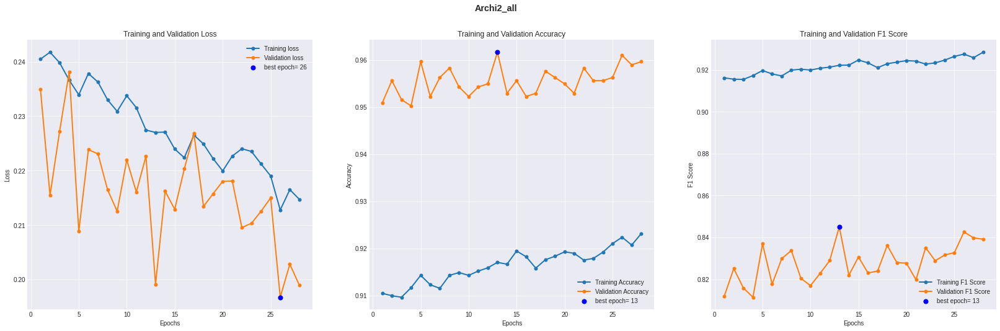

In [ ]:
#continue training of Archi2_all again (starting from 100 epochs here!)
#with 113 epochs the results obtained are slightly inferior to those of the best archi2; this goes to show that increasing the dataset dimensions
#while increasing variability with advanced transformations reduces overfitting (even for such long training) but not necessarily increases network performance
#mind this could also be due to such a limited validation set, perhaps greater differences could be appreciatable having more validation samples
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
if selected_model=="Archi2":
    print("Model Selected: ARCHI 2")
    print("Start Training...")
    print("_"*132)
    history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
    #Plot
    resume_plot(history_archi2_article, exp_dir, my_model_name)
    #Aimation
    animated_plot(history_archi2_article, repeat_animation=False)

Model Selected: ARCHI 3
Start Training...
____________________________________________________________________________________________________________________________________
(8442, 2)
 array([[ 256,    0],
       [ 257,    0],
       [ 259,    0],
       ...,
       [7126,    1],
       [7129,  180],
       [7148,    1]])
Epoch 1/20
84/84 [==============================] - 87s 896ms/step - loss: 0.6399 - acc: 0.6346 - recall: 0.5765 - precision: 0.6369 - f1score: 0.5874 - val_loss: 0.3582 - val_acc: 0.8273 - val_recall: 0.3211 - val_precision: 0.3275 - val_f1score: 0.2781 - lr: 0.0010
Epoch 2/20
84/84 [==============================] - 67s 798ms/step - loss: 0.5037 - acc: 0.7680 - recall: 0.7549 - precision: 0.7778 - f1score: 0.7584 - val_loss: 0.3280 - val_acc: 0.8582 - val_recall: 0.1028 - val_precision: 0.0922 - val_f1score: 0.0831 - lr: 0.0010
Epoch 3/20
84/84 [==============================] - 65s 775ms/step - loss: 0.3833 - acc: 0.8242 - recall: 0.7631 - precision: 0.8682 - f1sc

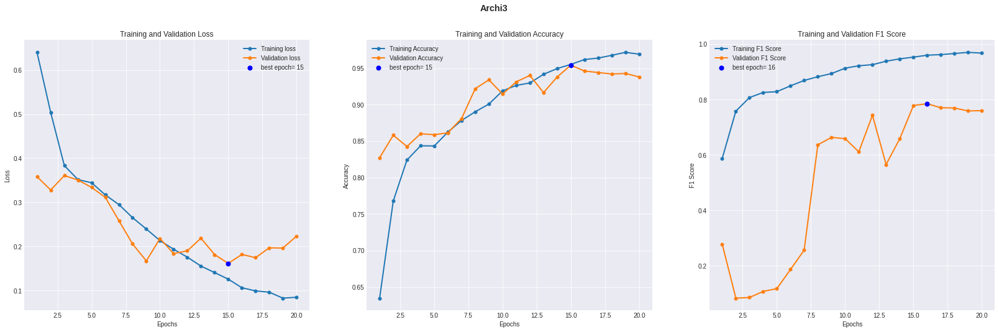

In [ ]:
#ARCHI3, standard augmentation (4-0)
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)


Model Selected: ARCHI 3
Start Training...
____________________________________________________________________________________________________________________________________
(28618, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,  210],
       [7129,  180],
       [7148,  150]])
Epoch 1/50
286/286 [==============================] - 395s 1s/step - loss: 0.6177 - acc: 0.6572 - recall: 0.7679 - precision: 0.6711 - f1score: 0.7029 - val_loss: 0.5435 - val_acc: 0.7359 - val_recall: 0.5608 - val_precision: 0.3000 - val_f1score: 0.3479 - lr: 0.0010
Epoch 2/50
286/286 [==============================] - 377s 1s/step - loss: 0.5638 - acc: 0.7124 - recall: 0.8060 - precision: 0.7103 - f1score: 0.7517 - val_loss: 0.5527 - val_acc: 0.7379 - val_recall: 0.5899 - val_precision: 0.3157 - val_f1score: 0.3597 - lr: 0.0010
Epoch 3/50
286/286 [==============================] - 375s 1s/step - loss: 0.5517 - acc: 0.7233 - recall: 0.8131 - precision: 0.7196 - f1s

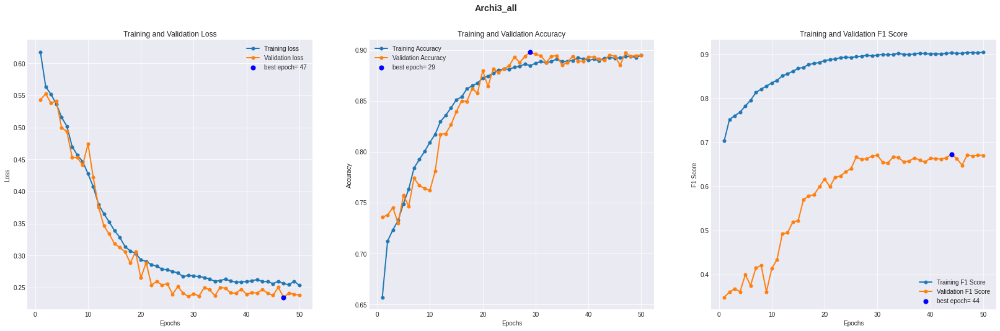

In [ ]:
##ARCHI3, advanced augmentation (18-2) (training was not continued for time reasons since a plateau seemed to be reached)
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

### Fast 3D Resnet
* The performance of the network are more or less comparable with the archi 1 
model but one possible problem is the dimension of the dataset.
* The dataset is very small while ResNet models (in general) require a lot of images to be trained properly.
* The small dimension and the complexity of the residual blocks leads to a very high overfitting even if the dimensions of the net are very small compared with archi1.

Nonetheless, the model looks promising and it would be interesting to try it out on larger datasets

In [ ]:
model_archi1_res = ResNet_3D_Fast(archi1_input_shape)
model_archi1_res.summary() #reported here for comodity

Model: "ResNet_3D"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 6, 20, 20,   0           []                               
                                1)]                                                               
                                                                                                  
 zero_padding3d (ZeroPadding3D)  (None, 12, 26, 26,   0          ['input_1[0][0]']                
                                1)                                                                
                                                                                                  
 conv1 (Conv3D)                 (None, 10, 22, 22,   4864        ['zero_padding3d[0][0]']         
                                64)                                                       

In [ ]:
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name="Archi1_Albumentation_Fast_Resnet_4_0")# in this case

if selected_model == "Archi1":
  print("Model Selected: ARCHI 1")
  print("Start Training...")
  print("_"*132)
  history_archi1_article = model_archi1_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  # Plot
  resume_plot(history_archi1_article, exp_dir, my_model_name)
  # Animation
  animated_plot(history_archi1_article, repeat_animation=False)
elif selected_model == "Archi2":
  print("Model Selected: ARCHI 2")
  print("Start Training...")
  print("_"*132)
  history_archi2_article = model_archi2_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR2,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi2_article, exp_dir, my_model_name)
  #Aimation
  animated_plot(history_archi2_article, repeat_animation=False)
  
elif selected_model == "Archi3":
  print("Model Selected: ARCHI 3")
  print("Start Training...")
  print("_"*132)
  history_archi3_article = model_archi3_article.fit(x = training_generator, 
                                                    validation_data = (val_images_AR3,val_labels),
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi3_article, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi3_article, repeat_animation=False)

#ResNet models
elif selected_model == "Archi1_ResNet":
  print("Model Selected: ARCHI 1 ResNet")
  print("Start Training...")
  print("_"*132)
  history_archi1_res = model_archi1_res.fit(x = training_generator, 
                                                    validation_data = (val_images_AR1,val_labels), 
                                                    epochs = epochs, steps_per_epoch = steps,
                                                    callbacks= my_callbacks)
  #Plot
  resume_plot(history_archi1_res, exp_dir, my_model_name)
  #Animation
  animated_plot(history_archi1_res, repeat_animation=False)

## Save the trained models for later

In [ ]:
if selected_model == "Archi1":
    model_archi1_article.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))
elif selected_model == "Archi2":
    model_archi2_article.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))
elif selected_model == "Archi3":
    model_archi3_article.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))
elif selected_model == "Archi1_ResNet":
    model_archi1_res.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi3_all/assets


## Results
(animated plots repeated to display them all)

In [ ]:
animated_plot(history_archi1_article, repeat_animation=False)
#here I am showing 1 just TP

In [ ]:
animated_plot(history_archi2_article, repeat_animation=False)
#here I am showing 2 just TP

In [ ]:
animated_plot(history_archi3_article, repeat_animation=False)
#here I am showing 3 just TP

In [ ]:
animated_plot(history_archi1_article, repeat_animation=False)
#here I am showing 1 all 18-2

In [ ]:
animated_plot(history_archi2_article, repeat_animation=False)
#here I am showing 2 all 18-2

In [ ]:
animated_plot(history_archi3_article, repeat_animation=False)
#here I am showing 3 all 18-2

In [ ]:
animated_plot(history_archi1_res, repeat_animation=False)

# **MODEL RESTORING**

In [ ]:
model_archi1_article=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi1", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi2_article=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi2", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi3_article=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi3", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi1_all=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi1_all", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi2_all=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi2_all_contTR", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi3_all=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi3_all", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
model_archi1_res=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/Archi1_Albumentation_Fast_Resnet_4_0", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)

## **Prediction on valens dataset**
(here we are using it as test set, no decision taken on these performances), it is just done so the results may be compared with the ensamble models

In [ ]:
#only TP aug
y_pred_valens1 = model_archi1_article.predict(valens_images_AR1)
y_pred_valens1 = np.asarray(y_pred_valens1)[:,0]
y_pred_valens2 = model_archi2_article.predict(valens_images_AR2)
y_pred_valens2 = np.asarray(y_pred_valens2)[:,0]
y_pred_valens3 = model_archi3_article.predict(valens_images_AR3)
y_pred_valens3 = np.asarray(y_pred_valens3)[:,0]
# all aug (18-2)
y_pred_valens1all = model_archi1_all.predict(valens_images_AR1)
y_pred_valens1all = np.asarray(y_pred_valens1all)[:,0]
y_pred_valens2all = model_archi2_all.predict(valens_images_AR2)
y_pred_valens2all = np.asarray(y_pred_valens2all)[:,0]
y_pred_valens3all = model_archi3_all.predict(valens_images_AR3)
y_pred_valens3all = np.asarray(y_pred_valens3all)[:,0]
# all aug and residual
#y_pred_valens1res = model_archi1_res.predict(valens_images_AR1)
#y_pred_valens1res = np.asarray(y_pred_valens1res)[:,0]

In [ ]:
#actually val_labels and valens_labels already available
y1 = np.array(h5file.root.target)
y_valens = y1[idx_valens]
y_val = y1[idx_val]

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,precision_recall_curve,auc,roc_curve, f1_score 
import seaborn as sn

# **Evaluate Archi 1,2 and 3 on only TP augmentation**

## Confusion Matrix

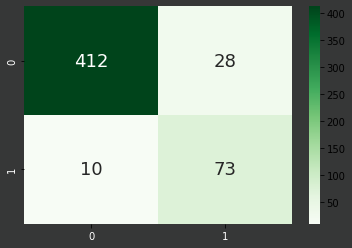

In [ ]:
#--Archi1 TP aug--

selected_thr = 0.5
# Confusion Matrix
CM1 = confusion_matrix(y_valens,y_pred_valens1>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM1, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

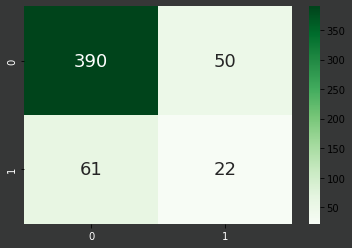

In [ ]:
#--Archi2 tp aug--

selected_thr = 0.5
# Confusion Matrix
CM2 = confusion_matrix(y_valens,y_pred_valens2>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM2, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

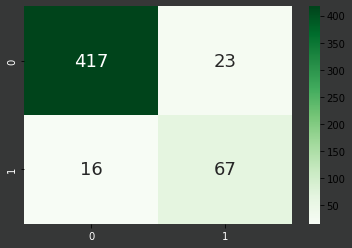

In [ ]:
#--Archi3 tp aug--

selected_thr = 0.5
# Confusion Matrix
CM3 = confusion_matrix(y_valens,y_pred_valens3>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM3, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--Archi1 tp aug--

tn, fp, fn, tp = CM1.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens1>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens1>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

412
28
10
73
Acc: 0.9273422562141491
f1 score: 0.7934782608695651
(Se,Pr)=(0.88,0.72)


In [ ]:
#--Archi2 tp aug--

tn, fp, fn, tp = CM2.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens2>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens2>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

390
50
61
22
Acc: 0.7877629063097514
f1 score: 0.28387096774193554
(Se,Pr)=(0.27,0.31)


In [ ]:
#--Archi3 tp aug--

tn, fp, fn, tp = CM3.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens3>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens3>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

417
23
16
67
Acc: 0.9254302103250478
f1 score: 0.7745664739884394
(Se,Pr)=(0.81,0.74)


## **Curves PRC and ROC**

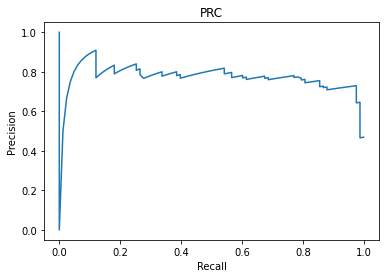

AUPRC TEST-SET : 0.7681


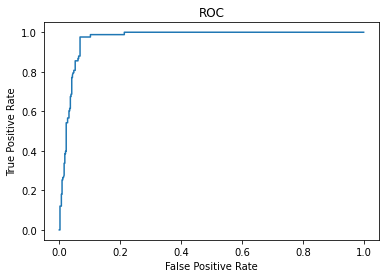

AUROC: 0.9686


In [ ]:
#--Archi 1 tp aug--

# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens1)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens1)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

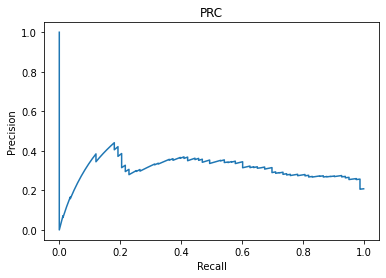

AUPRC TEST-SET : 0.3068


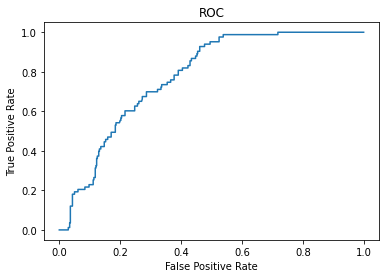

AUROC: 0.776


In [ ]:
#--Archi 2 tp aug--

# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens2)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens2)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

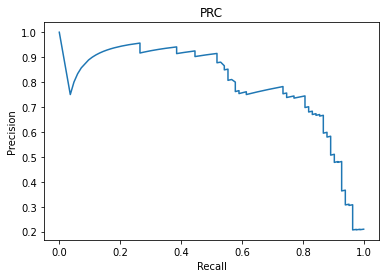

AUPRC TEST-SET : 0.7889


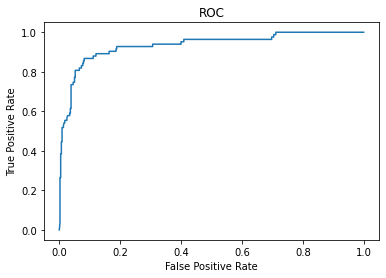

AUROC: 0.9343


In [ ]:
#--Archi 3 tp aug--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens3)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens3)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

# **Evaluate Archi 1,2,3 trained with advanced 18-2**

## Confusion Matrix

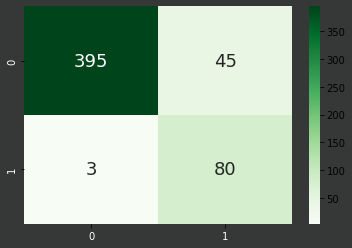

In [ ]:
#--Archi1 all--

selected_thr = 0.5
# Confusion Matrix
CM1 = confusion_matrix(y_valens,y_pred_valens1all>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM1, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

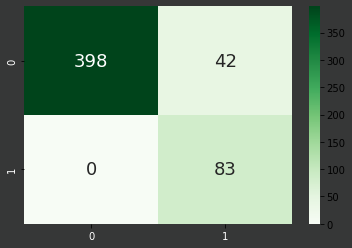

In [ ]:
#--Archi2 all--

selected_thr = 0.5
# Confusion Matrix
CM2 = confusion_matrix(y_valens,y_pred_valens2all>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM2, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

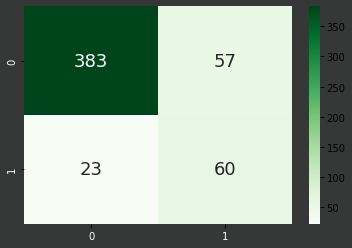

In [ ]:
#--Archi3 all--

selected_thr = 0.5
# Confusion Matrix
CM3 = confusion_matrix(y_valens,y_pred_valens3all>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM3, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--Archi1 all--

tn, fp, fn, tp = CM1.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens1all>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens1all>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

395
45
3
80
Acc: 0.9082217973231358
f1 score: 0.7692307692307693
(Se,Pr)=(0.96,0.64)


In [ ]:
#--Archi2 all--

tn, fp, fn, tp = CM2.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens2all>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens2all>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

398
42
0
83
Acc: 0.9196940726577438
f1 score: 0.798076923076923
(Se,Pr)=(1.0,0.66)


In [ ]:
#--Archi3 all--

tn, fp, fn, tp = CM3.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens3all>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens3all>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

383
57
23
60
Acc: 0.847036328871893
f1 score: 0.6
(Se,Pr)=(0.72,0.51)


## **Curves PRC and ROC**

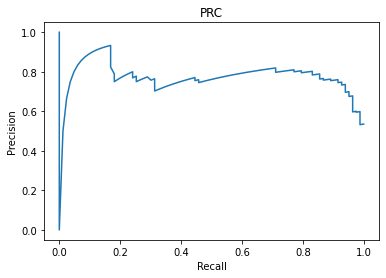

AUPRC TEST-SET : 0.7697


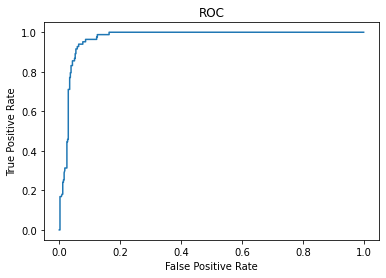

AUROC: 0.9696


In [ ]:
#--Archi 1 all--

# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens1all)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens1all)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

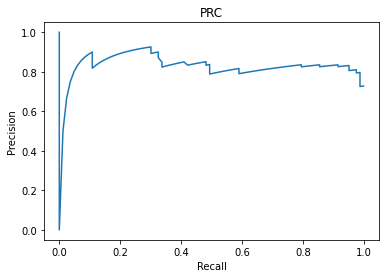

AUPRC TEST-SET : 0.8264


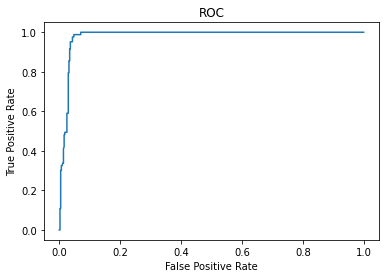

AUROC: 0.98


In [ ]:
#--Archi 2 all--

# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens2all)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens2all)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

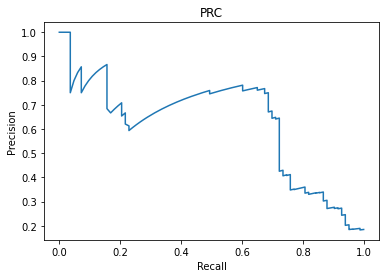

AUPRC TEST-SET : 0.6204


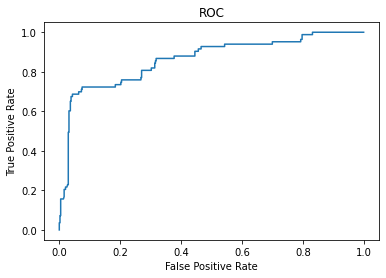

AUROC: 0.862


In [ ]:
#--Archi 3 all--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens3all)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens3all)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

# ResNet with field of view as archi1

## Confusion Matrix

In [ ]:
#--Archi1 all res--

selected_thr = 0.5
# Confusion Matrix
CM1 = confusion_matrix(y_valens,y_pred_valens1res>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CM1, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--Archi1 all res--

tn, fp, fn, tp = CM1.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens1res>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens1res>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

## **Curves PRC and ROC**

In [ ]:
#--Archi 1 all res--

# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens1res)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens1res)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

# Multimodal Networks

# **Multimodal network**
###Parallel convolutional branches until classifier
After having tuned each archi model's parameters, the idea is to replicate their convolutional parts, feed them with their field of view and then have a common classifier (increased complexity) use ALL of the extracted features: regarding only the lesion, its immediate surroundings and its contest for archi 1,2,3 respectively in order obtain a more robust prediction and possibly increase overall performance

In [ ]:
#@markdown ## Hyperparameters:
epochs =  70#@param {type:"number"}
dropout_archi1 = 0.3 #@param {type:"number"}
dropout_archi2 = 0.3 #@param {type:"number"}
dropout_archi3 = 0.4 #@param {type:"number"}
dropout_classifier= 0.5 #@param {type:"number"}

In [ ]:
# MODEL  DEFINITION
#multi-modal network
def build_multimodal_2dense (): 
    
    input_layer_AR1 = keras.layers.Input(shape = archi1_input_shape)
    input_layer_AR2 = keras.layers.Input(shape = archi2_input_shape)
    input_layer_AR3 = keras.layers.Input(shape = archi3_input_shape)
    

    #AR1
    conv11 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR1)
    pool11 = keras.layers.MaxPooling3D(
        pool_size = (1,1,1)
        )(conv11)
    pool11 = keras.layers.Dropout(dropout_archi1, seed=seed)(pool11)

    conv21 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool11)

    conv31 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv21)
    
    flattening_layer_AR1 = keras.layers.GlobalMaxPool3D()(conv31)
    flattening_layer_AR1 = keras.layers.Dropout(dropout_archi1, seed=seed)(flattening_layer_AR1)

    #AR2
    conv12 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR2)
    pool12 = keras.layers.MaxPooling3D(
        pool_size = (1,2,2)
        )(conv12)
    pool12 = keras.layers.Dropout(dropout_archi2, seed=seed)(pool12)

    conv22 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool12)

    conv32 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv22)
    
    flattening_layer_AR2 = keras.layers.GlobalMaxPool3D()(conv32)
    flattening_layer_AR2 = keras.layers.Dropout(dropout_archi2, seed=seed)(flattening_layer_AR2)
    
    
    #AR3
    conv13 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR3)
    pool13 = keras.layers.MaxPooling3D(
        pool_size = (2,2,2)
        )(conv13)
    pool13 = keras.layers.Dropout(dropout_archi3, seed=seed)(pool13)

    conv23 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool13)

    conv33 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv23)
    
    flattening_layer_AR3 = keras.layers.GlobalMaxPool3D()(conv33)
    flattening_layer_AR3 = keras.layers.Dropout(dropout_archi3, seed=seed)(flattening_layer_AR3)

    #concatenate 3 outputs
    concatenation_layer= keras.layers.Concatenate()([flattening_layer_AR1,flattening_layer_AR2,flattening_layer_AR3])
    
    classifier_layer = keras.layers.Dense(units=256, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(concatenation_layer)
    classifier_layer = keras.layers.Dropout(dropout_classifier, seed=seed)(classifier_layer)
    classifier_layer = keras.layers.Dense(units=128, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(classifier_layer)
    classifier_layer = keras.layers.Dropout(dropout_classifier, seed=seed)(classifier_layer)
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier_layer)

    # Connect input and output through the Model class
    model = keras.Model(inputs=[input_layer_AR1,input_layer_AR2,input_layer_AR3],
                    outputs=output_layer,
                    name="multimodal_model")

    # Compile the model
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score]) 

    # Return the model
    return model

In [ ]:
multimodel= build_multimodal_2dense ()

In [ ]:
multimodel.summary()

Model: "multimodal_model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 6, 20, 20,   0           []                               
                                1)]                                                               
                                                                                                  
 input_5 (InputLayer)           [(None, 10, 30, 30,  0           []                               
                                 1)]                                                              
                                                                                                  
 input_6 (InputLayer)           [(None, 26, 40, 40,  0           []                               
                                 1)]                                               

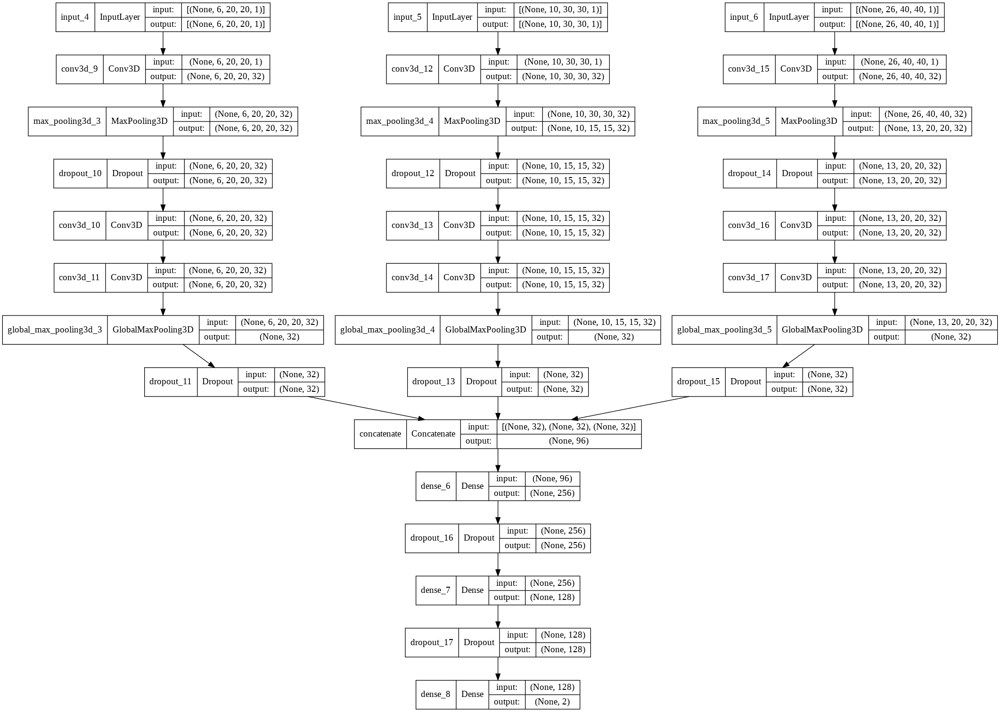

In [ ]:
plot_model(multimodel,show_shapes=True, show_layer_names=True)

In [ ]:
#to deal with data imbalance, before balanced augmentation, balanced loss was attemped: this corresponds to a greater weight update magnitude for 
#missclassifications of the minority class with respect to misscalassifications of the majority one
'''
from sklearn.utils import class_weight
train_labels_decoded = np.argmax(y[idx_train], axis=1) #decode from 1 hot encoding
class_weights_alt = class_weight.compute_class_weight(
            class_weight='balanced', 
            classes=np.unique(train_labels_decoded),
            y=train_labels_decoded)
class_weights_alt = dict(enumerate(class_weights_alt))
'''

In [ ]:
training_generator3 = imageLoader_ensemble(h5file, idx_angles_training, y, batch_size)

(8442, 2)
 array([[2123,    0],
       [3498,    0],
       [5467,  180],
       ...,
       [2092,    0],
       [4487,    0],
       [1697,    0]])
Epoch 1/40
84/84 [==============================] - 104s 1s/step - loss: 0.6680 - acc: 0.5910 - recall: 0.4198 - precision: 0.6078 - f1score: 0.4464 - val_loss: 0.5843 - val_acc: 0.6597 - val_recall: 0.8004 - val_precision: 0.3103 - val_f1score: 0.4063 - lr: 0.0010
Epoch 2/40
84/84 [==============================] - 93s 1s/step - loss: 0.4625 - acc: 0.7918 - recall: 0.7923 - precision: 0.8050 - f1score: 0.7845 - val_loss: 0.3109 - val_acc: 0.9082 - val_recall: 0.6888 - val_precision: 0.6687 - val_f1score: 0.6260 - lr: 0.0010
Epoch 3/40
84/84 [==============================] - 92s 1s/step - loss: 0.2772 - acc: 0.8920 - recall: 0.8671 - precision: 0.9121 - f1score: 0.8856 - val_loss: 0.2530 - val_acc: 0.9120 - val_recall: 0.6335 - val_precision: 0.6443 - val_f1score: 0.6068 - lr: 0.0010
Epoch 4/40
84/84 [==============================] - 93

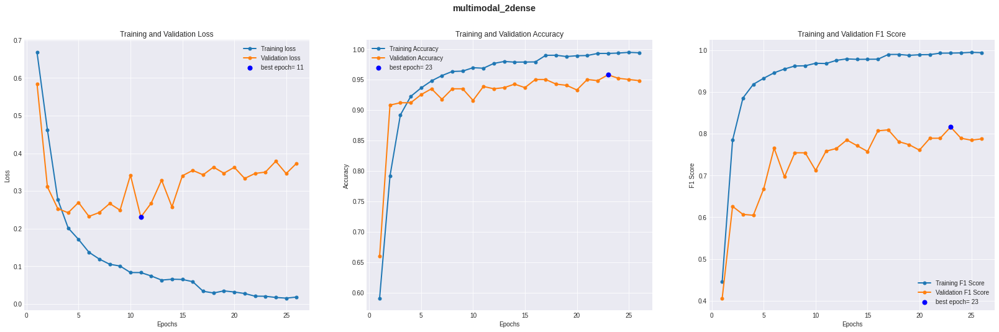

In [ ]:
#just TP augmentation
my_model_name='multimodal_2dense'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel.fit(x= training_generator3,   # give the generator as input data
          validation_data = ([valens_images_AR1,valens_images_AR2,valens_images_AR3],valens_labels), # give directly all images and labels for the validation set. "model.fit" doesn't accept a generator as input to validation_data; Use model.fit_generator if you need a generator also for the validation set
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

Epoch 1/70
168/168 [==============================] - 372s 2s/step - loss: 0.5724 - acc: 0.6980 - recall: 0.6797 - precision: 0.7136 - f1score: 0.6745 - val_loss: 0.3382 - val_acc: 0.9273 - val_recall: 0.6727 - val_precision: 0.6860 - val_f1score: 0.6614 - lr: 0.0010
Epoch 2/70
168/168 [==============================] - 322s 2s/step - loss: 0.3581 - acc: 0.8501 - recall: 0.8368 - precision: 0.8633 - f1score: 0.8428 - val_loss: 0.1796 - val_acc: 0.9388 - val_recall: 0.7857 - val_precision: 0.7898 - val_f1score: 0.7628 - lr: 0.0010
Epoch 3/70
168/168 [==============================] - 317s 2s/step - loss: 0.2625 - acc: 0.8930 - recall: 0.8922 - precision: 0.8941 - f1score: 0.8894 - val_loss: 0.1732 - val_acc: 0.9388 - val_recall: 0.9265 - val_precision: 0.7242 - val_f1score: 0.7860 - lr: 0.0010
Epoch 4/70
168/168 [==============================] - 320s 2s/step - loss: 0.2229 - acc: 0.9127 - recall: 0.9154 - precision: 0.9090 - f1score: 0.9100 - val_loss: 0.1617 - val_acc: 0.9713 - val_re

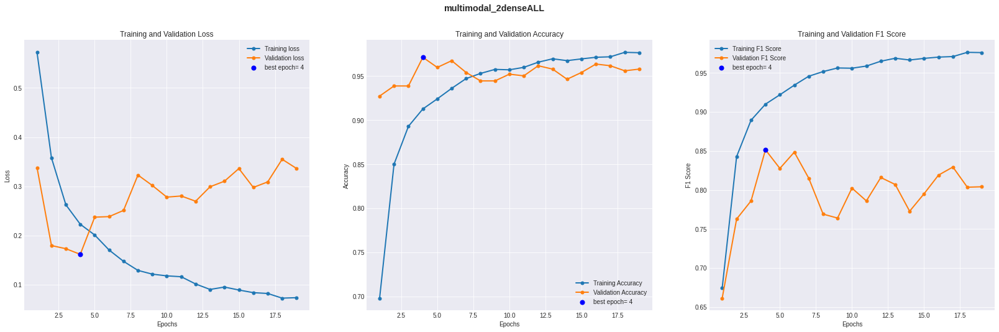

In [ ]:
#all augmentation
#even with an augmented dataset the model overfits more than the simplesr single archis, this could be due due, not only to the increase of parameters due to the 3 parallel branches but 
#also to the considerable increase of parameters given by the addition of a dense layer
my_model_name='multimodal_2denseALL'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel.fit(x= training_generator3,   # give the generator as input data
          validation_data = ([valens_images_AR1,valens_images_AR2,valens_images_AR3],valens_labels), # give directly all images and labels for the validation set. "model.fit" doesn't accept a generator as input to validation_data; Use model.fit_generator if you need a generator also for the validation set
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

In [ ]:
multimodel.save(os.path.join(exps_dir, str('best_model/' +  my_model_name))) 
#model_archi3_article.save('./archi3_bal__article.h5')
#model_archi3_article.save('./Task1/archi3_bal_article_sure.h5')
#model_archi3_article.save_weights('./Task1/archi3_bal_article_weights.h5')
#model_archi3_article.save_weights('./archi3_bal_article_weights_bu.h5')
#model_archi3_article.save('./Task1/archi3_bal_article_gaus.h5')
#model_archi3_article.save_weights('./archi3_bal_article_weights_gaus.h5')

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_2denseALL/assets


In [ ]:
multimodel=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_2dense", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
multimodelALL=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_2denseALL", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)

### **Prediction on valens dataset**

In [ ]:
#TP aug
y_pred_valens_multi = multimodel.predict([valens_images_AR1,valens_images_AR2,valens_images_AR3])
y_pred_valens_multi = np.asarray(y_pred_valens_multi)[:,0]

In [ ]:
#all aug
y_pred_valens_multiALL = multimodelALL.predict([valens_images_AR1,valens_images_AR2,valens_images_AR3])
y_pred_valens_multiALL = np.asarray(y_pred_valens_multiALL)[:,0]

## Evaluate the multimodal network treined on the balanced training set by augmenting only TP samples

## Confusion Matrix

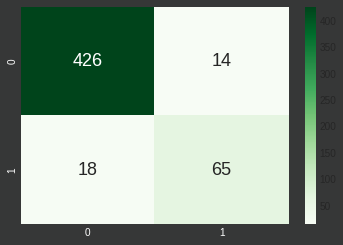

NameError: ignored

In [ ]:
#--Multimodal model--
selected_thr = 0.5
# Confusion Matrix
CMmulti = confusion_matrix(y_valens,y_pred_valens_multi>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMmulti, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--multimodal model--
tn, fp, fn, tp = CMmulti.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_multi>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens_multi>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
18
65
Acc: 0.9388145315487572
f1 score: 0.8024691358024693
(Se,Pr)=(0.78,0.82)


## **Curves PRC and ROC**

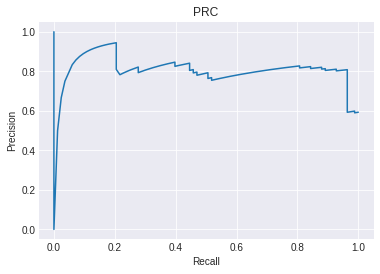

AUPRC TEST-SET : 0.8017


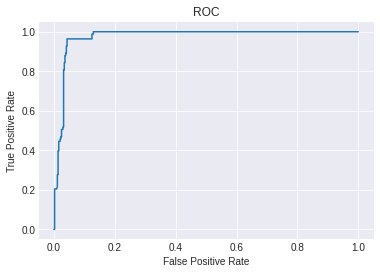

AUROC: 0.9747


In [ ]:
#--multimodal model--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_multi)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_multi)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

## Evaluate the multimodal network treined on the balanced training set by augmenting all classes


## Confusion Matrix

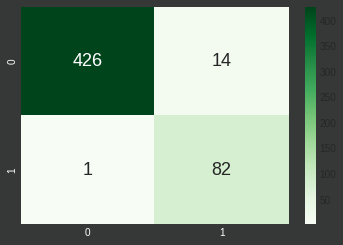

In [ ]:
#--Multimodal model ALL--
selected_thr = 0.5
# Confusion Matrix
CMmulti = confusion_matrix(y_valens,y_pred_valens_multiALL>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMmulti, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--multimodal model ALL--
tn, fp, fn, tp = CMmulti.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_multiALL>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens_multiALL>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
1
82
Acc: 0.97131931166348
f1 score: 0.9162011173184358
(Se,Pr)=(0.99,0.85)


## **Curves PRC and ROC**

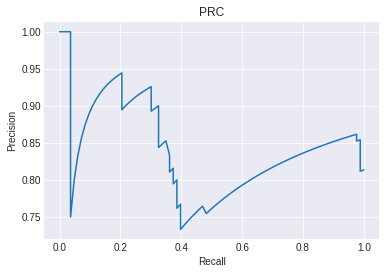

AUPRC TEST-SET : 0.843


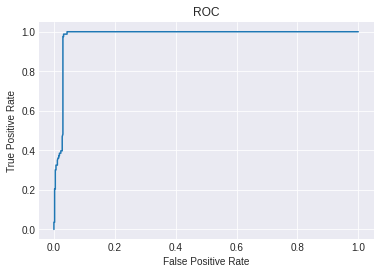

AUROC: 0.9801


In [ ]:
#--multimodal model ALL--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_multiALL)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_multiALL)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

# **Multimodal network**
### parallel convolutional branches - common convolution - classifier
The rationale behind this other type of multimodal network is to see if the issue that prevented the previous one from outperforming the single archis could be due to the parameters added by the bigger classifier which caused overfitting to prevent increasing performance on validation.
And also, the common convolutional layer might allow the extraction of spatially localized features extracted from each branch 


In [ ]:
#@markdown ## Hyperparameters:
epochs =  50#@param {type:"number"}
dropout_archi1 = 0.3 #@param {type:"number"}
dropout_archi2 = 0.4 #@param {type:"number"}
dropout_archi3 = 0.5 #@param {type:"number"}
dropout_classifier= 0.5 #@param {type:"number"}

In [ ]:
# MODEL  DEFINITION
#multi-modal network
def build_multimodal_conv (): 
    
    input_layer_AR1 = keras.layers.Input(shape = (10, 20,20,1)) #modfied for concatenation
    input_layer_AR2 = keras.layers.Input(shape = archi2_input_shape)
    input_layer_AR3 = keras.layers.Input(shape = (20,40,40,1))
    

    #AR1
    conv11 = keras.layers.Conv3D(
        filters=16, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR1)
    pool11 = keras.layers.MaxPooling3D(
        pool_size = (1,1,1)
        )(conv11)
    pool11 = keras.layers.Dropout(dropout_archi1, seed=seed)(pool11)

    conv21 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool11)

    conv31 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv21)
    pool21 = keras.layers.MaxPooling3D(
        pool_size = (1,2,2)
        )(conv31)
    flattening_layer_AR1 = keras.layers.Dropout(dropout_archi1, seed=seed)(pool21)

    #AR2
    conv12 = keras.layers.Conv3D(
        filters=16, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR2)
    pool12 = keras.layers.MaxPooling3D(
        pool_size = (1,1,1)
        )(conv12)
    pool12 = keras.layers.Dropout(dropout_archi2, seed=seed)(pool12)

    conv22 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool12)

    conv32 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv22)
    pool22 = keras.layers.MaxPooling3D(
        pool_size = (1,3,3)
        )(conv32)
    flattening_layer_AR2 = keras.layers.Dropout(dropout_archi2, seed=seed)(pool22)
    
    
    #AR3
    conv13 = keras.layers.Conv3D(
        filters=16, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(input_layer_AR3)
    pool13 = keras.layers.MaxPooling3D(
        pool_size = (2,2,2)
        )(conv13)
    pool13 = keras.layers.Dropout(dropout_archi3, seed=seed)(pool13)

    conv23 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(pool13)

    conv33 = keras.layers.Conv3D(
        filters=32, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(conv23)
    pool23 = keras.layers.MaxPooling3D(
        pool_size = (1,2,2)
        )(conv33)
    flattening_layer_AR3 = keras.layers.Dropout(dropout_archi3, seed=seed)(pool23)

    #concatenate 3 outputs
    concatenation_layer= keras.layers.Concatenate()([flattening_layer_AR1,flattening_layer_AR2,flattening_layer_AR3])
    
    #conv layer to all 3 outputs concatenated
    convFull = keras.layers.Conv3D(
        filters=64, kernel_size=(3,5,5), padding='same',
        #data_format="channels_last", 
        activation="relu",
        kernel_initializer=keras.initializers.GlorotUniform(seed)
        )(concatenation_layer)
    convFull= keras.layers.GlobalMaxPool3D()(convFull)
    convFull = keras.layers.Dropout(dropout_classifier, seed=seed)(convFull)
    
    classifier_layer = keras.layers.Dense(units=250, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(convFull)
    classifier_layer = keras.layers.Dropout(dropout_classifier, seed=seed)(classifier_layer)
    #classifier_layer = keras.layers.Dense(units=128, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(classifier_layer)
    #classifier_layer = keras.layers.Dropout(dropout_classifier, seed=seed)(classifier_layer)
    output_layer = keras.layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier_layer)

    # Connect input and output through the Model class
    model = keras.Model(inputs=[input_layer_AR1,input_layer_AR2,input_layer_AR3],
                    outputs=output_layer,
                    name="multimodal_model")

    # Compile the model
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score]) 

    # Return the model
    return model

In [ ]:
multimodel_c= build_multimodal_conv()

In [ ]:
multimodel_c.summary()

Model: "multimodal_model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_22 (InputLayer)          [(None, 10, 20, 20,  0           []                               
                                 1)]                                                              
                                                                                                  
 input_23 (InputLayer)          [(None, 10, 30, 30,  0           []                               
                                 1)]                                                              
                                                                                                  
 input_24 (InputLayer)          [(None, 20, 40, 40,  0           []                               
                                 1)]                                               

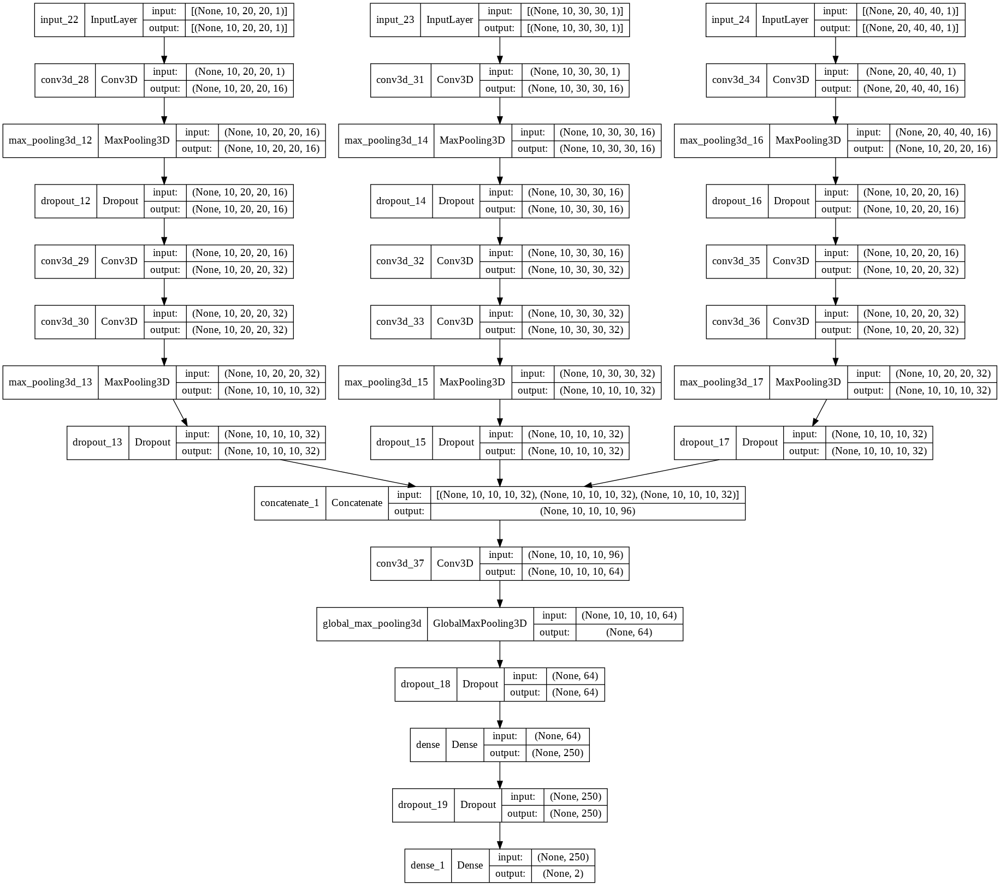

In [ ]:
plot_model(multimodel_c,show_shapes=True, show_layer_names=True)

In [ ]:
#a specific image loader is necessary since global max pooling is not applied before concatenation in order to allow the common convolutional layer to 
#combine spatial features from each branch in a localized manner
if augment_what == "just_TP":
  def imageLoader_ensembleMOD(files, idx_samples,target, batch_size):
      L = len(idx_samples)
      #random.shuffle(idx_samples)
      
      print(idx_samples.shape)
      idx_samples = K.print_tensor(idx_samples)
      np.random.shuffle(idx_samples)
      
      while True:
          batch_start = 0
          batch_end = batch_size

          while batch_end <= L:
              limit = min(batch_end, L)

              tmpB_AR1 = np.empty((limit-batch_start,10,20,20))
              tmpB_AR2 = np.empty((limit-batch_start,10,30,30))
              tmpB_AR3 = np.empty((limit-batch_start,20,40,40))
              tmpB_Y = np.empty((limit-batch_start,2)) #new
              
              idx =-1
              for i in range(batch_start,limit):
                  idx=idx+1
                  # Ranges has to be updated according to the input size we are dealing with
                  
                  img_A1 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,10:30,10:30],axis=0) #i,0 #9:15,14:34,14:34
                  img_A2 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0) #7:17,9:39,9:39
                  img_A3 =  np.expand_dims(files.root.images[idx_samples[i,0],3:23,:,:],axis=0) #:,4:44,4:44

                  # image processing
                  img_A1 = normalize(img_A1)
                  img_A2 = normalize(img_A2)
                  img_A3 = normalize(img_A3)
                  
                  # from the value in the second column verify which transformation apply 
                  angle = idx_samples[i,1] #i
                  if angle == 1:
                      img_A1 = np.flip(img_A1,axis=3) # horizontal FLIP 
                      img_A2 = np.flip(img_A2,axis=3) # horizontal FLIP
                      img_A3 = np.flip(img_A3,axis=3) # horizontal FLIP
                  elif angle ==2:
                      img_A1 = np.flip(img_A1,axis=2) # vertical FLIP 
                      img_A2 = np.flip(img_A2,axis=2) # vertical FLIP 
                      img_A3 = np.flip(img_A3,axis=2) # vertical FLIP 
                  elif angle >2 :
                      img_A1 = ndimage.rotate(img_A1,angle,reshape=False,mode='constant',axes = (2,3))
                      img_A2 = ndimage.rotate(img_A2,angle,reshape=False,mode='constant',axes = (2,3))
                      img_A3 = ndimage.rotate(img_A3,angle,reshape=False,mode='constant',axes = (2,3))
                  elif angle == 0: # original image is considered
                      img_A1 = img_A1
                      img_A2 = img_A2
                      img_A3 = img_A3


                  # fill the allocated vector with the tranformed image
                  tmpB_AR1[idx,:,:,:] =img_A1
                  tmpB_AR2[idx,:,:,:] =img_A2
                  tmpB_AR3[idx,:,:,:] =img_A3
                  tmpB_Y[idx,:] = target[idx_samples[i,0],:] #new


              X_AR1 = np.expand_dims(tmpB_AR1,axis=-1)
              X_AR2 = np.expand_dims(tmpB_AR2,axis=-1)
              X_AR3 = np.expand_dims(tmpB_AR3,axis=-1)
              #Y = target[idx_samples[batch_start:limit],0] # ,0 in ]
              Y = tmpB_Y 

              yield ([X_AR1,X_AR2,X_AR3] ,Y)    

              batch_start += batch_size   
              batch_end += batch_size            

elif augment_what == "all":
    print("all classes augmented")
    def imageLoader_ensembleMOD(files, idx_samples,target, batch_size):
      L = len(idx_samples)
      #random.shuffle(idx_samples)
      
      print(idx_samples.shape)
      idx_samples = K.print_tensor(idx_samples)
      np.random.shuffle(idx_samples)
      
      while True:
          batch_start = 0
          batch_end = batch_size

          while batch_end <= L:
              limit = min(batch_end, L)

              # we have to allocate in advance the space for the input batch
              tmpB_AR1 = np.empty((limit-batch_start,10,20,20))  #<------------------------------------------------------------------ARCHI 1 SHAPE
              tmpB_AR2 = np.empty((limit-batch_start,10,30,30)) #<------------------------------------------------------------------ARCHI 2 SHAPE
              tmpB_AR3 = np.empty((limit-batch_start,20,40,40)) #<------------------------------------------------------------------ARCHI 3 SHAPE
              tmpB_Y = np.empty((limit-batch_start,2))
              
              idx =-1
              for i in range(batch_start,limit):
                  idx=idx+1
                  # Ranges has to be updated according to the input size we are dealing with
                  # Limitation: only the center is considered, what if nodule at border'''

                  img_A1 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,10:30,10:30],axis=0)  #<----------------------------------ARCHI 3 CENTER
                  img_A2 =  np.expand_dims(files.root.images[idx_samples[i,0],8:18,5:35,5:35],axis=0)  #<----------------------------------ARCHI 3 CENTER
                  img_A3 =  np.expand_dims(files.root.images[idx_samples[i,0],3:23,:,:],axis=0) #<----------------------------------ARCHI 3 CENTER
                  
                  # image processing
                  img_A1 = normalize(img_A1)
                  img_A2 = normalize(img_A2)
                  img_A3 = normalize(img_A3)
                  # from the value in the second column verify which transformation apply 
                  angle = idx_samples[i,1]



                  if angle >= 1:
                      # AUGMENTATION!!-------------------------------------------------------------------------------------------------------------------           
                      
                      # Extract the number of slices
                      n_slices1 = img_A1.shape[1]
                      n_slices2 = img_A2.shape[1]
                      n_slices3 = img_A3.shape[1]

                      # generation of the dictionary to pass at the augmentation function
                      targets_dict = {}
                      
                      for k in range(n_slices1+n_slices2+n_slices3):  
                        targets_dict[str('image'+str(k))] = 'image'
                  
                      # Extraction of the slices to augment
                      slices1 = [] #<----------------------------------------Archi 1
                      for j1 in range(n_slices1):
                        im_slice1 = img_A1[:,j1,:,:]
                        slices1.append(np.squeeze(im_slice1))
                      
                      # Extraction of the slices to augment
                      slices2 = [] #<----------------------------------------Archi 2
                      for j2 in range(n_slices2):
                        im_slice2 = img_A2[:,j2,:,:]
                        slices2.append(np.squeeze(im_slice2))
                      
                      # Extraction of the slices to augment
                      slices3 = [] #<----------------------------------------Archi 3
                      for j3 in range(n_slices3):
                        im_slice3 = img_A3[:,j3,:,:]
                        slices3.append(np.squeeze(im_slice3))
                      
                      # Resetting the seed
                      t = 1000 * time.time() # current time in milliseconds
                      np.random.seed(int(t) % 2**32)

                      # Change Transformation each time
                      aug = A.Compose([
                                      A.OneOf([
                                              A.VerticalFlip(p=0.1),
                                              A.HorizontalFlip(p=0.1),
                                              #A.RandomBrightnessContrast(p=0.2),                 
                                              A.Rotate(limit=(-180,180),p=0.8),
                                      ], p=1.0),
                                      A.Transpose(p=0.4),
                                      A.Blur(blur_limit=4, p=0.2),
                                      A.OneOf([
                                              A.OpticalDistortion(p = 0.2, distort_limit=0.8, shift_limit=0.3),
                                              A.ElasticTransform(p = 0.25, alpha=50, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                                              A.GridDistortion(p = 0.25, num_steps = 5, distort_limit=(-0.3, 0.3)),
                                              A.Perspective (p = 0.2, scale=(0.05, 0.12)),
                                      ], p=0.5),
                                      ], 
                                      additional_targets = targets_dict)
                      
                      # APPLICO la stessa augmentation per tutte le slice---------------------------------------------------------------------------------------------------
                      augmented = aug(image=slices1[0], image1=slices1[1], image2=slices1[2] ,image3=slices1[3], image4=slices1[4], image5=slices1[5], imageX=slices1[6], imageX1=slices1[7], imageX2=slices1[8], imageX3=slices1[9],  
                                      image6=slices2[0], image7=slices2[1], image8=slices2[2] ,image9=slices2[3], image10=slices2[4], image11=slices2[5], image12=slices2[6], image13=slices2[7], image14=slices2[8], image15=slices2[9],
                                      image16=slices3[0], image17=slices3[1], image18=slices3[2] ,image19=slices3[3], image20=slices3[4], image21=slices3[5], image22=slices3[6], image23=slices3[7], image24=slices3[8], image25=slices3[9],
                                      image26=slices3[10], image27=slices3[11], image28=slices3[12] ,image29=slices3[13], image30=slices3[14], image31=slices3[15], image32=slices3[16], image33=slices3[17], image34=slices3[18], 
                                      image35=slices3[19])
                      
                      slices_aug1 = []
                      slices_aug2 = []
                      slices_aug3 = []
                      slices_aug1.append(augmented['image'])
                      slices_aug1.append(augmented['image1'])
                      slices_aug1.append(augmented['image2'])
                      slices_aug1.append(augmented['image3'])
                      slices_aug1.append(augmented['image4'])
                      slices_aug1.append(augmented['image5'])
                      slices_aug1.append(augmented['imageX'])
                      slices_aug1.append(augmented['imageX1'])
                      slices_aug1.append(augmented['imageX2'])
                      slices_aug1.append(augmented['imageX3'])  
                      slices_aug2.append(augmented['image6'])
                      slices_aug2.append(augmented['image7'])
                      slices_aug2.append(augmented['image8'])
                      slices_aug2.append(augmented['image9'])
                      slices_aug2.append(augmented['image10'])
                      slices_aug2.append(augmented['image11'])
                      slices_aug2.append(augmented['image12'])
                      slices_aug2.append(augmented['image13'])
                      slices_aug2.append(augmented['image14'])
                      slices_aug2.append(augmented['image15'])
                      slices_aug3.append(augmented['image16'])
                      slices_aug3.append(augmented['image17'])
                      slices_aug3.append(augmented['image18'])
                      slices_aug3.append(augmented['image19'])
                      slices_aug3.append(augmented['image20'])
                      slices_aug3.append(augmented['image21'])
                      slices_aug3.append(augmented['image22'])
                      slices_aug3.append(augmented['image23'])
                      slices_aug3.append(augmented['image24'])
                      slices_aug3.append(augmented['image25'])
                      slices_aug3.append(augmented['image26'])
                      slices_aug3.append(augmented['image27'])
                      slices_aug3.append(augmented['image28'])
                      slices_aug3.append(augmented['image29'])
                      slices_aug3.append(augmented['image30'])
                      slices_aug3.append(augmented['image31'])
                      slices_aug3.append(augmented['image32'])
                      slices_aug3.append(augmented['image33'])
                      slices_aug3.append(augmented['image34'])
                      slices_aug3.append(augmented['image35'])

                      # Ricostruisco l'immagine
                      stack_tuple1 = () #<--------------------------------Archi1
                      for z1 in range(n_slices1):
                        stack_tuple1 = stack_tuple1 + (slices_aug1[z1],)

                      aug_image1 = np.stack(stack_tuple1, axis=0)
                      img_A1 = np.expand_dims(aug_image1, axis = 0)

                      stack_tuple2 = () #<--------------------------------Archi2
                      for z2 in range(n_slices2):
                        stack_tuple2 = stack_tuple2 + (slices_aug2[z2],)

                      aug_image2 = np.stack(stack_tuple2, axis=0)
                      img_A2 = np.expand_dims(aug_image2, axis = 0)

                      stack_tuple3 = () #<--------------------------------Archi3
                      for z3 in range(n_slices3):
                        stack_tuple3 = stack_tuple3 + (slices_aug3[z3],)

                      aug_image3 = np.stack(stack_tuple3, axis=0)
                      img_A3 = np.expand_dims(aug_image3, axis = 0)

                  else: # original image is considered
                      img_A1 = img_A1
                      img_A2 = img_A2
                      img_A3 = img_A3

              

                  # fill the allocated vector with the tranformed image
                  tmpB_AR1[idx,:,:,:] =img_A1
                  tmpB_AR2[idx,:,:,:] =img_A2
                  tmpB_AR3[idx,:,:,:] =img_A3
                  tmpB_Y[idx,:] = target[idx_samples[i,0],:]


              X_AR1 = np.expand_dims(tmpB_AR1,axis=-1)
              X_AR2 = np.expand_dims(tmpB_AR2,axis=-1)
              X_AR3 = np.expand_dims(tmpB_AR3,axis=-1)
              
              Y = tmpB_Y 

              yield ([X_AR1,X_AR2,X_AR3] ,Y)   
              
              batch_start += batch_size   
              batch_end += batch_size



all classes augmented


In [ ]:
training_generator3mod = imageLoader_ensembleMOD(h5file, idx_angles_training, y, batch_size)

In [ ]:
valens_images_AR1mod =  np.expand_dims(h5file.root.images[list(idx_valens),8:18,10:30,10:30],axis=-1) 
valens_images_AR1mod = normalize(valens_images_AR1mod)       
print(np.shape(valens_images_AR1mod))
#ar2 is unchanged
print(np.shape(valens_images_AR2))
valens_images_AR3mod =  np.expand_dims(h5file.root.images[list(idx_valens),3:23,:,:],axis=-1) 
valens_images_AR3mod = normalize(valens_images_AR3mod)       
print(np.shape(valens_images_AR3mod))


/usr/local/lib/python3.7/dist-packages/tables/leaf.py:548: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  key = numpy.array(key)


(523, 10, 20, 20, 1)
(523, 10, 30, 30, 1)
(523, 20, 40, 40, 1)


(7619, 2)
 array([[6203,  330],
       [4554,    0],
       [4532,    2],
       ...,
       [3638,    0],
       [7075,    0],
       [2059,    2]])
Epoch 1/50
76/76 [==============================] - 99s 1s/step - loss: 0.6074 - acc: 0.6703 - recall: 0.5481 - precision: 0.5271 - f1score: 0.5216 - val_loss: 0.4252 - val_acc: 0.7916 - val_recall: 0.3490 - val_precision: 0.3276 - val_f1score: 0.3121 - lr: 0.0010
Epoch 2/50
76/76 [==============================] - 94s 1s/step - loss: 0.5375 - acc: 0.7333 - recall: 0.6807 - precision: 0.7047 - f1score: 0.6853 - val_loss: 0.5359 - val_acc: 0.7495 - val_recall: 0.4381 - val_precision: 0.3388 - val_f1score: 0.3620 - lr: 0.0010
Epoch 3/50
76/76 [==============================] - 94s 1s/step - loss: 0.4641 - acc: 0.7842 - recall: 0.7165 - precision: 0.7852 - f1score: 0.7386 - val_loss: 0.4625 - val_acc: 0.7897 - val_recall: 0.2229 - val_precision: 0.2282 - val_f1score: 0.2160 - lr: 0.0010
Epoch 4/50
76/76 [==============================] - 122

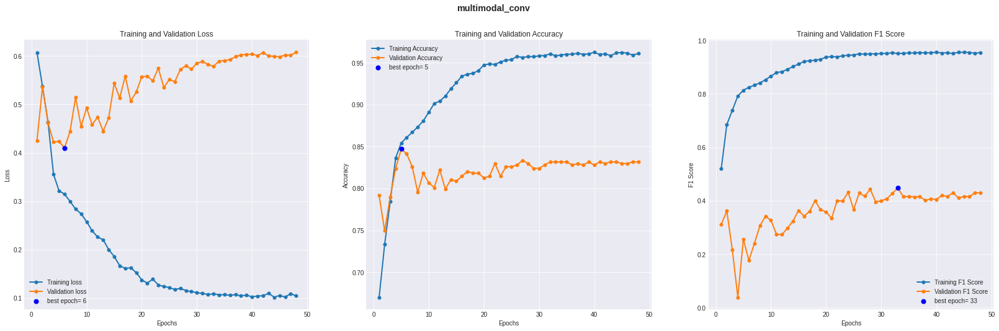

In [ ]:
#TP aug
#performance with standard augmentation tuned out to be even worse
my_model_name='multimodal_conv'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel_c.fit( x=training_generator3mod,   
          validation_data = ([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod],valens_labels), 
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

In [ ]:
#all aug
#but with the increased dataset this network improved considerably outperforming the above and proving the previous hypotheses to be true
my_model_name='multimodal_convALL'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel_c.fit( x=training_generator3mod,   
          validation_data = ([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod],valens_labels), 
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

(16884, 2)
 array([[6883,    0],
       [1671,    1],
       [2625,  180],
       ...,
       [6381,  270],
       [6173,  270],
       [4480,    1]])
Epoch 1/50
168/168 [==============================] - 324s 2s/step - loss: 0.6049 - acc: 0.6652 - recall: 0.6591 - precision: 0.6554 - f1score: 0.6297 - val_loss: 0.6057 - val_acc: 0.6826 - val_recall: 0.7742 - val_precision: 0.3410 - val_f1score: 0.4479 - lr: 1.2500e-04
Epoch 2/50
168/168 [==============================] - 311s 2s/step - loss: 0.4988 - acc: 0.7634 - recall: 0.8060 - precision: 0.7411 - f1score: 0.7657 - val_loss: 0.3741 - val_acc: 0.8528 - val_recall: 0.7326 - val_precision: 0.5302 - val_f1score: 0.5747 - lr: 1.2500e-04
Epoch 3/50
168/168 [==============================] - 309s 2s/step - loss: 0.3934 - acc: 0.8335 - recall: 0.8246 - precision: 0.8403 - f1score: 0.8268 - val_loss: 0.3244 - val_acc: 0.9120 - val_recall: 0.8751 - val_precision: 0.6811 - val_f1score: 0.7383 - lr: 1.2500e-04
Epoch 4/50
168/168 [=============

In [ ]:
multimodel_c.load_weights("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/multimodal_convALL_Dec08_10-25-50/ckpts/cp.ckpt")

In [ ]:
#all aug (continue from above, not really, ckpts were lost for some reason)
my_model_name='multimodal_convALL'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel_c.fit( x=training_generator3mod,   
          validation_data = ([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod],valens_labels), 
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

Epoch 1/50
168/168 [==============================] - 334s 2s/step - loss: 0.2630 - acc: 0.8978 - recall: 0.8812 - precision: 0.9075 - f1score: 0.8916 - val_loss: 0.3359 - val_acc: 0.9254 - val_recall: 0.9294 - val_precision: 0.6887 - val_f1score: 0.7659 - lr: 1.2500e-04
Epoch 2/50
168/168 [==============================] - 326s 2s/step - loss: 0.2268 - acc: 0.9165 - recall: 0.9076 - precision: 0.9213 - f1score: 0.9123 - val_loss: 0.3696 - val_acc: 0.9293 - val_recall: 0.9294 - val_precision: 0.6951 - val_f1score: 0.7666 - lr: 1.2500e-04
Epoch 3/50
168/168 [==============================] - 318s 2s/step - loss: 0.2013 - acc: 0.9286 - recall: 0.9258 - precision: 0.9283 - f1score: 0.9254 - val_loss: 0.3373 - val_acc: 0.9369 - val_recall: 0.9294 - val_precision: 0.7149 - val_f1score: 0.7867 - lr: 1.2500e-04
Epoch 4/50
168/168 [==============================] - 323s 2s/step - loss: 0.1831 - acc: 0.9343 - recall: 0.9318 - precision: 0.9345 - f1score: 0.9317 - val_loss: 0.2980 - val_acc: 0.9

In [ ]:
multimodel_c.load_weights("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/multimodal_convALL_Dec08_12-37-19/ckpts/cp.ckpt")

(16884, 2)
 array([[ 256,   30],
       [ 257,    2],
       [ 259,    2],
       ...,
       [7126,  330],
       [7129,   30],
       [7148,  210]])
Epoch 1/50
168/168 [==============================] - 351s 2s/step - loss: 0.1677 - acc: 0.9431 - recall: 0.9406 - precision: 0.9422 - f1score: 0.9405 - val_loss: 0.2667 - val_acc: 0.9560 - val_recall: 0.9412 - val_precision: 0.7608 - val_f1score: 0.8276 - lr: 1.2500e-04
Epoch 2/50
168/168 [==============================] - 317s 2s/step - loss: 0.1548 - acc: 0.9467 - recall: 0.9462 - precision: 0.9451 - f1score: 0.9446 - val_loss: 0.3255 - val_acc: 0.9331 - val_recall: 0.9412 - val_precision: 0.6958 - val_f1score: 0.7791 - lr: 1.2500e-04
Epoch 3/50
168/168 [==============================] - 317s 2s/step - loss: 0.1401 - acc: 0.9535 - recall: 0.9560 - precision: 0.9494 - f1score: 0.9521 - val_loss: 0.3045 - val_acc: 0.9503 - val_recall: 0.9412 - val_precision: 0.7494 - val_f1score: 0.8191 - lr: 1.2500e-04
Epoch 4/50
168/168 [=============

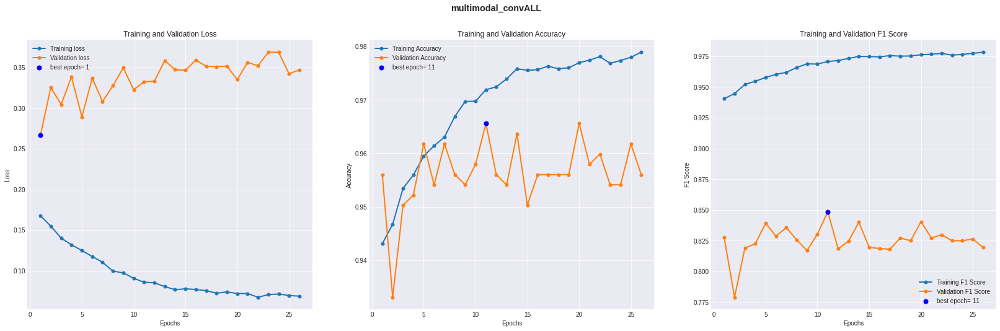

In [ ]:
#all aug (continue from above, which is already a continuation)
my_model_name='multimodal_convALL'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historymulti = multimodel_c.fit( x=training_generator3mod,   
          validation_data = ([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod],valens_labels), 
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historymulti, exp_dir, my_model_name)
#Animation
animated_plot(historymulti, repeat_animation=False)

In [ ]:
multimodel_c.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))
#model_archi3_article.save('./archi3_bal__article.h5')
#model_archi3_article.save('./Task1/archi3_bal_article_sure.h5')
#model_archi3_article.save_weights('./Task1/archi3_bal_article_weights.h5')
#model_archi3_article.save_weights('./archi3_bal_article_weights_bu.h5')
#model_archi3_article.save('./Task1/archi3_bal_article_gaus.h5')
#model_archi3_article.save_weights('./archi3_bal_article_weights_gaus.h5')

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_convALL/assets


In [ ]:
multimodel_c=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_conv", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)
multimodel_cALL=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/multimodal_convALL", custom_objects={"f1score":f1score,"recall":recall,"precision":precision,"loss":custom_crossentropy}, compile=True, options=None)

### **Prediction on valens dataset**

In [ ]:
y_pred_valens_multi_c = multimodel_c.predict([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod])
y_pred_valens_multi_c = np.asarray(y_pred_valens_multi_c)[:,0]

In [ ]:
y_pred_valens_multi_cALL = multimodel_cALL.predict([valens_images_AR1mod,valens_images_AR2,valens_images_AR3mod])
y_pred_valens_multi_cALL = np.asarray(y_pred_valens_multi_cALL)[:,0]

## Evaluate on TP aug train set

## Confusion Matrix

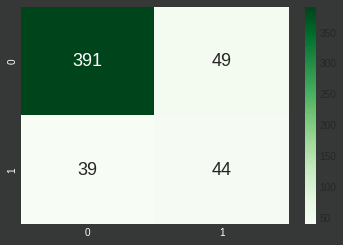

In [ ]:
#--Multimodal model--
selected_thr = 0.5
# Confusion Matrix
CMmulti = confusion_matrix(y_valens,y_pred_valens_multi_c>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMmulti, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--multimodal model--
tn, fp, fn, tp = CMmulti.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_multi_c>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens_multi_c>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

391
49
39
44
Acc: 0.8317399617590823
f1 score: 0.5000000000000001
(Se,Pr)=(0.53,0.47)


## **Curves PRC and ROC**

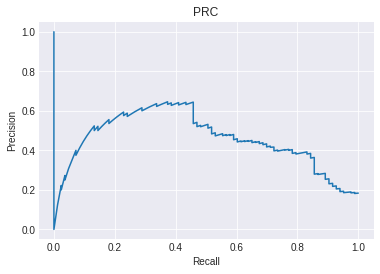

AUPRC TEST-SET : 0.4483


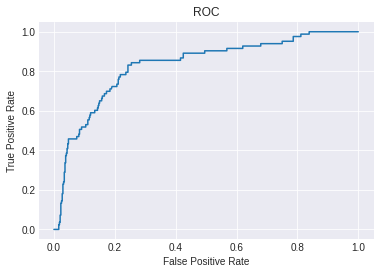

AUROC: 0.8288


In [ ]:
#--multimodal model--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_multi_c)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_multi_c)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

## Evaluate on all aug train set

## Confusion Matrix

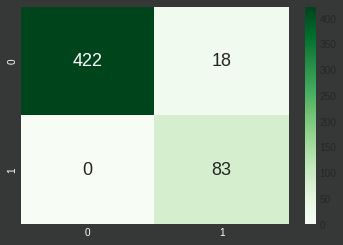

In [ ]:
#--Multimodal model--
selected_thr = 0.5
# Confusion Matrix
CMmulti = confusion_matrix(y_valens,y_pred_valens_multi_cALL>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMmulti, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

## **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--multimodal model--
tn, fp, fn, tp = CMmulti.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_multi_cALL>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens_multi_cALL>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

422
18
0
83
Acc: 0.9655831739961759
f1 score: 0.9021739130434783
(Se,Pr)=(1.0,0.82)


## **Curves PRC and ROC**

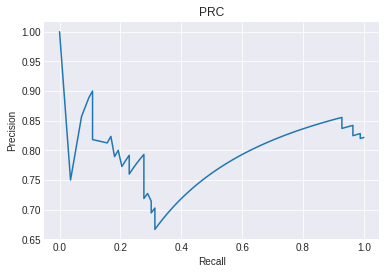

AUPRC TEST-SET : 0.7961


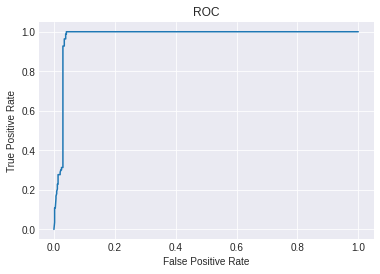

AUROC: 0.9766


In [ ]:
#--multimodal model--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_multi_cALL)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_multi_cALL)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

--------------------------------------------------------------------------------

--------------------------------------------------------------------------------

# **Ensemble models: combine outputs of multiple models**
Notice: obviously the ensemble models are not validated on the same validation set as the single models were validated upon since they have been optimized for that data so the ensemble performance on it would not be indicative of the actual ensemble's contribution to generalization on new data; this said val_ens is not a test set since it is used to select the best ensemble so we are also optimizing with respect to this data at this point.

In [ ]:
#architectures as in article trained on balanced dataset by only augmenting TP samples
y_pred_val1 = model_archi1_article.predict(val_images_AR1)
y_pred_val1 = np.asarray(y_pred_val1)[:,0]
y_pred_val2 = model_archi2_article.predict(val_images_AR2)
y_pred_val2 = np.asarray(y_pred_val2)[:,0]
y_pred_val3 = model_archi3_article.predict(val_images_AR3)
y_pred_val3 = np.asarray(y_pred_val3)[:,0]

In [ ]:
#architectures as in article trained on balanced dataset by augmenting all of it (18-2)
y_pred_val1all = model_archi1_all.predict(val_images_AR1)
y_pred_val1all = np.asarray(y_pred_val1all)[:,0]
y_pred_val2all = model_archi2_all.predict(val_images_AR2)
y_pred_val2all = np.asarray(y_pred_val2all)[:,0]
y_pred_val3all = model_archi3_all.predict(val_images_AR3)
y_pred_val3all = np.asarray(y_pred_val3all)[:,0]

## Combine archis on just_TP aug

In [ ]:
#CREATE A MATRIX WITH THE PREDICTED PROBABILITIES TO BE COMBINED #evaluate model on valens set
FTmatrix_train  = np.concatenate((y_pred_valens1.reshape(-1,1),y_pred_valens2.reshape(-1,1),y_pred_valens3.reshape(-1,1)),axis=1) #valens set used for validation
FTmatrix_train.shape

(523, 3)

In [ ]:
#define the grid of weights to be investigated
values_grid = np.arange(0.01, 0.99, 0.01);

def prediction (matrix, a, b, c):
  lista =[]
  for i in range (matrix.shape[0]):
    h = a*matrix[i][0] + b*matrix[i][1] + c*matrix[i][2] #try different thr for predicting pos for each archi (optimize)
    lista.append(h)
  return lista

### Gridsearch of best weights for each architecture

In [ ]:
# FOR LOOP TO SEARCH THE BEST COMBINATION OF WEIGHTS 
FTmatrix_val= np.concatenate((y_pred_val1.reshape(-1,1),y_pred_val2.reshape(-1,1),y_pred_val3.reshape(-1,1)),axis=1) #use validation set for training
best = [0, 0, 0]
area_max = 0
for a in values_grid:
  for b in values_grid:
    for c in values_grid:
      if(a+b+c == 1):
        y_pred = prediction(FTmatrix_val, a, b, c);
        y_pred = np.asarray(y_pred)
        prec, rec, thr_auprc=precision_recall_curve(y_val,y_pred)
        fpr, tpr, thr_auc=roc_curve(y_val,y_pred)
        auprc = auc(rec,prec)
        auroc = auc(fpr,tpr)
        if(auprc > area_max): #try also with auroc
          area_max = auprc
          best[0] = a
          best[1] = b
          best[2] = c

print(best)

[0.45, 0.25, 0.3]


In [ ]:
# derive the  weighted predicted probabilities
#evaluate performances on valens set
y_pred_multibranch_valens = prediction(FTmatrix_train, best[0], best[1], best[2])
y_pred_multibranch_valens = np.asarray(y_pred_multibranch_valens)[:]

#### Confusion Matrix

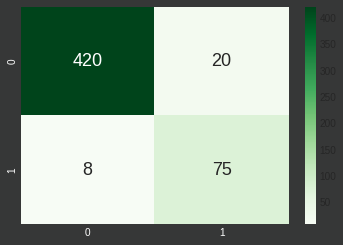

In [ ]:
#--ensamble model weighted gridsearch--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_multibranch_valens>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted gridsearch--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_multibranch_valens>=selected_thr)
f1 = f1_score(y_valens,y_pred_multibranch_valens>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

420
20
8
75
Acc: 0.9464627151051626
f1 score: 0.8426966292134832
(Se,Pr)=(0.9,0.79)


#### Curves PRC and ROC

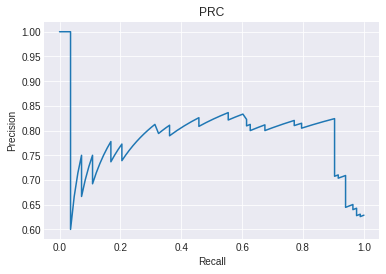

AUPRC TEST-SET : 0.7876


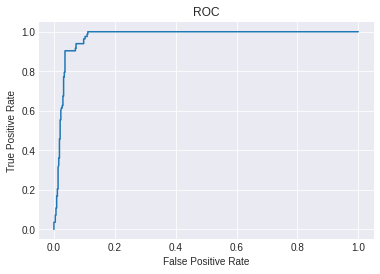

AUROC: 0.9729


In [ ]:
#--ensamble model weighted gridsearch--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_multibranch_valens)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_multibranch_valens)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Combine optimizing prediction threshold 

In [ ]:
 f1_max = 0
for thr in values_grid:
    y_pred = prediction(FTmatrix_val, 1./3, 1./3, 1./3)
    y_pred = np.asarray(y_pred)
    f1val = f1_score(y_val,y_pred>=thr)
    if(f1val > f1_max):
        f1_max = f1val
        best_thr=thr

print(best_thr)

0.43


In [ ]:
y_pred_valens_t = prediction(FTmatrix_train, 1./3, 1./3, 1./3)
y_pred_valens_t = np.asarray(y_pred_valens_t)[:]

#### Confusion Matrix

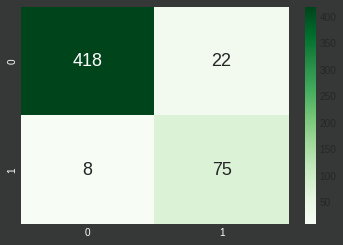

In [ ]:
# Confusion Matrix --best pred thr--
CMft = confusion_matrix(y_valens,y_pred_valens_t>=best_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMft, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model, best pred thr--
tn, fp, fn, tp = CMft.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_t>=best_thr)
f1 = f1_score(y_valens,y_pred_valens_t>=best_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

418
22
8
75
Acc: 0.9426386233269598
f1 score: 0.8333333333333334
(Se,Pr)=(0.9,0.77)


#### Curves PRC and ROC

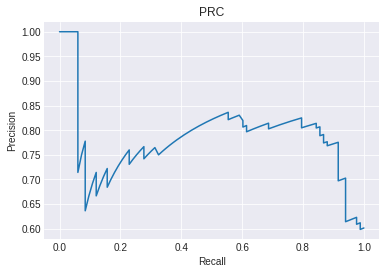

AUPRC TEST-SET : 0.7812


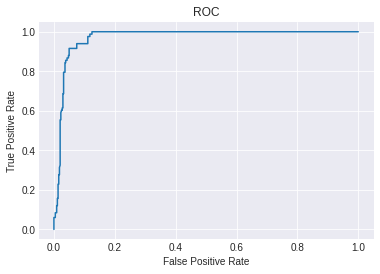

AUROC: 0.9709


In [ ]:
#--ensamble model, best pred thr--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_t)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_t)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

#### Ensamble combining the 3 archis' outputs weighted by own f1 on val

In [ ]:
selected_thr=0.5
f1val1 = f1_score(y_val,y_pred_val1>=selected_thr)
f1val2 = f1_score(y_val,y_pred_val2>=selected_thr)
f1val3 = f1_score(y_val,y_pred_val3>=selected_thr)
f1val1,f1val2,f1val3

(0.8, 0.3341645885286783, 0.7628865979381444)

In [ ]:
#on validation set for ensamble methods
summ=f1val1+f1val2+f1val3
w1=f1val1/summ
w2=f1val2/summ
w3=f1val3/summ
y_pred_fens = prediction(FTmatrix_train, w1, w2, w3)
y_pred_fens = np.asarray(y_pred_fens)[:]

In [ ]:
y_valens.shape, y_pred_fens.shape, FTmatrix_train.shape

((523,), (523,), (523, 3))

### Confusion Matrix

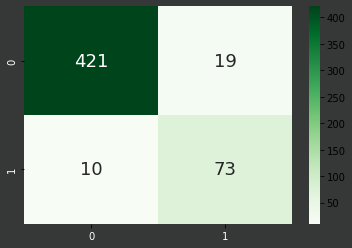

In [ ]:
#--ensamble model weighted on f1score--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_fens>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted on f1score--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_fens>=selected_thr)
f1 = f1_score(y_valens,y_pred_fens>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

421
19
10
73
Acc: 0.9445506692160612
f1 score: 0.8342857142857142
(Se,Pr)=(0.88,0.79)


#### Curves PRC and ROC

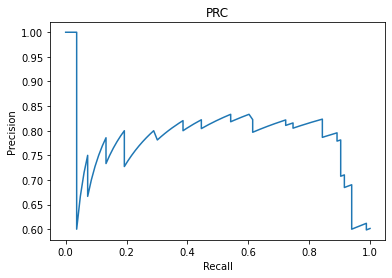

AUPRC TEST-SET : 0.7853


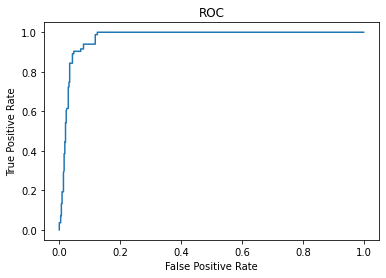

AUROC: 0.9714


In [ ]:
#--ensamble model weighted on f1score--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_fens)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_fens)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### decision tree and logistic regression

In [ ]:
#models chosen for interpretability
#they are fed the output of the single models and gridsearch is used to optimize their main hyperparameters

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score
X_train= FTmatrix_val
Y_train= y_val
X_test= FTmatrix_train
Y_test= y_valens

def hyperp_search(classifier, parameters):
    gs = GridSearchCV(classifier, parameters, cv=2, scoring = 'f1', verbose=3)
    gs = gs.fit(X_train, Y_train)
    f1_train = gs.best_score_
    print("f1_train: %f using %s" % (f1_train, gs.best_params_))

    best_model = gs.best_estimator_
    y_tr_pred= best_model.predict(X_train)
    y_pred = best_model.predict(X_test)
    f1_test = f1_score(Y_test, y_pred)
    print("f1_test: ", f1_test)
    
    print(confusion_matrix(Y_test, y_pred))

    print("acc_train: ", accuracy_score(Y_train, y_tr_pred))
    print("acc_test: ", accuracy_score(Y_test, y_pred))
    print("precision_train: ", precision_score(Y_train, y_tr_pred))
    print("precision_test: ", precision_score(Y_test, y_pred))
    print("recall_train: ", recall_score(Y_train, y_tr_pred))
    print("recall_test: ", recall_score(Y_test, y_pred))
    
    return (best_model)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

classifier = DecisionTreeClassifier()
parameters = {'criterion': ['entropy'],'max_depth': [1,2,3,4],'min_samples_split': [3,5],'min_samples_leaf': [3,5]}

best_tree = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 16 candidates, totalling 32 fits
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.857 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.675 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.857 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.675 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.857 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.675 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.857 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.675 total time=   

In [ ]:
from sklearn import tree
r = tree.export_text(best_tree)
print(r) 

|--- feature_0 <= 0.18
|   |--- feature_2 <= 0.03
|   |   |--- class: 0
|   |--- feature_2 >  0.03
|   |   |--- feature_2 <= 0.76
|   |   |   |--- feature_1 <= 0.58
|   |   |   |   |--- class: 0
|   |   |   |--- feature_1 >  0.58
|   |   |   |   |--- class: 0
|   |   |--- feature_2 >  0.76
|   |   |   |--- feature_1 <= 0.39
|   |   |   |   |--- class: 1
|   |   |   |--- feature_1 >  0.39
|   |   |   |   |--- class: 0
|--- feature_0 >  0.18
|   |--- feature_0 <= 0.78
|   |   |--- feature_2 <= 0.14
|   |   |   |--- feature_1 <= 0.56
|   |   |   |   |--- class: 0
|   |   |   |--- feature_1 >  0.56
|   |   |   |   |--- class: 0
|   |   |--- feature_2 >  0.14
|   |   |   |--- feature_1 <= 0.32
|   |   |   |   |--- class: 0
|   |   |   |--- feature_1 >  0.32
|   |   |   |   |--- class: 1
|   |--- feature_0 >  0.78
|   |   |--- feature_1 <= 0.62
|   |   |   |--- feature_1 <= 0.43
|   |   |   |   |--- class: 1
|   |   |   |--- feature_1 >  0.43
|   |   |   |   |--- class: 1
|   |   |--- featur

In [ ]:
#install graphviz https://graphviz.gitlab.io/download/

import sys
!conda install --yes --prefix {sys.prefix} graphviz
!{sys.executable} -m pip install graphviz

/bin/bash: conda: command not found


In [ ]:
from sklearn.tree import export_graphviz
export_graphviz(best_tree, out_file='decision_tree.dot', feature_names = ["Archi1","Archi2","Archi3"])

In [ ]:
!dot -Tpng decision_tree.dot -o decision_tree.png -Gdpi=600

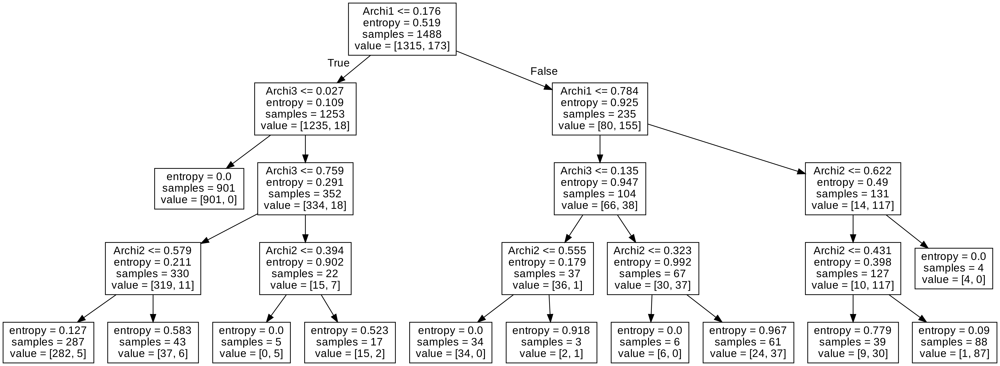

In [ ]:
from IPython.display import Image
Image(filename = 'decision_tree.png')

In [ ]:
from sklearn.linear_model import LogisticRegression

classifier = LogisticRegression()
parameters = {"C":[1e-3,1e-2,1e-1,1,10], "max_iter":[1000,2000], "tol": [1e-4,1e-5]} #C regulates the trade off between generalization (given by the regularization term) and the loss function (minimising the error) so a higher C may cause overfitting

best_logisticReg = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 20 candidates, totalling 40 fits
[CV 1/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END ..C=0.01, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END ..C=0.01, max_iter=1000, tol=1e-05;

In [ ]:
best_logisticReg.coef_

array([[4.02187287, 4.47321638, 2.76086345]])

### Check differences in what each archi learns

In [ ]:
def pred(y):
    if y>0.5:
        return 1
    else:    
        return 0

In [ ]:
tot_missclass1=0
tot_missclass2=0
tot_missclass3=0
tot_missclass1as2=0
tot_missclass1as3=0
tot_missclass2as3=0
tot_missclass1as2as3=0
tot_missclassU=0

for i in range(len(y_valens)):
    if (pred(y_pred_valens1[i]) != pred(y_valens[i]) and (pred(y_pred_valens2[i]) == pred(y_valens[i])) and (pred(y_pred_valens3[i]) == pred(y_valens[i]))):
        tot_missclass1+=1
    if (pred(y_pred_valens2[i]) != pred(y_valens[i]) and (pred(y_pred_valens1[i]) == pred(y_valens[i])) and (pred(y_pred_valens3[i]) == pred(y_valens[i]))):
        tot_missclass2+=1
    if (pred(y_pred_valens3[i]) != pred(y_valens[i]) and (pred(y_pred_valens1[i]) == pred(y_valens[i])) and (pred(y_pred_valens2[i]) == pred(y_valens[i]))):
        tot_missclass3+=1
    if ((pred(y_pred_valens1[i]) != pred(y_valens[i])) and (pred(y_pred_valens2[i]) != pred(y_valens[i])) and (pred(y_pred_valens3[i]) == pred(y_valens[i]))):
        tot_missclass1as2+=1
    if ((pred(y_pred_valens1[i]) != pred(y_valens[i])) and (pred(y_pred_valens3[i]) != pred(y_valens[i])) and (pred(y_pred_valens2[i]) == pred(y_valens[i]))):
        tot_missclass1as3+=1
    if ((pred(y_pred_valens2[i]) != pred(y_valens[i])) and (pred(y_pred_valens3[i]) != pred(y_valens[i])) and (pred(y_pred_valens1[i]) == pred(y_valens[i]))):
        tot_missclass2as3+=1
    if ((pred(y_pred_valens1[i]) != pred(y_valens[i])) and (pred(y_pred_valens2[i]) != pred(y_valens[i])) and (pred(y_pred_valens3[i]) != pred(y_valens[i]))):
        tot_missclass1as2as3+=1
    if ((pred(y_pred_valens1[i]) != pred(y_valens[i])) ^ (pred(y_pred_valens2[i]) != pred(y_valens[i])) ^ (pred(y_pred_valens3[i]) != pred(y_valens[i]))):
        tot_missclassU+=1

print("Considering the valens set: \n")
print(f"Out of {tot_missclass1} missclassifications for only ARCHI1, {tot_missclass1as2} are in common with ARCHI2, which missclassifies (alone) {tot_missclass2} samples")
print(f"and {tot_missclass1as3} are in common with ARCHI3, which missclassifies (alone) {tot_missclass3} samples")  
print(f"The number of common missclassifications for ARCHI2 and ARCHI 3 is {tot_missclass2as3}")
print(f"The number of common missclassifications for all 3 achitectures is {tot_missclass1as2as3}, compared to the {tot_missclassU} samples which are missclassified only by 1 architecture")

Considering the valens set: 

Out of 13 missclassifications for only ARCHI1, 5 are in common with ARCHI2, which missclassifies (alone) 84 samples
and 7 are in common with ARCHI3, which missclassifies (alone) 10 samples
The number of common missclassifications for ARCHI2 and ARCHI 3 is 9
The number of common missclassifications for all 3 achitectures is 13, compared to the 120 samples which are missclassified only by 1 architecture


## Combine archis on all aug 18-2

In [ ]:
#CREATE A MATRIX WITH THE PREDICTED PROBABILITIES TO BE COMBINED #evaluate model of valens set
FTmatrix_trainALL  = np.concatenate((y_pred_valens1all.reshape(-1,1),y_pred_valens2all.reshape(-1,1),y_pred_valens3all.reshape(-1,1)),axis=1) #valens set used for validation
FTmatrix_trainALL.shape

(523, 3)

In [ ]:
#define the grid of weights to be investigated
values_grid = np.arange(0.01, 0.99, 0.01);

def prediction (matrix, a, b, c):
  lista =[]
  for i in range (matrix.shape[0]):
    h = a*matrix[i][0] + b*matrix[i][1] + c*matrix[i][2] #try different thr for predicting pos for each archi (optimize)
    lista.append(h)
  return lista

### Gridsearch of best weights for each architecture

In [ ]:
# FOR LOOP TO SEARCH THE BEST COMBINATION OF WEIGHTS 
FTmatrix_valALL= np.concatenate((y_pred_val1all.reshape(-1,1),y_pred_val2all.reshape(-1,1),y_pred_val3all.reshape(-1,1)),axis=1) #use validation set for training
best = [0, 0, 0]
area_max = 0
for a in values_grid:
  for b in values_grid:
    for c in values_grid:
      if(a+b+c == 1):
        y_pred = prediction(FTmatrix_valALL, a, b, c);
        y_pred = np.asarray(y_pred)
        prec, rec, thr_auprc=precision_recall_curve(y_val,y_pred)
        fpr, tpr, thr_auc=roc_curve(y_val,y_pred)
        auprc = auc(rec,prec)
        auroc = auc(fpr,tpr)
        if(auprc > area_max): #try also with auroc
          area_max = auprc
          best[0] = a
          best[1] = b
          best[2] = c

print(best)

[0.05, 0.72, 0.23]


In [ ]:
# derive the  weighted predicted probabilities
#evaluate performances on valens set
y_pred_multibranch_valensALL = prediction(FTmatrix_trainALL, best[0], best[1], best[2])
y_pred_multibranch_valensALL = np.asarray(y_pred_multibranch_valensALL)[:]

#### Confusion Matrix

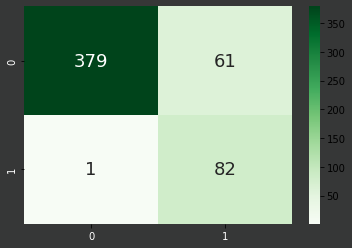

In [ ]:
#--ensamble model weighted gridsearch--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_multibranch_valensALL>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted gridsearch--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_multibranch_valensALL>=selected_thr)
f1 = f1_score(y_valens,y_pred_multibranch_valensALL>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

379
61
1
82
Acc: 0.8814531548757171
f1 score: 0.7256637168141593
(Se,Pr)=(0.99,0.57)


#### Curves PRC and ROC

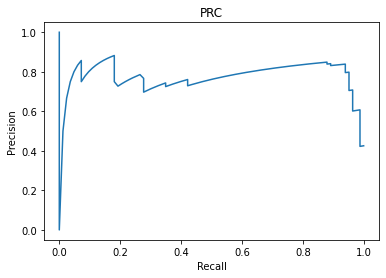

AUPRC TEST-SET : 0.7719


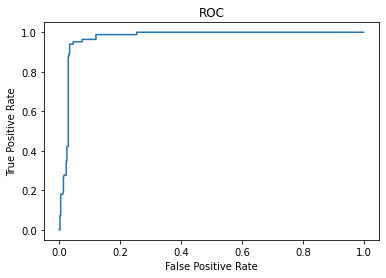

AUROC: 0.9716


In [ ]:
#--ensamble model weighted gridsearch--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_multibranch_valensALL)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_multibranch_valensALL)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Combine optimizing prediction threshold 

In [ ]:
 f1_max = 0
for thr in values_grid:
    y_pred = prediction(FTmatrix_valALL, 1./3, 1./3, 1./3)
    y_pred = np.asarray(y_pred)
    f1val = f1_score(y_val,y_pred>=thr)
    if(f1val > f1_max):
        f1_max = f1val
        best_thr=thr

print(best_thr)

0.66


In [ ]:
y_pred_valens_tALL = prediction(FTmatrix_trainALL, 1./3, 1./3, 1./3)
y_pred_valens_tALL = np.asarray(y_pred_valens_tALL)[:]

### Confusion Matrix

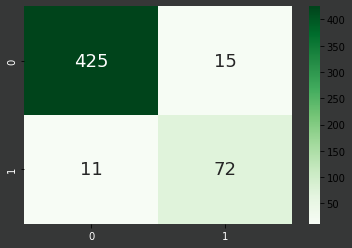

In [ ]:
# Confusion Matrix --best pred thr--
CMft = confusion_matrix(y_valens,y_pred_valens_tALL>=best_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMft, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model, best pred thr--
tn, fp, fn, tp = CMft.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_tALL>=best_thr)
f1 = f1_score(y_valens,y_pred_valens_tALL>=best_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

425
15
11
72
Acc: 0.9502868068833652
f1 score: 0.8470588235294118
(Se,Pr)=(0.87,0.83)


#### Curves PRC and ROC

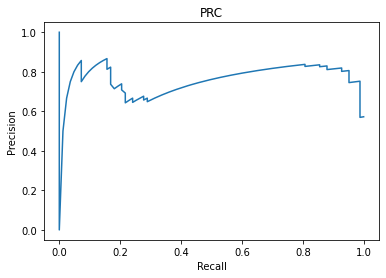

AUPRC TEST-SET : 0.7592


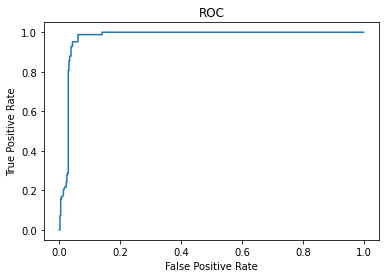

AUROC: 0.9724


In [ ]:
#--ensamble model, best pred thr--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_tALL)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_tALL)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Ensamble combining the 3 archis' outputs weighted by own f1 on val

In [ ]:
selected_thr=0.5
f1val1 = f1_score(y_val,y_pred_val1all>=selected_thr)
f1val2 = f1_score(y_val,y_pred_val2all>=selected_thr)
f1val3 = f1_score(y_val,y_pred_val3all>=selected_thr)
f1val1,f1val2,f1val3

(0.8053333333333332, 0.7544642857142856, 0.6623376623376623)

In [ ]:
#on validation set for ensamble methods
summ=f1val1+f1val2+f1val3
w1=f1val1/summ
w2=f1val2/summ
w3=f1val3/summ
y_pred_fensALL = prediction(FTmatrix_trainALL, w1, w2, w3)
y_pred_fensALL = np.asarray(y_pred_fensALL)[:]

#### Confusion Matrix

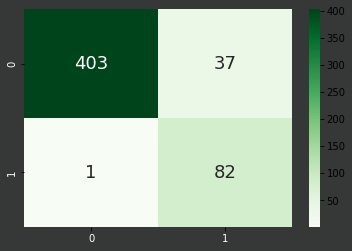

In [ ]:
#--ensamble model weighted on f1score--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_fensALL>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted on f1score--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_fensALL>=selected_thr)
f1 = f1_score(y_valens,y_pred_fensALL>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

403
37
1
82
Acc: 0.9273422562141491
f1 score: 0.8118811881188117
(Se,Pr)=(0.99,0.69)


#### Curves PRC and ROC

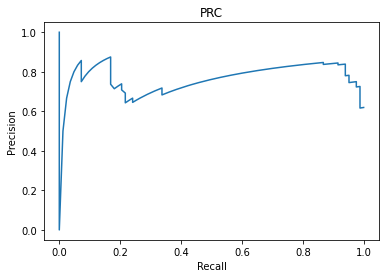

AUPRC TEST-SET : 0.7642


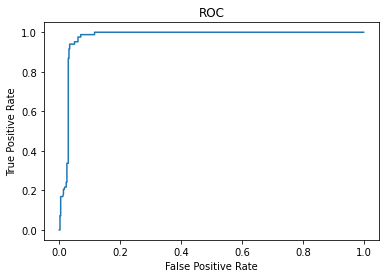

AUROC: 0.9734


In [ ]:
#--ensamble model weighted on f1score--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_fensALL)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_fensALL)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### decision tree and logistic regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score
X_train= FTmatrix_valALL
Y_train= y_val
X_test= FTmatrix_trainALL
Y_test= y_valens

def hyperp_search(classifier, parameters):
    gs = GridSearchCV(classifier, parameters, cv=2, scoring = 'f1', verbose=3)
    gs = gs.fit(X_train, Y_train)
    f1_train = gs.best_score_
    print("f1_train: %f using %s" % (f1_train, gs.best_params_))

    best_model = gs.best_estimator_
    y_tr_pred= best_model.predict(X_train)
    y_pred = best_model.predict(X_test)
    f1_test = f1_score(Y_test, y_pred)
    print("f1_test: ", f1_test)
    
    print(confusion_matrix(Y_test, y_pred))

    print("acc_train: ", accuracy_score(Y_train, y_tr_pred))
    print("acc_test: ", accuracy_score(Y_test, y_pred))
    print("precision_train: ", precision_score(Y_train, y_tr_pred))
    print("precision_test: ", precision_score(Y_test, y_pred))
    print("recall_train: ", recall_score(Y_train, y_tr_pred))
    print("recall_test: ", recall_score(Y_test, y_pred))
    
    return (best_model)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

classifier = DecisionTreeClassifier()
parameters = {'criterion': ['entropy'],'max_depth': [1,2,3,4],'min_samples_split': [3,5],'min_samples_leaf': [3,5]}

best_tree = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 16 candidates, totalling 32 fits
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.966 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.781 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.966 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.711 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.966 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.781 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.966 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.781 total time=   

In [ ]:
from sklearn import tree
r = tree.export_text(best_tree)
print(r) 

|--- feature_1 <= 0.64
|   |--- class: 0
|--- feature_1 >  0.64
|   |--- class: 1



In [ ]:
from sklearn.tree import export_graphviz
export_graphviz(best_tree, out_file='decision_tree.dot', feature_names = ["Archi1","Archi2","Archi3"])

In [ ]:
!dot -Tpng decision_tree.dot -o decision_tree.png -Gdpi=600

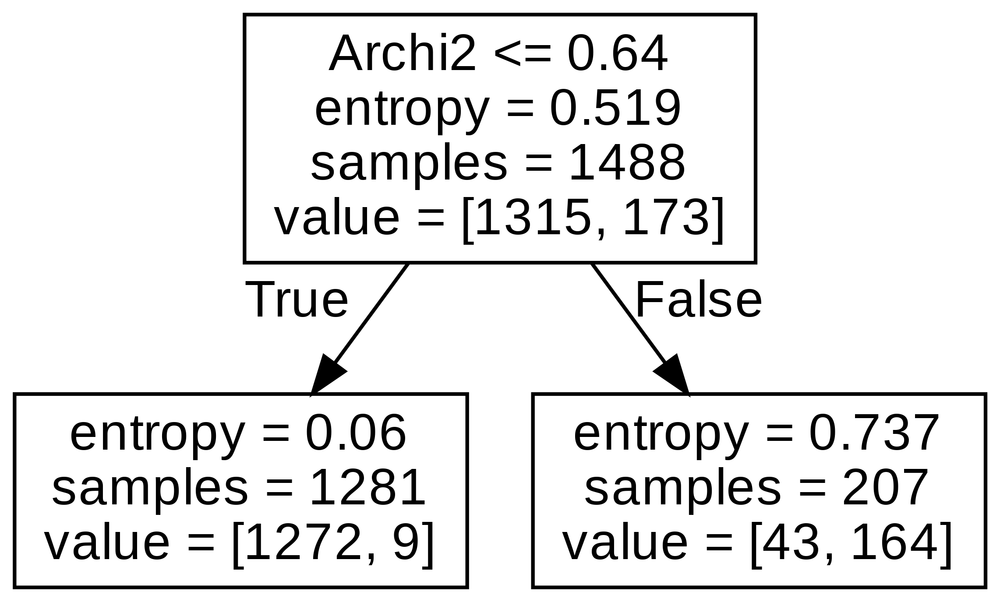

In [ ]:
from IPython.display import Image
Image(filename = 'decision_tree.png')

In [ ]:
from sklearn.linear_model import LogisticRegression

classifier = LogisticRegression()
parameters = {"C":[1e-3,1e-2,1e-1,1,10], "max_iter":[1000,2000], "tol": [1e-4,1e-5]} #C regulates the trade off between generalization (given by the regularization term) and the loss function (minimising the error) so a higher C may cause overfitting

best_logisticReg = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 20 candidates, totalling 40 fits
[CV 1/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END ..C=0.01, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END ..C=0.01, max_iter=1000, tol=1e-05;

In [ ]:
best_logisticReg.coef_

array([[1.76426587, 5.47952755, 3.03867475]])

#### Check differences in what each archi learns

In [ ]:
def pred(y):
    if y>0.5:
        return 1
    else:    
        return 0

In [ ]:
tot_missclass1=0
tot_missclass2=0
tot_missclass3=0
tot_missclass1as2=0
tot_missclass1as3=0
tot_missclass2as3=0
tot_missclass1as2as3=0
tot_missclassU=0

for i in range(len(y_valens)):
    if (pred(y_pred_valens1all[i]) != pred(y_valens[i]) and (pred(y_pred_valens2all[i]) == pred(y_valens[i])) and (pred(y_pred_valens3all[i]) == pred(y_valens[i]))):
        tot_missclass1+=1
    if (pred(y_pred_valens2all[i]) != pred(y_valens[i])and (pred(y_pred_valens1all[i]) == pred(y_valens[i])) and (pred(y_pred_valens3all[i]) == pred(y_valens[i]))):
        tot_missclass2+=1
    if (pred(y_pred_valens3all[i]) != pred(y_valens[i]) and (pred(y_pred_valens1all[i]) == pred(y_valens[i])) and (pred(y_pred_valens2all[i]) == pred(y_valens[i]))):
        tot_missclass3+=1
    if ((pred(y_pred_valens1all[i]) != pred(y_valens[i])) and (pred(y_pred_valens2all[i]) != pred(y_valens[i])) and  (pred(y_pred_valens3all[i]) == pred(y_valens[i]))):
        tot_missclass1as2+=1
    if ((pred(y_pred_valens1all[i]) != pred(y_valens[i])) and (pred(y_pred_valens3all[i]) != pred(y_valens[i])) and  (pred(y_pred_valens2all[i]) == pred(y_valens[i]))):
        tot_missclass1as3+=1
    if ((pred(y_pred_valens2all[i]) != pred(y_valens[i])) and (pred(y_pred_valens3all[i]) != pred(y_valens[i])) and  (pred(y_pred_valens1all[i]) == pred(y_valens[i]))):
        tot_missclass2as3+=1
    if ((pred(y_pred_valens1all[i]) != pred(y_valens[i])) and (pred(y_pred_valens2all[i]) != pred(y_valens[i])) and (pred(y_pred_valens3all[i]) != pred(y_valens[i]))):
        tot_missclass1as2as3+=1
    if ((pred(y_pred_valens1all[i]) != pred(y_valens[i])) ^ (pred(y_pred_valens2all[i]) != pred(y_valens[i])) ^ (pred(y_pred_valens3all[i]) != pred(y_valens[i]))):
        tot_missclassU+=1

print("Considering the valens set: \n")
print(f"Out of {tot_missclass1} missclassifications for only ARCHI1, {tot_missclass1as2} are in common with ARCHI2, which missclassifies (alone) {tot_missclass2} samples")
print(f"and {tot_missclass1as3} are in common with ARCHI3, which missclassifies (alone) {tot_missclass3} samples")  
print(f"The number of common missclassifications for ARCHI2 and ARCHI 3 is {tot_missclass2as3}")
print(f"The number of common missclassifications for all 3 achitectures is {tot_missclass1as2as3}, compared to the {tot_missclassU} samples which are missclassified only by 1 architecture")

Considering the valens set: 

Out of 11 missclassifications for only ARCHI1, 19 are in common with ARCHI2, which missclassifies (alone) 27 samples
and 0 are in common with ARCHI3, which missclassifies (alone) 46 samples
The number of common missclassifications for ARCHI2 and ARCHI 3 is 16
The number of common missclassifications for all 3 achitectures is 18, compared to the 102 samples which are missclassified only by 1 architecture


## Combine archis on all aug x10 TP and x2 FP 
Having noticed during the 2 previous attempts that the ensembles' performances corresponded to the average performance of the single models the worst one of the 3 was dropped; and we can notice this increased the overall performance considerably

In [ ]:
model_archi1_article = build_archi1_gmp(archi1_input_shape)
model_archi2_article = build_archi2_gmp(archi2_input_shape)

#ar1: 0.85 f1 val
model_archi1_article.load_weights("/content/gdrive/MyDrive/neuroengineering/project/StudentsFolder/model_seba_neuro/EnsembleModels/Archi1_Albumentation_sbilanciato_Dec07_01-21-03/ckpts/cp.ckpt")
#ar2 : 0.89 f1 val
model_archi2_article.load_weights("/content/gdrive/MyDrive/neuroengineering/project/StudentsFolder/model_seba_neuro/EnsembleModels/Archi2_Albumentation_Bilanciato_TP9_FP1_Dec07_02-40-49/ckpts/cp.ckpt")
#ar 3: f1 val
model_archi3_article.load_weights("/content/gdrive/MyDrive/neuroengineering/project/StudentsFolder/Vittoria/Archi3_all9.1_Dec12_10-51-53-20211212T160925Z-001.zip (Unzipped Files)/Archi3_all9.1_Dec12_10-51-53/ckpts/cp.ckpt")

In [ ]:
y_pred_valens12 = model_archi1_article.predict(valens_images_AR1)
y_pred_valens12 = np.asarray(y_pred_valens12)[:,0]
y_pred_valens22 = model_archi2_article.predict(valens_images_AR2)
y_pred_valens22 = np.asarray(y_pred_valens22)[:,0]
y_pred_valens32 = model_archi3_article.predict(valens_images_AR3)
y_pred_valens32 = np.asarray(y_pred_valens32)[:,0]

In [ ]:
y_pred_val12 = model_archi1_article.predict(val_images_AR1)
y_pred_val12 = np.asarray(y_pred_val12)[:,0]
y_pred_val22 = model_archi2_article.predict(val_images_AR2)
y_pred_val22 = np.asarray(y_pred_val22)[:,0]
y_pred_val32 = model_archi3_article.predict(val_images_AR3)
y_pred_val32 = np.asarray(y_pred_val32)[:,0]

In [ ]:
#CREATE A MATRIX WITH THE PREDICTED PROBABILITIES TO BE COMBINED #evaluate model of valens set
FTmatrix_train2  = np.concatenate((y_pred_valens12.reshape(-1,1),y_pred_valens22.reshape(-1,1)),axis=1) #valens set used for validation
FTmatrix_train2.shape
FTmatrix_train3  = np.concatenate((y_pred_valens12.reshape(-1,1),y_pred_valens22.reshape(-1,1),y_pred_valens32.reshape(-1,1)),axis=1) #valens set used for validation
FTmatrix_train3.shape

(523, 3)

In [ ]:
#define the grid of weights to be investigated
values_grid = np.arange(0.01, 0.99, 0.01);

def prediction2 (matrix, a, b):
  lista =[]
  for i in range (matrix.shape[0]):
    h = a*matrix[i][0] + b*matrix[i][1]  #try different thr for predicting pos for each archi (optimize)
    lista.append(h)
  return lista

### **BEST MODEL: CANDIDATE FOR TESTING ON NEW DATA**
### **Gridsearch of best weights for each architecture**
Notice that in accordance with the other ensembles following, greater importance is assigned to the better performing archi 2


In [ ]:
# FOR LOOP TO SEARCH THE BEST COMBINATION OF WEIGHTS 
FTmatrix_val2= np.concatenate((y_pred_val12.reshape(-1,1),y_pred_val22.reshape(-1,1)),axis=1) #use validation set for training
best = [0, 0]
area_max = 0
#f1_max=0
for a in values_grid:
  for b in values_grid:
    if(a+b == 1):
        y_pred = prediction2 (FTmatrix_val2, a, b);
        y_pred = np.asarray(y_pred)
        prec, rec, thr_auprc=precision_recall_curve(y_val,y_pred)
        fpr, tpr, thr_auc=roc_curve(y_val,y_pred)
        auprc = auc(rec,prec)
        auroc = auc(fpr,tpr)
        f1val = f1_score(y_val,y_pred>=0.5)
        #if(f1val > f1_max): 
        #    f1_max = f1val
        if(auprc > area_max): #all alternatives were tryed and this is the best: more robust (same as with roc in this case since balanced dataset)
            area_max = auprc
        #if(auroc > area_max): 
        #    area_max = auroc
            best[0] = a
            best[1] = b

print(best)

[0.21000000000000002, 0.79]


In [ ]:
# derive the  weighted predicted probabilities
#evaluate performances on valens set
y_pred_multibranch_valens2 = prediction2(FTmatrix_train2, best[0], best[1])
y_pred_multibranch_valens2 = np.asarray(y_pred_multibranch_valens2)[:]

#### **Confusion Matrix**

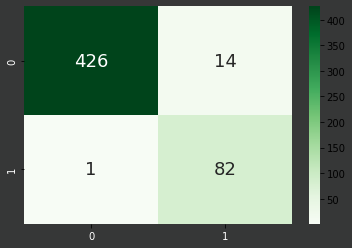

In [ ]:
#--ensamble model weighted gridsearch--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_multibranch_valens2>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### **sensitivity, precision, accuracy, f1 score**


In [ ]:
#--ensamble model weighted gridsearch--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_multibranch_valens2>=selected_thr)
f1 = f1_score(y_valens,y_pred_multibranch_valens2>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
1
82
Acc: 0.97131931166348
f1 score: 0.9162011173184358
(Se,Pr)=(0.99,0.85)


#### **Curves PRC and ROC**

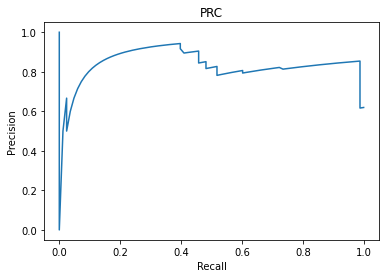

AUPRC TEST-SET : 0.8286


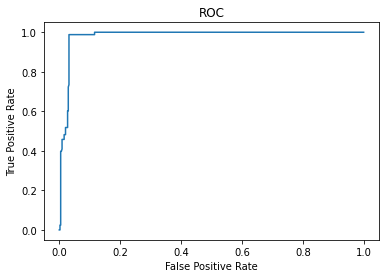

AUROC: 0.9809


In [ ]:
#--ensamble model weighted gridsearch--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_multibranch_valens2)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_multibranch_valens2)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Gridsearch of best weights for each architecture (use all 3 here)
and maximize f1 score since the best ensembles are the previous one and the one computing the weights based on f1 score in val set so here we combine both concepts.
But performance worsens: this proves that using only the 2 best models is what truly allows to obtain better results 

In [ ]:
# FOR LOOP TO SEARCH THE BEST COMBINATION OF WEIGHTS 
FTmatrix_val3= np.concatenate((y_pred_val12.reshape(-1,1),y_pred_val22.reshape(-1,1),y_pred_val32.reshape(-1,1)),axis=1) #use validation set for training
best = [0, 0,0]
f1_max = 0
for a in values_grid:
  for b in values_grid:
    for c in values_grid:
      if(a+b+c == 1):
        y_pred = prediction(FTmatrix_val3, a, b,c);
        y_pred = np.asarray(y_pred)
        f1val = f1_score(y_val,y_pred>=0.5)
        if(f1val > f1_max): 
          f1_max = f1val
          best[0] = a
          best[1] = b
          best[2] = c


print(best)

[0.01, 0.9600000000000001, 0.03]


In [ ]:
# derive the  weighted predicted probabilities
#evaluate performances on valens set
y_pred_multibranch_valens3 = prediction(FTmatrix_train3, best[0], best[1], best[2])
y_pred_multibranch_valens3 = np.asarray(y_pred_multibranch_valens3)[:]

#### Confusion Matrix

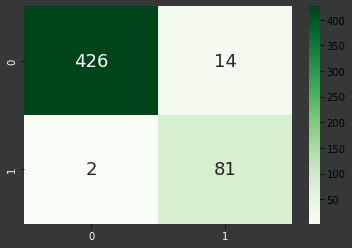

In [ ]:
#--ensamble model weighted gridsearch--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_multibranch_valens3>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted gridsearch--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_multibranch_valens3>=selected_thr)
f1 = f1_score(y_valens,y_pred_multibranch_valens3>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
2
81
Acc: 0.9694072657743786
f1 score: 0.9101123595505617
(Se,Pr)=(0.98,0.85)


#### Curves PRC and ROC

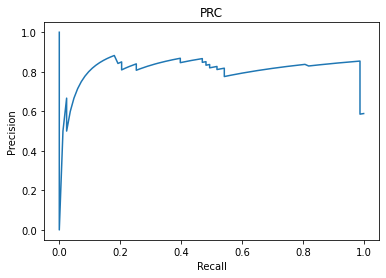

AUPRC TEST-SET : 0.8094


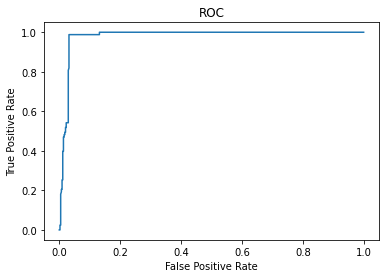

AUROC: 0.9794


In [ ]:
#--ensamble model weighted gridsearch--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_multibranch_valens3)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_multibranch_valens3)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Combine optimizing prediction threshold 

In [ ]:
 f1_max = 0
for thr in values_grid:
    y_pred = prediction2(FTmatrix_val2, 1./3, 1./3)
    y_pred = np.asarray(y_pred)
    f1val = f1_score(y_val,y_pred>=thr)
    if(f1val > f1_max):
        f1_max = f1val
        best_thr=thr

print(best_thr)

0.36000000000000004


In [ ]:
y_pred_valens_t2 = prediction2(FTmatrix_train2, 1./3, 1./3)
y_pred_valens_t2 = np.asarray(y_pred_valens_t2)[:]

#### Confusion Matrix

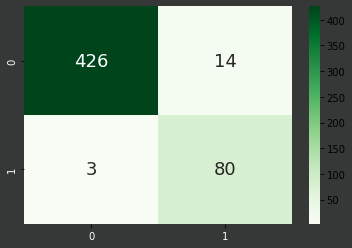

In [ ]:
# Confusion Matrix --best pred thr--
CMft = confusion_matrix(y_valens,y_pred_valens_t2>=best_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMft, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model, best pred thr--
tn, fp, fn, tp = CMft.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_t2>=best_thr)
f1 = f1_score(y_valens,y_pred_valens_t2>=best_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
3
80
Acc: 0.9674952198852772
f1 score: 0.903954802259887
(Se,Pr)=(0.96,0.85)


#### Curves PRC and ROC

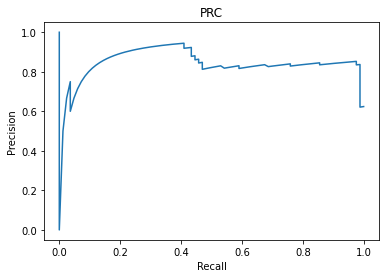

AUPRC TEST-SET : 0.8369


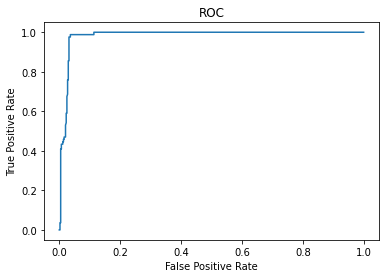

AUROC: 0.9821


In [ ]:
#--ensamble model, best pred thr--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_t2)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_t2)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### Ensamble combining the 2 archis' outputs weighted by own f1 on val

In [ ]:
selected_thr=0.5
f1val1 = f1_score(y_val,y_pred_val12>=selected_thr)
f1val2 = f1_score(y_val,y_pred_val22>=selected_thr)

f1val1,f1val2

(0.8601036269430052, 0.8983050847457626)

In [ ]:
#on validation set for ensamble methods
summ=f1val1+f1val2
w1=f1val1/summ
w2=f1val2/summ

y_pred_fens2 = prediction2(FTmatrix_train2, w1, w2)
y_pred_fens2 = np.asarray(y_pred_fens2)[:]

#### Confusion Matrix

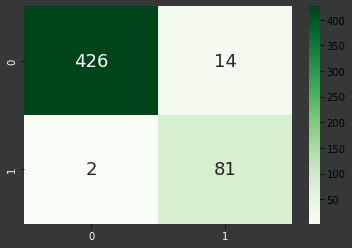

In [ ]:
#--ensamble model weighted on f1score--
selected_thr = 0.5
# Confusion Matrix
CMfens = confusion_matrix(y_valens,y_pred_fens2>=selected_thr) #y_valens or valens_labels(1 hot)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMfens, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--ensamble model weighted on f1score--
tn, fp, fn, tp = CMfens.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_fens2>=selected_thr)
f1 = f1_score(y_valens,y_pred_fens2>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

426
14
2
81
Acc: 0.9694072657743786
f1 score: 0.9101123595505617
(Se,Pr)=(0.98,0.85)


#### Curves PRC and ROC

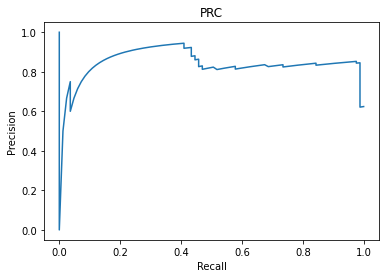

AUPRC TEST-SET : 0.8359


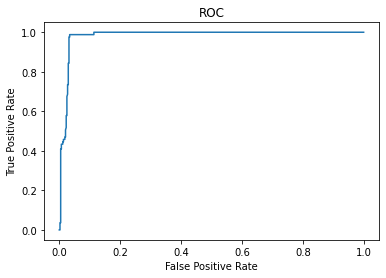

AUROC: 0.9819


In [ ]:
#--ensamble model weighted on f1score--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_fens2)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_fens2)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

### decision tree and logistic regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score
X_train= FTmatrix_val2
Y_train= y_val
X_test= FTmatrix_train2
Y_test= y_valens

def hyperp_search(classifier, parameters):
    gs = GridSearchCV(classifier, parameters, cv=2, scoring = 'f1', verbose=3)
    gs = gs.fit(X_train, Y_train)
    f1_train = gs.best_score_
    print("f1_train: %f using %s" % (f1_train, gs.best_params_))

    best_model = gs.best_estimator_
    y_tr_pred= best_model.predict(X_train)
    y_pred = best_model.predict(X_test)
    f1_test = f1_score(Y_test, y_pred)
    print("f1_test: ", f1_test)
    
    print(confusion_matrix(Y_test, y_pred))

    print("acc_train: ", accuracy_score(Y_train, y_tr_pred))
    print("acc_test: ", accuracy_score(Y_test, y_pred))
    print("precision_train: ", precision_score(Y_train, y_tr_pred))
    print("precision_test: ", precision_score(Y_test, y_pred))
    print("recall_train: ", recall_score(Y_train, y_tr_pred))
    print("recall_test: ", recall_score(Y_test, y_pred))
    
    return (best_model)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

classifier = DecisionTreeClassifier()
parameters = {'criterion': ['entropy'],'max_depth': [1,2,3,4],'min_samples_split': [3,5],'min_samples_leaf': [3,5]}

best_tree = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 16 candidates, totalling 32 fits
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.939 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3;, score=0.811 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.939 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=5;, score=0.811 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.939 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3;, score=0.811 total time=   0.0s
[CV 1/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.939 total time=   0.0s
[CV 2/2] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=5;, score=0.811 total time=   

In [ ]:
from sklearn import tree
r = tree.export_text(best_tree)
print(r) 

|--- feature_1 <= 0.50
|   |--- feature_0 <= 0.50
|   |   |--- feature_1 <= 0.12
|   |   |   |--- class: 0
|   |   |--- feature_1 >  0.12
|   |   |   |--- class: 0
|   |--- feature_0 >  0.50
|   |   |--- feature_1 <= 0.09
|   |   |   |--- class: 1
|   |   |--- feature_1 >  0.09
|   |   |   |--- class: 0
|--- feature_1 >  0.50
|   |--- feature_1 <= 0.77
|   |   |--- feature_0 <= 0.99
|   |   |   |--- class: 1
|   |   |--- feature_0 >  0.99
|   |   |   |--- class: 0
|   |--- feature_1 >  0.77
|   |   |--- feature_0 <= 0.98
|   |   |   |--- class: 1
|   |   |--- feature_0 >  0.98
|   |   |   |--- class: 1



In [ ]:
#install graphviz https://graphviz.gitlab.io/download/

import sys
!conda install --yes --prefix {sys.prefix} graphviz
!{sys.executable} -m pip install graphviz

/bin/bash: conda: command not found


In [ ]:
from sklearn.tree import export_graphviz
export_graphviz(best_tree, out_file='decision_tree.dot', feature_names = ["Archi1","Archi2"])

In [ ]:
!dot -Tpng decision_tree.dot -o decision_tree.png -Gdpi=600

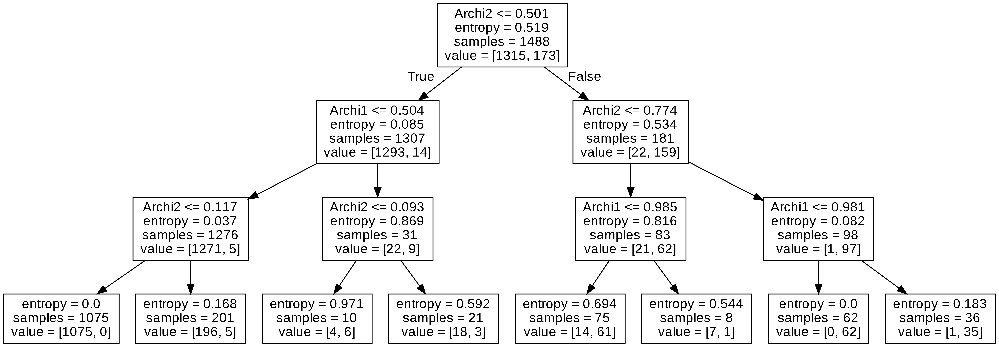

In [ ]:
from IPython.display import Image
Image(filename = 'decision_tree.png')

In [ ]:
from sklearn.linear_model import LogisticRegression

classifier = LogisticRegression()
parameters = {"C":[1e-3,1e-2,1e-1,1,10], "max_iter":[1000,2000], "tol": [1e-4,1e-5]} #C regulates the trade off between generalization (given by the regularization term) and the loss function (minimising the error) so a higher C may cause overfitting

best_logisticReg = hyperp_search(classifier,parameters)

Fitting 2 folds for each of 20 candidates, totalling 40 fits
[CV 1/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END C=0.001, max_iter=2000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.001, max_iter=2000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 1/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 2/2] END .C=0.01, max_iter=1000, tol=0.0001;, score=0.000 total time=   0.0s
[CV 1/2] END ..C=0.01, max_iter=1000, tol=1e-05;, score=0.000 total time=   0.0s
[CV 2/2] END ..C=0.01, max_iter=1000, tol=1e-05;

In [ ]:
best_logisticReg.coef_

array([[3.34153865, 6.56247829]])

## MobileNet (only 2 slices around the central one) transfer learning and fine tuning (combined)


In [ ]:
#done to prove the 3D approach (using more slices) performs better 
#even if it does not alloe to use techniques such as transfer learning and fine tuning since there are no available models in literature
def imageLoader_3ch(files, idx_samples,target, batch_size):
    L = len(idx_samples)
    #random.shuffle(idx_samples)
    
    print(idx_samples.shape)
    idx_samples = K.print_tensor(idx_samples)
    np.random.shuffle(idx_samples)
     
    while True:
        batch_start = 0
        batch_end = batch_size

        while batch_end <= L:
            limit = min(batch_end, L)

            # we have to allocate in advance the space for the input batch
            tmpB = np.empty((limit-batch_start,3,40,40)) #<------------------------------------------------------------------ARCHI 3 SHAPE
            tmpB_Y = np.empty((limit-batch_start,2))
            
            idx =-1
            for i in range(batch_start,limit):
                idx=idx+1
                # Ranges has to be updated according to the input size we are dealing with
                # Limitation: only the center is considered, what if nodule at border

                img_0 =  np.expand_dims(files.root.images[idx_samples[i,0],12:15,:,:],axis=0) #<----------------------------------ARCHI 3 CENTER
                
                # image processing
                img_0 = normalize(img_0)
                # from the value in the second column verify which transformation apply 
                angle = idx_samples[i,1]
                if angle == 1:
                    img = np.flip(img_0,axis=3) # horizontal FLIP 
                elif angle ==2:
                    img = np.flip(img_0,axis=2) # vertical FLIP 
                elif angle >2 :
                    img = ndimage.rotate(img_0,angle,reshape=False,mode='constant',axes = (2,3))
                elif angle == 0: # original image is considered
                    img = img_0
                # fill the allocated vector with the tranformed image
                tmpB[idx,:,:,:] =img

                tmpB_Y[idx,:] = target[idx_samples[i,0],:]

            X = np.expand_dims(tmpB,axis=-1)
            Y = tmpB_Y           
            
            #SINGLE INPUT- SINGLE OUTPUT
            yield (X,Y) #a tuple with two numpy arrays with batch_size samples     
            
            batch_start += batch_size   
            batch_end += batch_size

In [ ]:
img_0 =  np.expand_dims(h5file.root.images[0,13,:,:],axis=0)
img_0.shape
img_0=np.reshape(img_0, (40,40))
img_0.shape

(40, 40)

In [ ]:
from keras import models
from keras import layers
input_shape=(3,40,40)

def build_model (input_shape):
    keras.backend.set_image_data_format('channels_first')
    input_layer = layers.Input(shape=input_shape)

    
    rescaleL=layers.Rescaling(scale=2., offset=-1)(input_layer) #input values between -1 and 1

    main=keras.applications.mobilenet.MobileNet(
    input_shape=input_shape,alpha=1.0, depth_multiplier=1, dropout=0.4,
    include_top=False, weights='imagenet', pooling="max" #the use of imagenet weights for FP reduction in lung nodules detection was found in literature but only for a 2D approach, here 3 different slices are used instead of replicating only one
    )(rescaleL)
    main.trainable=False
    classifier=layers.Dropout(0.4, seed=seed)(main)
    classifier=layers.Dense(units=240, kernel_initializer=keras.initializers.GlorotUniform(seed), activation='relu')(classifier) 
    classifier=layers.Dropout(0.4, seed=seed)(classifier)
    output_layer=layers.Dense(units=2, activation='softmax', kernel_initializer=keras.initializers.GlorotUniform(seed))(classifier)
    model = keras.Model(inputs=input_layer, outputs=output_layer, name= my_model_name)
    model.compile(loss=custom_crossentropy(bce), optimizer=adam, metrics=['acc',recall,precision,f1score])
    return model
model=build_model(input_shape)

In [ ]:
model.summary()

Model: "multimodal_conv"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_35 (InputLayer)       [(None, 3, 40, 40)]       0         
                                                                 
 rescaling_6 (Rescaling)     (None, 3, 40, 40)         0         
                                                                 
 mobilenet_1.00_224 (Functio  (None, 1024)             3228864   
 nal)                                                            
                                                                 
 dropout_29 (Dropout)        (None, 1024)              0         
                                                                 
 dense_4 (Dense)             (None, 240)               246000    
                                                                 
 dropout_30 (Dropout)        (None, 240)               0         
                                                   

In [ ]:
training_generator3ch = imageLoader_3ch(h5file, idx_angles_training, y, batch_size)

In [ ]:
valens_images_ch3_new=[]
valens_images_ch3 =  np.expand_dims(h5file.root.images[list(idx_valens),12:15,:,:],axis=-1) 
valens_images_ch3 = normalize(valens_images_ch3)  
   
print(np.shape(valens_images_ch3))

/usr/local/lib/python3.7/dist-packages/tables/leaf.py:548: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  key = numpy.array(key)


(523, 3, 40, 40, 1)


Epoch 1/50
76/76 [==============================] - 75s 958ms/step - loss: 1.3757 - acc: 0.5995 - recall: 0.4937 - precision: 0.5364 - f1score: 0.5061 - val_loss: 0.6713 - val_acc: 0.6042 - val_recall: 0.3511 - val_precision: 0.1799 - val_f1score: 0.2193 - lr: 1.0000e-05
Epoch 2/50
76/76 [==============================] - 35s 465ms/step - loss: 0.8356 - acc: 0.7191 - recall: 0.6584 - precision: 0.6847 - f1score: 0.6669 - val_loss: 0.6483 - val_acc: 0.6195 - val_recall: 0.4481 - val_precision: 0.1914 - val_f1score: 0.2539 - lr: 1.0000e-05
Epoch 3/50
76/76 [==============================] - 35s 470ms/step - loss: 0.6473 - acc: 0.7751 - recall: 0.7300 - precision: 0.7463 - f1score: 0.7351 - val_loss: 0.6288 - val_acc: 0.6558 - val_recall: 0.5108 - val_precision: 0.2533 - val_f1score: 0.3140 - lr: 1.0000e-05
Epoch 4/50
76/76 [==============================] - 16s 216ms/step - loss: 0.5277 - acc: 0.8062 - recall: 0.7661 - precision: 0.7843 - f1score: 0.7719 - val_loss: 0.6693 - val_acc: 0.6

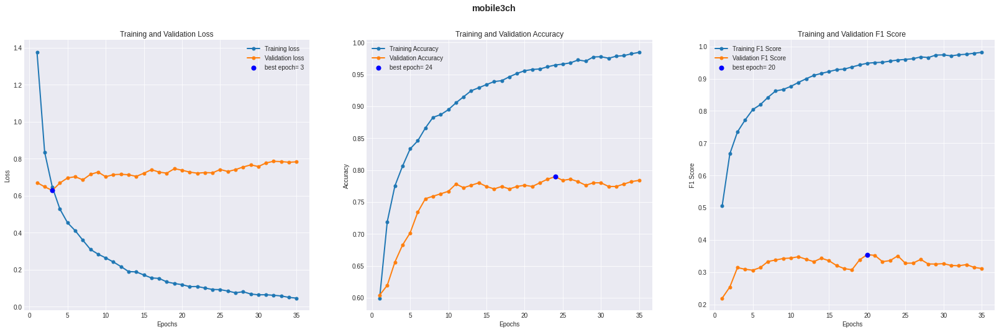

In [ ]:
my_model_name='mobile3ch'
(my_callbacks, exp_dir) = create_folders_and_callbacks(model_name=my_model_name)
historym = model.fit( x=training_generator3ch,   
          validation_data = (valens_images_ch3,valens_labels), 
          epochs = epochs, steps_per_epoch = steps,
          callbacks=my_callbacks
          )

#Plot
resume_plot(historym, exp_dir, my_model_name)
#Animation
animated_plot(historym, repeat_animation=False)

In [ ]:
#similarly to resnet the main issue was  overfitting, perhaps a finer tuning after training on the Luna 16 dataset might help
model.save(os.path.join(exps_dir, str('best_model/' +  my_model_name)))

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/mobile3ch/assets


In [ ]:
#model=keras.models.load_model("/content/gdrive/MyDrive/StudentsFolder/model_seba_neuro/EnsembleModels/best_model/mobile3ch", custom_objects={"f1score":f1score,"recall":recall,"precision":precision}, compile=True, options=None)

### Prediction on valens dataset

In [ ]:
y_pred_valens_m = model.predict(valens_images_ch3)
y_pred_valens_m = np.asarray(y_pred_valens_multi_c)

#### Confusion Matrix

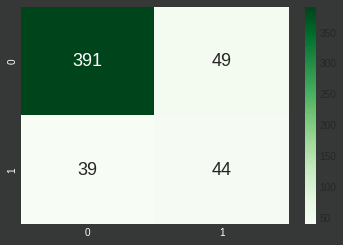

In [ ]:
#--Multimodal model--
selected_thr = 0.5
# Confusion Matrix
CMm = confusion_matrix(y_valens,y_pred_valens_m>=selected_thr)
fig = plt.figure()
fig.set_facecolor('xkcd:dark grey')
ax = sn.heatmap(CMm, annot=True, annot_kws={"size": 18}, fmt='g', cmap=plt.cm.Greens) # font size
plt.xticks(color='white')
plt.yticks(color = 'white')
plt.show()
#fig.savefig(os.path.join(graph, '/confusion_matrix.png'), facecolor=fig.get_facecolor() )

#### sensitivity, precision, accuracy, f1 score


In [ ]:
#--multimodal model--
tn, fp, fn, tp = CMm.ravel()
print(tn)
print(fp)
print(fn)
print(tp)
Se = round(tp/(tp+fn),2)
Pr = round(tp/(tp+fp),2)
acc = accuracy_score(y_valens,y_pred_valens_m>=selected_thr)
f1 = f1_score(y_valens,y_pred_valens_m>=selected_thr)
print(f'Acc: {acc}')
print(f'f1 score: {f1}')
print("(Se,Pr)=("+str(Se)+","+str(Pr)+")")

391
49
39
44
Acc: 0.8317399617590823
f1 score: 0.5000000000000001
(Se,Pr)=(0.53,0.47)


## **Curves PRC and ROC**

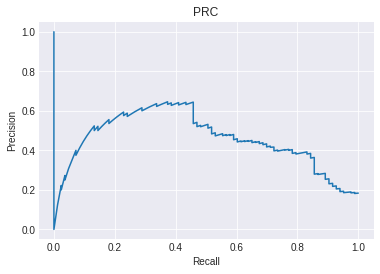

AUPRC TEST-SET : 0.4483


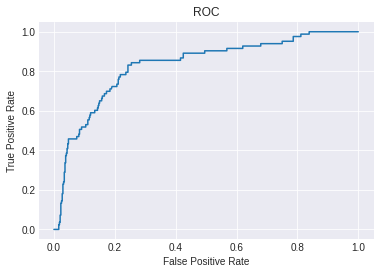

AUROC: 0.8288


In [ ]:
#--multimodal model--
# Compute PRC
prec, rec, thr_auprc=precision_recall_curve(y_valens,y_pred_valens_m)
fig, ax = plt.subplots()
plt.plot(rec,prec)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PRC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'PRC_NO_RES'))
print("AUPRC TEST-SET : "+str(round(auc(rec,prec),4)))

# Compute ROC
fpr, tpr, thr_auc=roc_curve(y_valens,y_pred_valens_m)
fig, ax = plt.subplots()
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()
#fig.savefig(os.path.join(FOLDER, 'AUROC_NO_RES'))
print('AUROC: '+ str(round(auc(fpr,tpr),4)))

# **Best model**
The best performing model that is selected to be tested on new data is the ensemble obtained by gridsearching the best weights to be assigned to archi 1 and 2 's predictions when linearly combined in order to obtain the best aupr, with archi 1 and 2 trained on advanced augmentation 9-1

# **Future developments**
* Pretrain the networks on the more abundant LUNA16 dataset and then apply transfer learning or fine tuning using the given dataset
* A limitations of the centerwise cropping of the original image approach is that if the lesion is not at the ROI's center but at a border it is getting at least partially excluded from the input which will be fed to each network; so if the information regarding the probable center of the lesion is not made available by the ROI proposal phase of lung nodule detection, a possible solution could be that of cropping the original image more times, with different centers and feeding them to the network, and then taking
as prediction the one given with the most confidence (greatest difference among the probabilities assigned to each class) and with most aggreement among adjacient regions of the original image